# Imports

In [1]:
%load_ext autoreload
%autoreload 2

%matplotlib inline
%config InlineBackend.figure_formats = ['svg']
#import matplotlib as mpl
#mpl.rcParams['figure.dpi']= 300
import matplotlib.pyplot as plt
# %run ../PyModules/exporter.py
%run PyModules/exporter.py

import numpy as np

# von mir
from scipy.optimize import curve_fit
from joblib import Parallel, delayed
from conveniant_functions import *

import sys
sys.path.insert(0, './../')

from PyModules.utilities import do_async, integer_hill_climb, wait
import time
    
import datetime

from PyModules.paula_viewer import PAULA_V
# paula = PAULA_V(results_path='/Volumes/p-home/Results/tiamo4.sync', cache_path='./data/', 
#                 log_file='./data/log_p.txt', 
#                 log_file_org='/Volumes/p-home/Software/EIOS.git/Notebooks/data/log.txt', dark=False)

paula = PAULA_V(results_path='afp://qsim@qsim-paula.local/p-home/Results/tiamo4.sync', cache_path='/home/robboss/Documents/FilesForPython/data/', 
                log_file='/home/robboss/Documents/FilesForPython/data/log_p.txt', 
                log_file_org='/home/robboss/Documents/FilesForPython/data/log.txt', dark=False)

paula.copy_latest_log_file()

print('Last Updated On: ', datetime.datetime.now())

-------------------------------------
Get latest log file... please wait...
File not updated - Version: 2020-06-04 17:48:48
-------------------------------------
Last Updated On:  2020-08-17 11:33:11.863443


In [2]:
paula.copy_latest_log_file()

-------------------------------------
Get latest log file... please wait...
File not updated - Version: 2020-06-04 17:48:48
-------------------------------------


In [3]:
#paula.get_wvm_status()

In [4]:
paula

# Check e-lab notes 

In [3]:
name_l = paula.get_run_list(paula.log_file, '2020-04-30 17:', script='1')

Found the follwoing runs:
2020-04-30 17:00:20 run remote fr_exc 17_00_05_30_04_2020.dat
2020-04-30 17:00:49 run remote fr_shift_sq_mf 17_00_30_30_04_2020.dat
2020-04-30 17:01:13 run remote phs_tckl 17_00_50_30_04_2020.dat
2020-04-30 17:01:49 run remote fr_exc 17_01_34_30_04_2020.dat
2020-04-30 17:08:06 run remote fr_exc 17_07_52_30_04_2020.dat
2020-04-30 17:08:58 run remote fr_exc 17_08_44_30_04_2020.dat
2020-04-30 17:10:23 run PDQ_LF_FScan fr_tickle_s 17_10_17_30_04_2020.dat
2020-04-30 17:10:31 run PDQ_MF_FScan fr_tickle_s 17_10_25_30_04_2020.dat
2020-04-30 17:10:38 run PDQ_HF_FScan fr_tickle_s 17_10_32_30_04_2020.dat
2020-04-30 17:11:14 run remote fr_exc 17_11_00_30_04_2020.dat
2020-04-30 17:11:33 run remote fr_shift_sq_mf 17_11_15_30_04_2020.dat
2020-04-30 17:11:58 run remote phs_tckl 17_11_34_30_04_2020.dat
2020-04-30 17:12:47 run remote fr_exc 17_12_33_30_04_2020.dat
2020-04-30 17:13:23 run remote fr_exc 17_13_08_30_04_2020.dat
2020-04-30 17:14:27 run remote fr_exc 17_14_13_30_04_

In [6]:
#%%export Labbook
session_l = paula.get_session_list(paula.log_file, '2020-04-30 16:')

Found the follwoing sessions:
2020-04-30-16-23-57 - Check ion position: update? True
2020-04-30-16-24-16 - Optimize BD
2020-04-30-16-24-31 - MW transitions 0
2020-04-30-16-24-59 - Mode frequency
2020-04-30-16-26-01 - Mode frequency
2020-04-30-16-37-06 - Check ion position: update? True
2020-04-30-16-37-27 - Optimize BD
2020-04-30-16-37-42 - MW transitions 0
2020-04-30-16-38-06 - Mode frequency
2020-04-30-16-39-05 - Mode frequency
2020-04-30-16-39-34 - Check ion position: update? True
2020-04-30-16-39-55 - Optimize BD
2020-04-30-16-40-15 - MW transitions 0
2020-04-30-16-40-50 - Mode frequency
2020-04-30-16-41-19 - Mode frequency
2020-04-30-16-59-36 - Mode frequency


In [5]:
ret = []
for session in session_l:
    ret.append(paula.session_replay(session, ips_l=[], show_details=False));

----------------------------------
Loading lab notes from: 2020-04-30-16-23-57
Check ion position: update? True
2020-06-08 11:55:43.062038
Please wait...
---------------------------------- 

+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


FileNotFoundError: [Errno 2] No such file or directory: 'afp://qsim@qsim-paula.local/p-home/Results/tiamo4.sync/2020/04_April/30/ML_wvf_sw_RF/EU_Ex/16_23_58_30_04_2020.dat'

# Check ion prop history

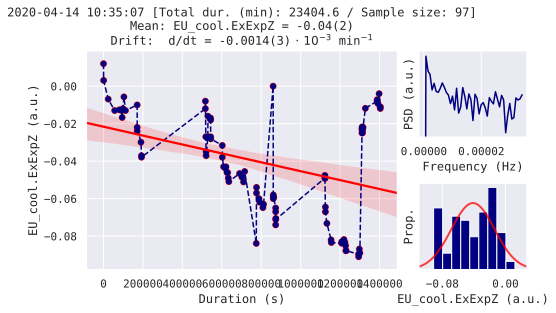

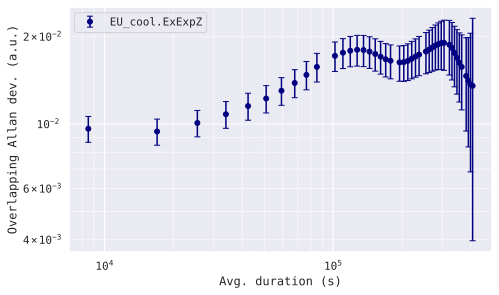

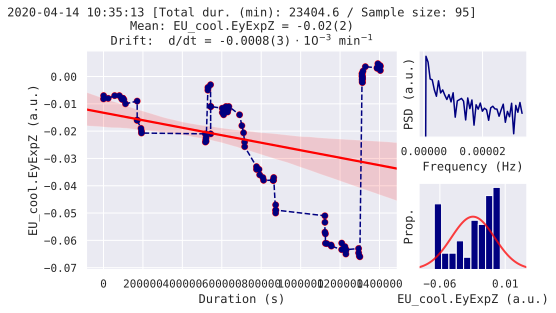

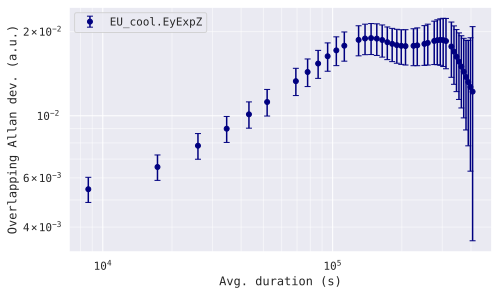

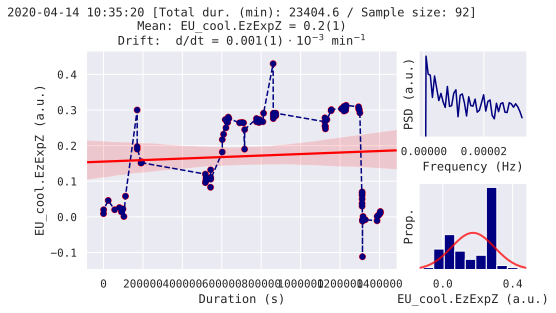

...

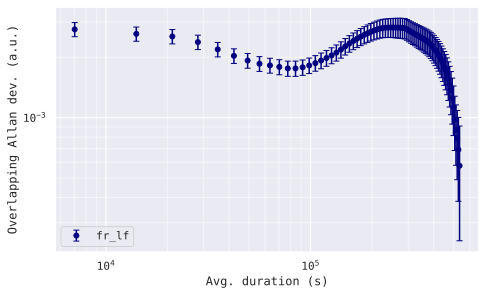

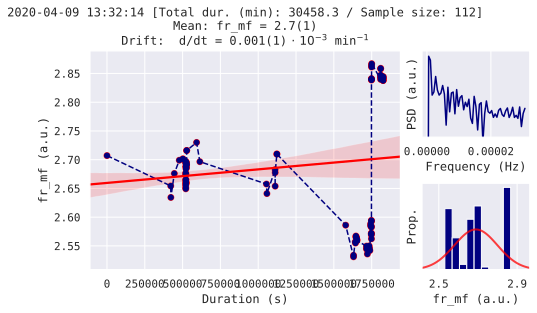

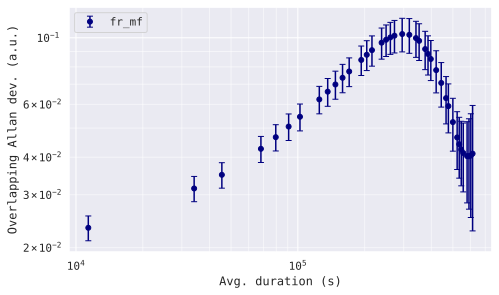

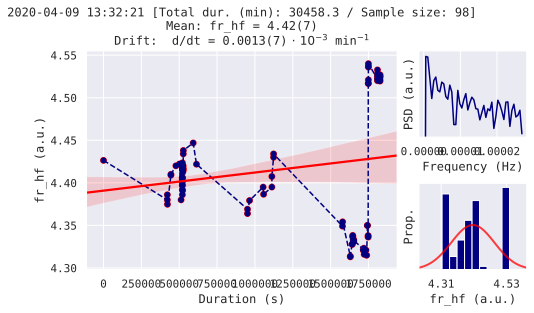

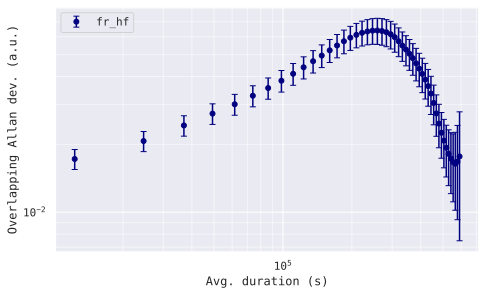

In [12]:
rng=['2020-04-09 13:16:00', '2020-04-30 23:59:59']
ret = paula.plt_longterm(ip_l=['EU_cool.ExExpZ','EU_cool.EyExpZ','EU_cool.EzExpZ', 'fr_lf', 'fr_mf', 'fr_hf'], rng=rng, verbose=True, rel=0);

In [29]:
rng=['2020-04-15 13:16:00', '2020-04-17 23:59:59']
#ret = paula.plt_longterm(ip_l=['fr_lf','fr_mf','fr_hf'], rng=rng, verbose=True, rel=1);

In [28]:
rng=['2020-02-01 10:16:00', '2020-04-15 23:59:59']
#ret = paula.plt_longterm(ip_l=['fr_mw_3p3_2p2', 'fr_mw_3p1_2p2', 'fr_lf', 'fr_mf', 'fr_hf'], rng=rng, verbose=True, rel=1);

# View raw data

In [7]:
fnames = paula.get_run_list(paula.log_file, '2020-04-30 17:08', script='')

Found the follwoing runs:
2020-04-30 17:08:06 run remote fr_exc 17_07_52_30_04_2020.dat
2020-04-30 17:08:58 run remote fr_exc 17_08_44_30_04_2020.dat


Files:  ['/Volumes/p-home/Results/tiamo4.sync/2020/04_April/30/Basic_Experiments/remote/17_07_52_30_04_2020.dat', '/Volumes/p-home/Results/tiamo4.sync/2020/04_April/30/Basic_Experiments/remote/17_08_44_30_04_2020.dat']


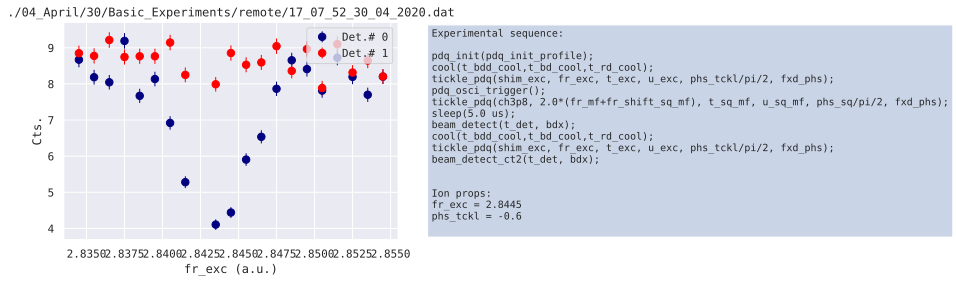

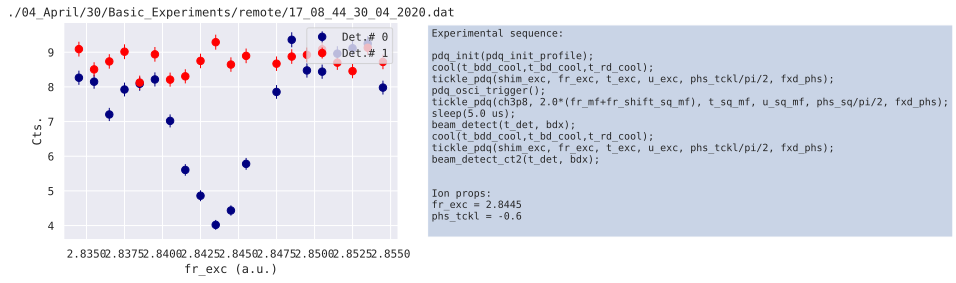

In [8]:
name_l, data_l, script_l, ips_l=paula.show_data(fnames, ips=['fr_exc','phs_tckl'])

# Sanbox

# 2020-02-27 Record data for reconstruction of Wigner fcts. (LF mode)

[Leibfried, D. et al. Experimental Determination of the Motional Quantum State of a Trapped Atom. Phys. Rev. Lett. 77, 4281–4285 (1996)]

In [2]:
from PyModules.analyse_eios import eios_sb
from qutip import *
from joblib import Parallel, delayed
import os
import lhsmdu as lhs

## Ulrichs Messung

In [28]:
#Get Wigner results Displ state
t1 = time.time()

fnames=[  
    '/2020/02_Februar/27/Basic_Experiments/remote/15_47_21_27_02_2020.dat',
    '/2020/02_Februar/27/Basic_Experiments/remote/15_48_14_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_49_07_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_50_00_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_50_54_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_51_47_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_52_40_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_53_33_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_54_27_27_02_2020.dat', 
    '/2020/02_Februar/27/Basic_Experiments/remote/15_55_20_27_02_2020.dat'
]


Nt = 10
Tmax=15
nmax=6
#Fit Displ. and calibrate alpha(t)
# fres=[]
# for i in range(Nt):
# #     Tt=Tmax/Nt*i
#     fres.append([Tmax/Nt*i,
#                  np.array(paula.single_fit_sb([paula.results_path+fnames[i]],
#                             mode_freq=1.3, mode_angle=0, Rabi_init=0.113, dec_init=0.015,
#                             limb_init=0.5, limr_init=0.5, fock=1, nmax=nmax, fix=[0,0,0,0,1,1,1])) ]);

# do it parallel, is faster
files = [paula.results_path+f for f in fnames]
# files = ['data/2020_07_30/'+f for f in fnames2]

def func(i):
    return [Tmax/Nt*i,
                 np.array(paula.single_fit_sb([files[i]],
                            mode_freq=1.3, mode_angle=0, Rabi_init=0.113, dec_init=0.015,
                            limb_init=0.5, limr_init=0.5,
                            fock=1, nmax=nmax, 
                            fix=[0,0,0,0,1,1,1]))
                            ]

fres = Parallel(n_jobs=-1, verbose=11)(delayed(func)(i) for i in range(len(files)))
time.sleep(0.1)

print('finished, took ', time.time()-t1, 's')

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done   2 out of  10 | elapsed:    5.3s remaining:   21.4s
[Parallel(n_jobs=-1)]: Done   3 out of  10 | elapsed:    5.6s remaining:   13.0s
[Parallel(n_jobs=-1)]: Done   4 out of  10 | elapsed:    5.7s remaining:    8.5s
[Parallel(n_jobs=-1)]: Done   5 out of  10 | elapsed:    5.7s remaining:    5.7s
[Parallel(n_jobs=-1)]: Done   6 out of  10 | elapsed:    5.8s remaining:    3.8s
[Parallel(n_jobs=-1)]: Done   7 out of  10 | elapsed:    6.6s remaining:    2.8s
[Parallel(n_jobs=-1)]: Done   8 out of  10 | elapsed:    8.8s remaining:    2.2s


finished, took  15.953324556350708 s


[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   15.8s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   15.8s finished


In [29]:
def get_W_from_focks(fres):
    dat_x=[]
    dat_y=[]
    dat_err=[]
    dat=[]
    for i in range(10):
        dat_x.append(fres[i][0]*0.105)
        pops=fres[i][1][2][-1]
        pops_err=fres[i][1][3][-1]
        print(pops)
        erg=0
        erg_err=0
        for k in range(len(pops)):
            erg+=(-1)**k*pops[k]
            erg_err+=(-1)**k*pops_err[k]
        dat_y.append(2/np.pi*erg)
        dat_err.append(2/np.pi*erg_err) 
    return(np.array([[dat_x[i], dat_y[i], dat_err[i]] for i in range(len(dat_x))]))

dat = get_W_from_focks(fres)
# print(dat)

[0.04185742203726211, 0.8966760271750315, 0.032400874038907276, 0.029063577968439655, 1.8072691866382436e-10, 2.098599632699954e-06]
[9.439305217426191e-09, 0.7788182856719752, 0.192201856523177, 0.02897727689080059, 2.106332627659506e-06, 4.651421141966218e-07]
[0.20517791044648995, 0.5877773322786498, 0.1883076735120999, 0.015099589761682158, 0.0036374924572513544, 1.543826817262881e-09]
[0.22830159031467492, 0.38832818910005185, 0.2097401262671451, 0.12373635849342551, 0.03202462304657226, 0.017869112778130417]
[0.25330453579183115, 0.22401541536412312, 0.24689377912546645, 0.20641315621373788, 0.06935341475891707, 1.9698745924557026e-05]
[0.28964749792919675, 0.10599539191479988, 0.27900538817188136, 6.444638153991555e-06, 0.2076926510460601, 0.11765262629990787]
[0.3430894962538949, 0.06758574352492436, 0.1273643846096381, 0.15552371959745384, 0.15193145461587604, 0.1545052013982126]
[0.3638787395400545, 1.9712289724043315e-06, 0.15002081577474496, 0.08625587946971719, 0.399835949

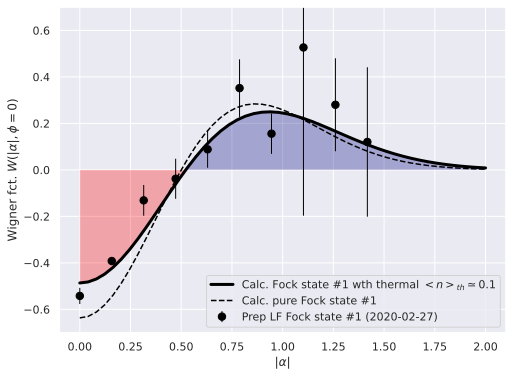

In [30]:
#Plot Wigner results Fock state

Nc=10

rho_pure = fock_dm(Nc, 1)

a = destroy(Nc)
rho = a.dag()*thermal_dm(Nc, .1)*a

sim_dat_x=[]
sim_dat_y=[]
sim_dat_pure=[]

for a in np.linspace(0, 2., 50):
        sim_dat_x.append(a)
        sim_dat_y.append(2*wigner(rho, 2**0.5*a,0)[0,0])
        sim_dat_pure.append(2*wigner(rho_pure, 2**0.5*a,0)[0,0])
  
sim_dat_x=np.array(sim_dat_x)
sim_dat_y=np.array(sim_dat_y)
sim_dat_pure=np.array(sim_dat_pure)

##Data for LF fck state 1 2020-02-27
# [pts_x,pts_y,pts_err]=[dat_x, dat_y, dat_err]
[pts_x,pts_y,pts_err]=np.transpose(dat)
##

fig, ax = plt.subplots(1, 1, figsize=(8,6), sharex=True)
plt.errorbar(pts_x, pts_y, yerr=pts_err, marker = 'o', markersize=7.5, color='Black', lw=1., ls='',fmt='',capsize=.0, label='Prep LF Fock state #1 (2020-02-27)')

plt.plot(sim_dat_x, sim_dat_y, color='black', linewidth=3, label='Calc. Fock state #1 wth thermal $<n>_{th}\simeq0.1$')
plt.plot(sim_dat_x, sim_dat_pure, color='black', linestyle='dashed', label='Calc. pure Fock state #1')
plt.fill_between(sim_dat_x, 0, sim_dat_y, where=sim_dat_y >= 0, facecolor='Navy', interpolate=True, alpha=.3)
plt.fill_between(sim_dat_x, 0, sim_dat_y, where=sim_dat_y <= 0, facecolor='Red', interpolate=True, alpha=.3)
plt.xlabel(r'$|\alpha|$')
plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.legend()
plt.ylim(-.7,.7)
plt.show()

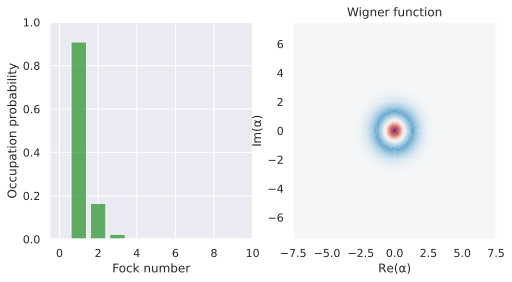

In [31]:
plot_wigner_fock_distribution(rho)
plt.show()

In [32]:
files = [paula.results_path+f for f in fnames]

ws, ws_err = [], []
for file in files:
    w, w_err = wigner_from_file(file, [5,6,7,8,9,10,11], verbose=True, parallel=True)
    ws.append(w)
    ws_err.append(w_err)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done   2 out of   7 | elapsed:    5.0s remaining:   12.6s
[Parallel(n_jobs=-1)]: Done   3 out of   7 | elapsed:    5.6s remaining:    7.4s
[Parallel(n_jobs=-1)]: Done   4 out of   7 | elapsed:   10.1s remaining:    7.6s
[Parallel(n_jobs=-1)]: Done   5 out of   7 | elapsed:   12.3s remaining:    4.9s
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:   15.8s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   7 out of   7 | elapsed:   15.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done   2 out of   7 | elapsed:    4.2s remaining:   10.5s
[Parallel(n_jobs=-1)]: Done   3 out of   7 | elapsed:    4.9s remaining:    6.5s
[Parallel(n_jobs=-1)]: Done   4 out of   7 | elapsed:    7.9s remaining:    5.9s
[Para

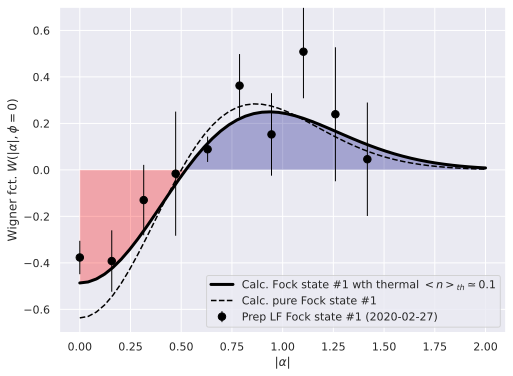

In [33]:
# same plot as above, but with the mean over differen Hilbert space dimensions, and with correct errors

fig, ax = plt.subplots(1, 1, figsize=(8,6), sharex=True)
x = np.linspace(0, 0.105*Tmax/Nt*(len(ws)-1), len(ws))
plt.errorbar(x, ws, ws_err, marker = 'o', markersize=7.5, color='Black', lw=1., ls='',fmt='',capsize=.0, label='Prep LF Fock state #1 (2020-02-27)')

plt.plot(sim_dat_x, sim_dat_y, color='black', linewidth=3, label='Calc. Fock state #1 wth thermal $<n>_{th}\simeq0.1$')
plt.plot(sim_dat_x, sim_dat_pure, color='black', linestyle='dashed', label='Calc. pure Fock state #1')
plt.fill_between(sim_dat_x, 0, sim_dat_y, where=sim_dat_y >= 0, facecolor='Navy', interpolate=True, alpha=.3)
plt.fill_between(sim_dat_x, 0, sim_dat_y, where=sim_dat_y <= 0, facecolor='Red', interpolate=True, alpha=.3)
plt.xlabel(r'$|\alpha|$')
plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.legend()
plt.ylim(-.7,.7)
plt.show()

## make function for paula

In [3]:
def get_pops_err(res, nmax):
    #get populations and their errors
    nth = res[2][-3]
    ncoh = res[2][-2]
    nsq = res[2][-1]

    nth_e = res[3][-3]
    ncoh_e = res[3][-2]
    nsq_e = res[3][-1]

    pops = np.transpose(eios_sb.mixedfockdist(nmax,nth,ncoh,nsq,1))[1]
#     print(pops)

    permuts = np.reshape(np.transpose(np.meshgrid([-1,1],[-1,1],[-1,1])),(-1,3))

    pops_err_list = []
    for permut in permuts:
    #     print(permut)
        pops_err_list.append(np.transpose(eios_sb.mixedfockdist(nmax,np.max([nth + permut[1]*nth_e, 1e-9]), np.max([ncoh + permut[1]*ncoh_e, 0]), np.max([nsq + permut[2]*nsq_e, 0]), 1))[1])

    pops_err = []
    for i, p in enumerate(pops):
        errs = np.abs(np.transpose(pops_err_list)[i]-p)
        pops_err.append(np.max(errs))
    
    return pops, pops_err


def get_W_from_focks(fres_list, fit_fock=1, n_dim=[5, 6, 7, 8]):
    '''argument should be a list of results from the paula.single_fit_sb function
    returns the wigner function (mean of the wigner function calculated from each result)'''
    
    dat_y=[]
    dat_err=[]
    for i, fres in enumerate(fres_list):
        if fit_fock:
            pops = fres[2][-1]
            pops_err = fres[3][-1]
        else:
            pops, pops_err = get_pops_err(fres, n_dim[i])
            
#         print(pops)
        erg, erg_err = 0, 0
        for k in range(len(pops)):
            erg += (-1)**k*pops[k]
#             erg_err += (-1)**k*pops_err[k]
            erg_err += pops_err[k]**2
        
        dat_y.append(2/np.pi*erg)
#         dat_err.append(2/np.pi*erg_err)
        dat_err.append(2/np.pi*np.sqrt(erg_err))

    return(np.array([[dat_y[i], dat_err[i]] for i in range(len(fres_list))]))



def wigner_from_file(file, n_dim = [5, 6, 7, 8], parallel = True, verbose=True, mode_freq=1.3, mode_angle=0, fit_fock=1, fix=[0,0,0,0,0,0,0], Rabi_init=0.169, dec_init=0.025, nth=0.5, ncoh=0.5):
    def func(n):
        return np.array(paula.single_fit_sb([file],
                            mode_freq=mode_freq, mode_angle=mode_angle, Rabi_init=Rabi_init, dec_init=dec_init, limb_init=0.5, limr_init=0.5, nth=nth, ncoh=ncoh,
                            fock=fit_fock, nmax=n, fix=fix))
    
    if parallel:
        if verbose:
            dd = 11
        else:
            dd = 0
        fres = Parallel(n_jobs=-1, verbose=dd)(delayed(func)(n) for n in n_dim)
    else:
        fres = [func(n) for n in n_dim]
        
#     print(fres)
    wigners = np.transpose(get_W_from_focks(fres, fit_fock=fit_fock, n_dim=n_dim))
    
    w = np.mean(wigners[0])
    w_err = np.sqrt(np.sum(wigners[1]**2)/len(wigners[1])**2) # correct error
#     w_err = np.std(wigners[0]) # error from scattering of different values for W (only good for long list of w's)
    print('result for mode freq.:', mode_freq,' and mode angle:', mode_angle)
    return w, w_err
#     return(fres)

In [32]:
# res = wigner_from_file(files[1], n_dim=[12], parallel=False, fit_fock=1, fix=[1,0,0,0,0,0,0])

In [33]:
res

[(-0.12656277660369136, 0.11398630612576073),
 (-0.358361674333053, 0.797710640700221),
 (0.047724978879804314, 0.04162631073512126),
 (0.27765942757406414, 0.12261387558396336),
 (-0.22677397546083153, 0.19578881613383042),
 (-0.19175610502610294, 0.14206128780944768),
 (-0.2585541345124773, 0.06032244863382403),
 (-0.1164695053455296, 0.06703994762973844)]

In [ ]:
# ws, ws_err = [], []
# for file in files:
#     w, w_err = wigner_from_file(file, [4, 5, 6, 7, 8, 9, 10, 11], verbose=True)
#     ws.append(w)
#     ws_err.append(w_err)

In [ ]:
# plt.errorbar(np.linspace(1, len(ws), len(ws)), ws, ws_err, fmt='x')
# plt.ylim(-.5,.5)
# plt.show()

## taking the mean over different nmax

In [74]:
dat_list = []

# files = [paula.results_path+f for f in fnames]
files = ['data/2020_07_31/Messreihe1/'+f for f in fnames2]

for nmax in range(6,10):
    print(nmax)
    def func(i):
        return [Tmax/Nt*i,
                 np.array(paula.single_fit_sb([files[i]],
                            mode_freq=1.3, mode_angle=0, Rabi_init=0.113, dec_init=0.015,
                            limb_init=0.5, limr_init=0.5,
                            fock=1, nmax=nmax, 
                            fix=[0,0,0,0,1,1,1]))
                            ]

    fres = Parallel(n_jobs=-1, verbose=11)(delayed(func)(i) for i in range(len(files)))
    time.sleep(0.1)

    print('finished, took ', time.time()-t1, 's')
    
    dat_list.append(get_W_from_focks(fres))

6


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done   2 out of  11 | elapsed:    6.0s remaining:   27.1s
[Parallel(n_jobs=-1)]: Done   4 out of  11 | elapsed:    6.4s remaining:   11.2s
[Parallel(n_jobs=-1)]: Done   6 out of  11 | elapsed:    7.0s remaining:    5.8s
[Parallel(n_jobs=-1)]: Done   8 out of  11 | elapsed:    8.9s remaining:    3.3s
[Parallel(n_jobs=-1)]: Done  11 out of  11 | elapsed:   14.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


finished, took  2707.7909202575684 s
[0.5247859402100006, 0.295110806222104, 0.1256643979423852, 0.05443764006700767, 4.861318706650569e-08, 1.1669453154685119e-06]
[0.31759244766514605, 0.291688795470541, 0.170599562287161, 0.0499329274600316, 0.17017426151679477, 1.2005600325586836e-05]
[0.11853280489363653, 6.272408233529859e-11, 4.237489375531564e-07, 0.8814627993898699, 3.716382238211367e-06, 2.5552259370115056e-07]
[0.41480013150778866, 0.3689866067331199, 0.12949403697637224, 6.023319797832524e-09, 7.32863031924062e-08, 0.08671914547309628]
[0.2834811194915477, 0.02012686534872911, 0.0385730183564479, 2.5704902115535724e-06, 2.696816915603401e-07, 0.6578161566313722]
[0.5542730878570703, 0.25925879754849496, 0.14597023434816844, 0.040497797510958625, 3.4426674449568404e-08, 4.8308633258928825e-08]
[0.6053514924623494, 0.24561168174903678, 0.11369405165090987, 0.0353427729069968, 2.6883755563910915e-10, 9.61869759843814e-10]
[0.09000814239863547, 8.502133138710847e-08, 5.39117752

[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done   2 out of  11 | elapsed:    7.9s remaining:   35.7s
[Parallel(n_jobs=-1)]: Done   4 out of  11 | elapsed:    8.4s remaining:   14.8s
[Parallel(n_jobs=-1)]: Done   6 out of  11 | elapsed:    9.0s remaining:    7.5s
[Parallel(n_jobs=-1)]: Done   8 out of  11 | elapsed:   13.4s remaining:    5.0s
[Parallel(n_jobs=-1)]: Done  11 out of  11 | elapsed:   16.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


finished, took  2724.4079875946045 s
[0.5247389350976198, 0.29507412667552396, 0.12562190117609956, 0.05401440819683381, 3.887315120114168e-07, 4.6951470469169206e-08, 0.0005501931709404305]
[0.3175423516113107, 0.29172548589728936, 0.17060880335218476, 0.049706335270042055, 0.17039320495985327, 2.3789421761808074e-05, 2.9487558065110626e-08]
[0.49652876926973916, 0.3154112918015704, 0.10822295712604867, 3.503333529754496e-08, 3.6353284340037237e-07, 0.07983651906365473, 6.417280834703585e-08]
[0.41486013452147497, 0.36899562154526, 0.12946368468571237, 5.593270876610309e-09, 1.0610902679405715e-06, 0.08667949255450814, 9.505692587750229e-12]
[0.28281905156342496, 0.022325837364497544, 0.08359477857521783, 7.015468655139494e-07, 5.436766761175252e-07, 7.129528835539242e-05, 0.6111877919849625]
[0.5542738588097499, 0.25925965927993183, 0.1459753172347221, 0.040491133506495594, 3.467551018379237e-09, 5.619288092352735e-09, 2.2082261508309282e-08]
[0.6054386232773599, 0.24562516340642665,

[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    7.0s
[Parallel(n_jobs=-1)]: Done   2 out of  11 | elapsed:    8.8s remaining:   39.5s
[Parallel(n_jobs=-1)]: Done   4 out of  11 | elapsed:   11.3s remaining:   19.9s
[Parallel(n_jobs=-1)]: Done   6 out of  11 | elapsed:   13.0s remaining:   10.8s
[Parallel(n_jobs=-1)]: Done   8 out of  11 | elapsed:   14.2s remaining:    5.3s
[Parallel(n_jobs=-1)]: Done  11 out of  11 | elapsed:   28.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


finished, took  2752.5828580856323 s
[0.5204325673229359, 0.2875464804741357, 0.1184939433610774, 0.020743293860619714, 1.2765782019984708e-12, 4.112555428948729e-11, 1.1217494127187921e-11, 0.05278371492761162]
[0.31755373307559803, 0.29171304241115914, 0.17053355030025316, 0.04992850625826363, 0.17027085514531431, 3.127276172977887e-07, 5.5688002264189727e-11, 2.6106348519880316e-11]
[0.4964885607356731, 0.3154096729861533, 0.10823632591629082, 4.748025553492774e-11, 3.709392421573479e-07, 0.0798650601770204, 8.433783531679376e-10, 8.354761671840753e-09]
[0.4149183500823329, 0.36898868775721955, 0.12947398571619093, 7.927313338509697e-08, 6.642446109652718e-10, 0.08661888580922, 1.7525908771862726e-09, 8.945067781166357e-09]
[0.2800709052594354, 0.040618623830751606, 0.11566472184107926, 2.0700280386698578e-05, 1.5075350468894243e-07, 1.160625873294781e-08, 5.029238682818689e-06, 0.5636198571899007]
[0.5543344949460928, 0.25927852251352634, 0.14596809696565924, 0.04041865875787326, 2

[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   12.5s
[Parallel(n_jobs=-1)]: Done   2 out of  11 | elapsed:   15.3s remaining:  1.2min
[Parallel(n_jobs=-1)]: Done   4 out of  11 | elapsed:   21.2s remaining:   37.2s
[Parallel(n_jobs=-1)]: Done   6 out of  11 | elapsed:   23.9s remaining:   19.9s
[Parallel(n_jobs=-1)]: Done   8 out of  11 | elapsed:   27.6s remaining:   10.4s


finished, took  2800.477340221405 s
[0.5132903758110022, 0.26685414983658023, 0.10655399782167964, 9.221587367684279e-11, 3.526102013128144e-13, 2.2693375033716337e-12, 1.1128910948376308e-12, 1.224773073146641e-11, 0.11330147642253924]
[0.31764575080220236, 0.2918704669605371, 0.17050271069810272, 0.05011927094901728, 0.16986025795206838, 2.9967007830598536e-07, 7.800919957347295e-07, 4.03412760254577e-07, 5.9463237783896905e-08]
[0.49653688920996814, 0.31543242617610223, 0.1082564039985576, 2.850619214320024e-08, 7.129218375543354e-06, 0.07976710689131258, 1.004558808418188e-09, 1.2094575243717144e-08, 2.9003577264960895e-09]
[0.4148756460847541, 0.36899352960613085, 0.12945326044320712, 3.6304529929535665e-12, 8.740570609537894e-10, 0.08667756204619907, 8.988517368193478e-10, 3.214860915304227e-11, 1.1021005829468946e-11]
[0.28004097690179774, 0.04047550392379226, 0.11618207728914207, 1.2544268623677265e-06, 7.963328698631891e-08, 1.9865168597744563e-08, 9.292270699234683e-08, 0.563

[Parallel(n_jobs=-1)]: Done  11 out of  11 | elapsed:   47.8s finished


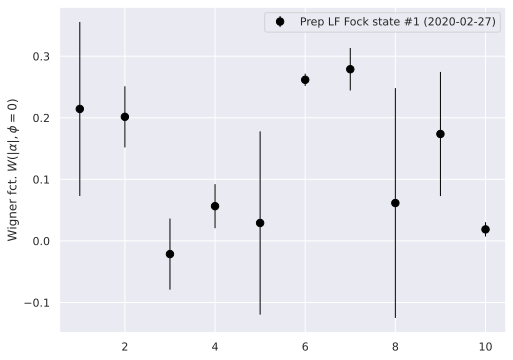

In [76]:
# mitteln über verschiedene n
from qutip import *

Nc=10
rho_pure = fock_dm(Nc, 1)
a = destroy(Nc)
rho = a.dag()*thermal_dm(Nc, .1)*a

sim_dat_x=[]
sim_dat_y=[]
sim_dat_pure=[]
for a in np.linspace(0, 2., 50):
        sim_dat_x.append(a)
        sim_dat_y.append(2*wigner(rho, 2**0.5*a,0)[0,0])
        sim_dat_pure.append(2*wigner(rho_pure, 2**0.5*a,0)[0,0])
  
sim_dat_x=np.array(sim_dat_x)
sim_dat_y=np.array(sim_dat_y)
sim_dat_pure=np.array(sim_dat_pure)

##Data for LF fck state 1 2020-02-27
# [pts_x,pts_y,pts_err]=[dat_x, dat_y, dat_err]

pts_x = np.transpose(dat_list[0])[0]
pts_y = []
pts_err = []
for i in range(len(dat_list[0])):
    list_y = [arr[i][1] for arr in dat_list]
    list_err = [arr[i][2] for arr in dat_list]
    pts_y.append(np.mean(list_y))
#     pts_err.append(np.std(list_y))
    pts_err.append(np.sqrt(np.sum(np.array(list_err)**2)/len(list_err)**2))
    
pts_x = np.linspace(1, len(pts_y), len(pts_y))


fig, ax = plt.subplots(1, 1, figsize=(8,6), sharex=True)
plt.errorbar(pts_x, pts_y, yerr=pts_err, marker = 'o', markersize=7.5, color='Black', lw=1., ls='',fmt='',capsize=.0, label='Prep LF Fock state #1 (2020-02-27)')

# plt.plot(sim_dat_x, sim_dat_y, color='black', linewidth=3, label='Calc. Fock state #1 wth thermal $<n>_{th}\simeq0.1$')
# plt.plot(sim_dat_x, sim_dat_pure, color='black', linestyle='dashed', label='Calc. pure Fock state #1')
# plt.fill_between(sim_dat_x, 0, sim_dat_y, where=sim_dat_y >= 0, facecolor='Navy', interpolate=True, alpha=.3)
# plt.fill_between(sim_dat_x, 0, sim_dat_y, where=sim_dat_y <= 0, facecolor='Red', interpolate=True, alpha=.3)
# plt.xlabel(r'$|\alpha|$')
plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.legend()
# plt.ylim(-.7,.7)
plt.show()

## wigner function for differen measurement series

In [5]:
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/'
fnames2 = os.listdir(direct)
files = sorted([direct+f for f in fnames2])
# files = select_files(files, [16,48,00], [16,55,00]) # mode freq 1.2992, angle 0
files = select_files(files, [17,45,00], [17,53,00]) # mode freq 1.2973, angle 0, Omega 0.098, nth = 0.058, dec = 0.009
files

8 files


['/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_45_38_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_46_39_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_47_41_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_48_43_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_49_44_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_50_46_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_51_47_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/17_52_49_04_08_2020.dat']

In [18]:
direct = 'data/2020_08_04/Messreihe_1/'
fnames2 = os.listdir(direct)
files = sorted([direct+f for f in fnames2])
files

['data/2020_08_04/Messreihe_1/16_25_55_04_08_2020.dat',
 'data/2020_08_04/Messreihe_1/16_26_35_04_08_2020.dat',
 'data/2020_08_04/Messreihe_1/16_27_15_04_08_2020.dat',
 'data/2020_08_04/Messreihe_1/16_27_55_04_08_2020.dat',
 'data/2020_08_04/Messreihe_1/16_28_35_04_08_2020.dat',
 'data/2020_08_04/Messreihe_1/16_29_15_04_08_2020.dat',
 'data/2020_08_04/Messreihe_1/16_29_55_04_08_2020.dat',
 'data/2020_08_04/Messreihe_1/16_30_34_04_08_2020.dat']

z_axial_R1_R2: 17_45_38_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:48:21 2020
migrad finished at Thu Aug  6 10:48:40 2020


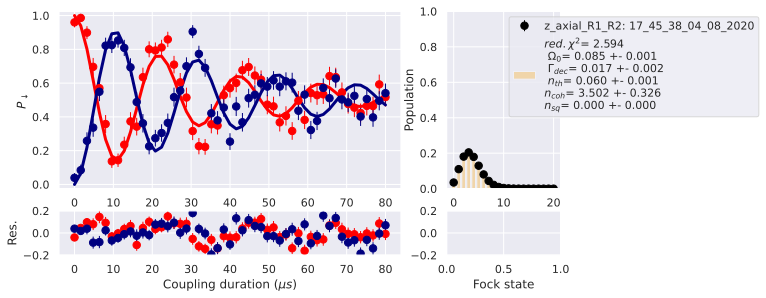

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 17_46_39_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:48:41 2020
migrad finished at Thu Aug  6 10:48:59 2020


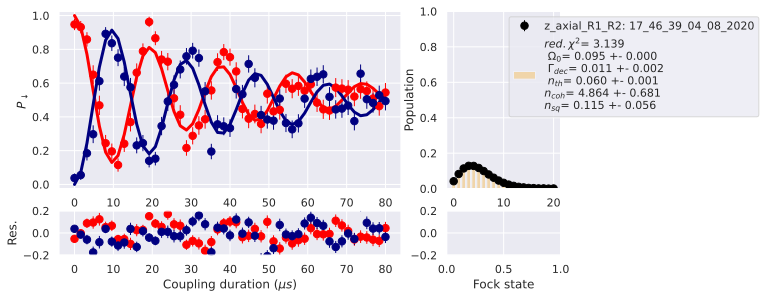

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 17_47_41_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:49:00 2020
migrad finished at Thu Aug  6 10:49:19 2020


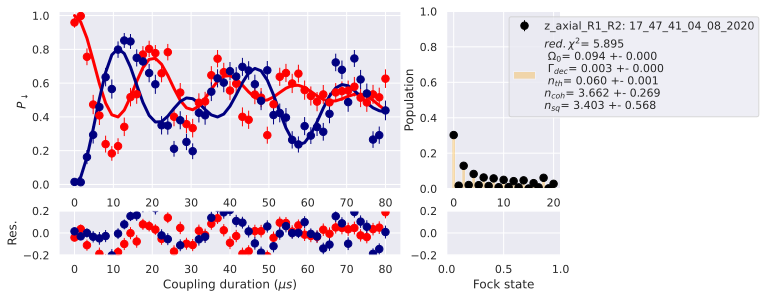

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 17_48_43_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:49:20 2020
migrad finished at Thu Aug  6 10:49:29 2020


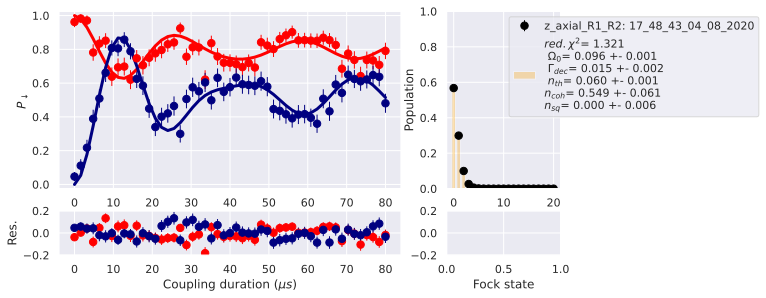

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 17_49_44_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:49:30 2020
migrad finished at Thu Aug  6 10:49:46 2020


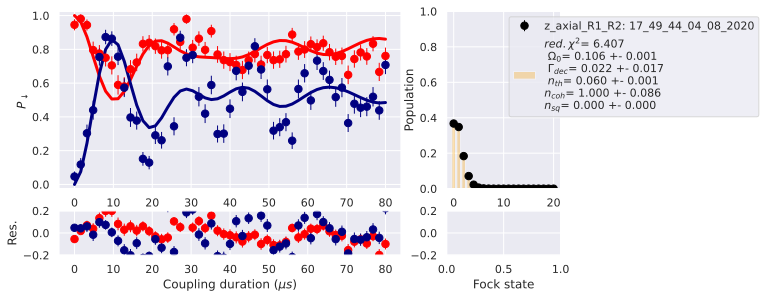

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 17_50_46_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:49:46 2020
migrad finished at Thu Aug  6 10:50:06 2020


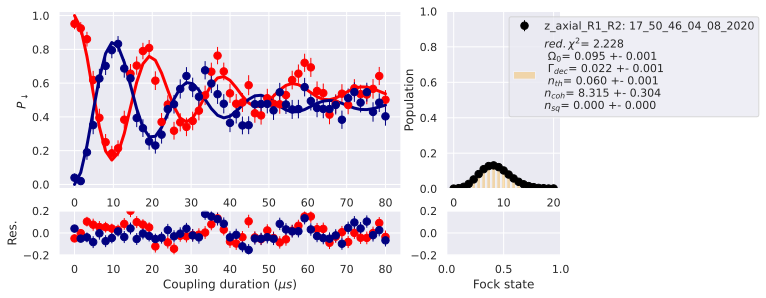

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 17_51_47_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:50:06 2020
migrad finished at Thu Aug  6 10:50:18 2020


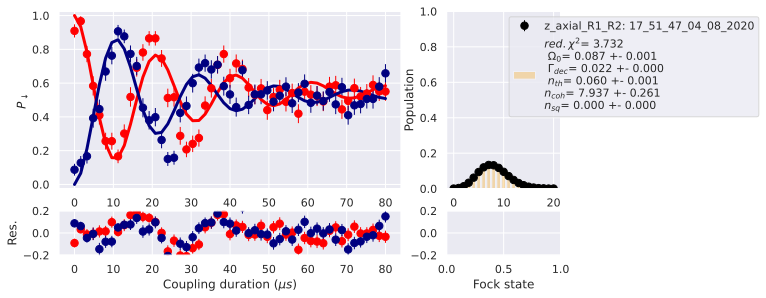

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 17_52_49_04_08_2020
Free parameter count 6
migrad started at Thu Aug  6 10:50:19 2020
migrad finished at Thu Aug  6 10:50:38 2020


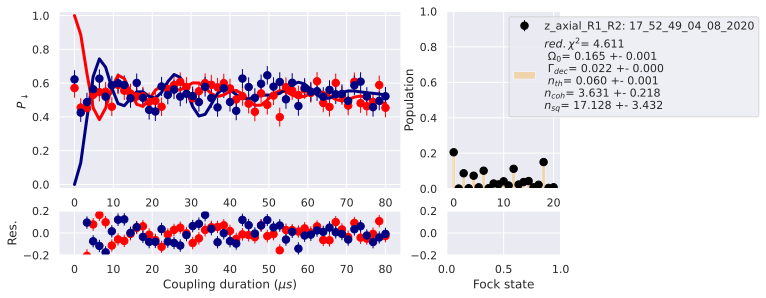

result for mode freq.: 1.2992  and mode angle: 0
processing time: 138.247 s


In [6]:
# do the analyzation
t1 = time.time()

# parallel over files, fast but without plots
# res = Parallel(n_jobs=-1, verbose=51)(delayed(wigner_from_file)(file, [9,10,11,12], mode_freq=1.2973, mode_angle=0,
#                                                                 verbose=True, parallel=False, fix=[1,1,0,0,0,0,0], Rabi_init=0.098, dec_init=0.009, nth=0.05, ncoh=0.5, fit_fock=1) for file in files)

# not parallel, slow but with plots
res = [wigner_from_file(file, [20], mode_freq=1.2992, mode_angle=0, verbose=True, parallel=False, fix=[0,0,0,0,1,0,0], Rabi_init=0.110, nth=0.06, ncoh=0.5, fit_fock=0) for file in files]
print('processing time:', np.round(time.time()-t1, 3), 's')

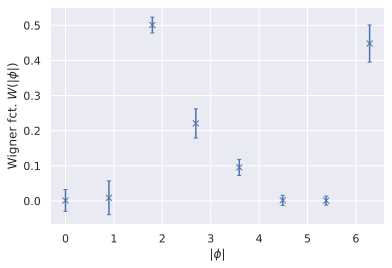

In [7]:
# plot it
x = np.linspace(0, 2*np.pi, len(np.transpose(res)[0]))

plt.errorbar(x, np.transpose(res)[0], np.transpose(res)[1], fmt='x')
# plt.ylim(-.5,.8)/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2

plt.xlabel(r'$|\phi|$')
plt.ylabel(r'Wigner fct. $ W(|\phi|)$')
# plt.xlabel(r'$|\alpha|$')
# plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.show()

[1.01909162 0.09259344 2.18014408 0.22227893]


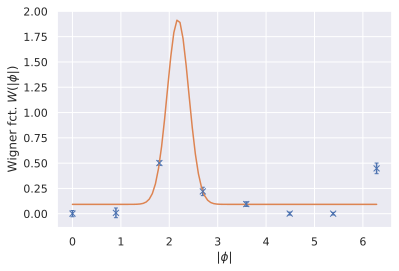

array([0.09259344, 0.09259344, 0.09259344, 0.09259344, 0.09259344,
       0.09259344, 0.09259344, 0.09259344, 0.09259344, 0.09259344,
       0.09259344, 0.09259344, 0.09259344, 0.09259345, 0.09259352,
       0.09259387, 0.09259543, 0.092602  , 0.09262726, 0.09271658,
       0.0930067 , 0.09387174, 0.09623796, 0.1021707 , 0.11579061,
       0.1443807 , 0.19915603, 0.29470009, 0.44589894, 0.66185804,
       0.93801232, 1.24983411, 1.55264914, 1.79048184, 1.91247383,
       1.89051414, 1.72975752, 1.4666603 , 1.15555488, 0.85050955,
       0.59069597, 0.39431778, 0.2610531 , 0.17928473, 0.13371305,
       0.11057041, 0.09983743, 0.09528394, 0.09351449, 0.09288406,
       0.09267796, 0.09261609, 0.09259903, 0.09259471, 0.0925937 ,
       0.09259349, 0.09259344, 0.09259344, 0.09259344, 0.09259344,
       0.09259344, 0.09259344, 0.09259344, 0.09259344, 0.09259344,
       0.09259344, 0.09259344, 0.09259344, 0.09259344, 0.09259344,
       0.09259344, 0.09259344, 0.09259344, 0.09259344, 0.09259

In [88]:
# plot it
def gauß_2pi(x, A, C, mu, sig):
#     d2 = np.min([(x-mu)**2, (x-2*np.pi-mu)**2])
    return(A/(sig*np.sqrt(2*np.pi))*np.exp(-0.5*(x-mu)**2/sig**2) + C)

x = np.linspace(0, 2*np.pi, len(np.transpose(res)[0]))
xx = np.linspace(0, 2*np.pi, 100)

from scipy.optimize import curve_fit
params, _ = curve_fit(gauß_2pi,x,np.transpose(res)[0], [1, 0, 2, 1])
print(params)

plt.errorbar(x, np.transpose(res)[0], np.transpose(res)[1], fmt='x')
# plt.ylim(-.7,.7)

yy = [gauß_2pi(xxx, *params) for xxx in xx]
plt.plot(xx, yy)

plt.xlabel(r'$|\phi|$')
plt.ylabel(r'Wigner fct. $ W(|\phi|)$')
# plt.xlabel(r'$|\alpha|$')
# plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.show()

gauß_2pi(xx, *params)

Messreihe2: 11_19_39_31_07_2020
Free parameter count 11
migrad started at Fri Jul 31 15:43:17 2020
migrad finished at Fri Jul 31 15:43:23 2020


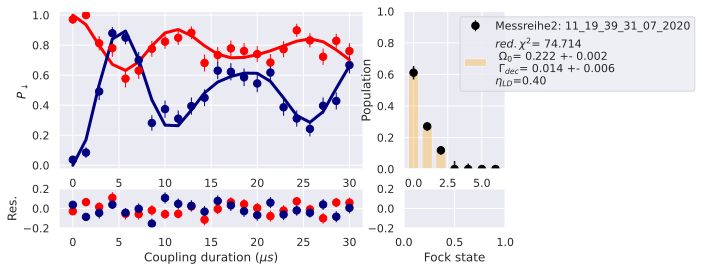

Messreihe2: 11_19_39_31_07_2020
Free parameter count 12
migrad started at Fri Jul 31 15:43:23 2020
migrad finished at Fri Jul 31 15:43:29 2020


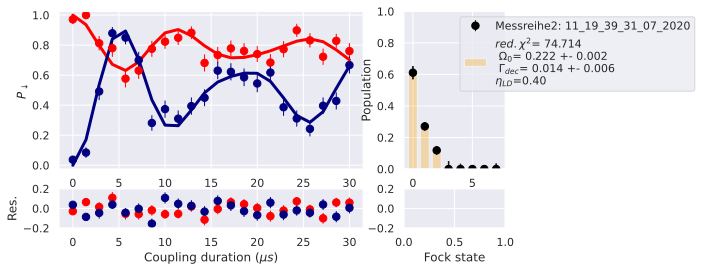

Messreihe2: 11_19_39_31_07_2020
Free parameter count 13
migrad started at Fri Jul 31 15:43:30 2020
migrad finished at Fri Jul 31 15:43:35 2020


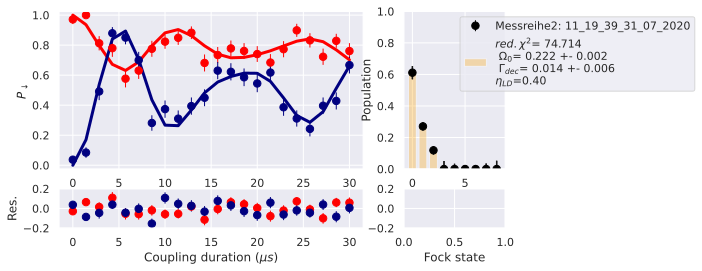

Messreihe2: 11_19_39_31_07_2020
Free parameter count 14
migrad started at Fri Jul 31 15:43:36 2020
migrad finished at Fri Jul 31 15:43:45 2020


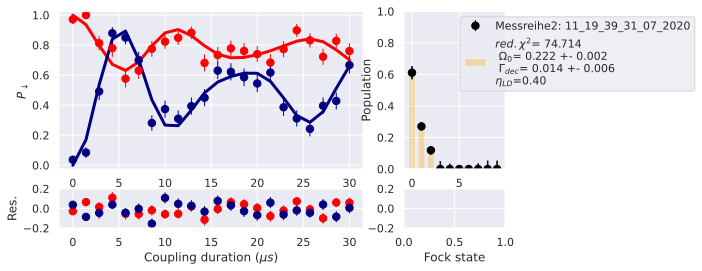

wigner func.:  0.29234529354182864 +- 0.0333590086333564


In [45]:
# look at the sideband fits for different points
paula.do_plot = True

w, w_err = wigner_from_file(files[4], [7,8,9,10], verbose=True, parallel=False)
print('wigner func.: ', w, '+-', w_err)

# new fit routine

In [5]:
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/'
fnames2 = os.listdir(direct)
files = sorted([direct+f for f in fnames2])
files = select_files(files, [16,48,00], [16,55,00]) # mode freq 1.2992, angle 0, Omega = 0.110
# files = select_files(files, [17,45,00], [17,52,00]) # mode freq 1.2973, angle 0, Omega 0.098, nth = 0.058, dec = 0.009
files

8 files


['/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_48_01_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_48_58_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_49_54_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_50_51_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_51_47_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_52_44_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_53_40_04_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2/16_54_37_04_08_2020.dat']

z_axial_R1_R2: 16_48_01_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:30 2020
migrad finished at Thu Aug  6 12:05:33 2020


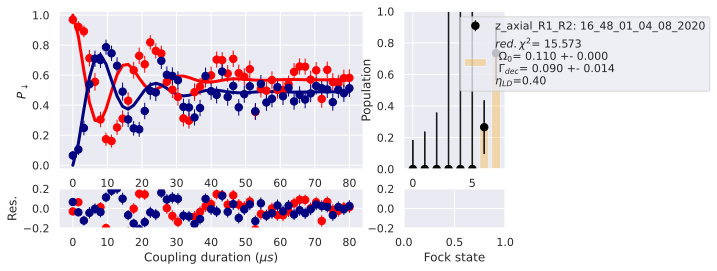

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 16_48_58_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:34 2020
migrad finished at Thu Aug  6 12:05:38 2020


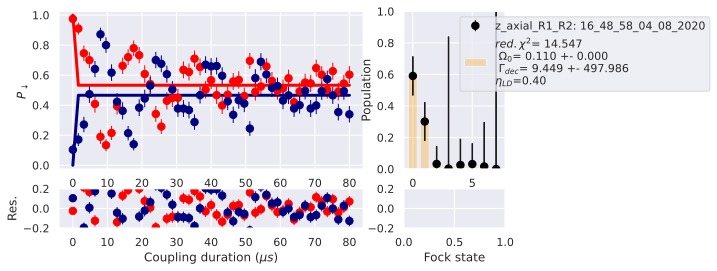

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 16_49_54_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:39 2020
migrad finished at Thu Aug  6 12:05:41 2020


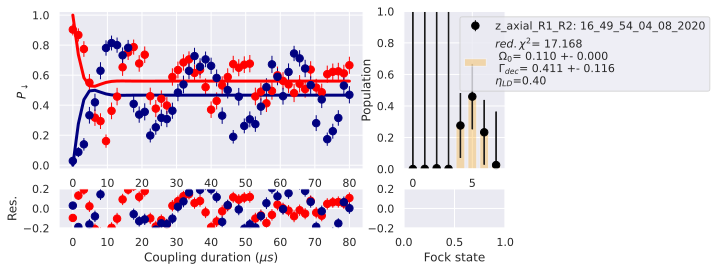

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 16_50_51_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:42 2020
migrad finished at Thu Aug  6 12:05:45 2020


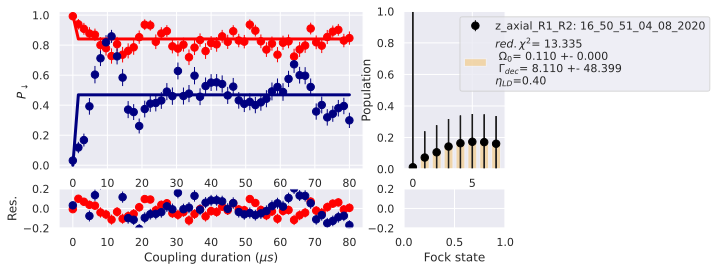

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 16_51_47_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:45 2020
migrad finished at Thu Aug  6 12:05:47 2020


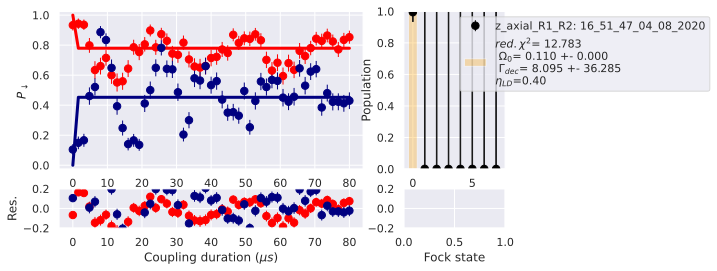

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 16_52_44_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:48 2020
migrad finished at Thu Aug  6 12:05:50 2020


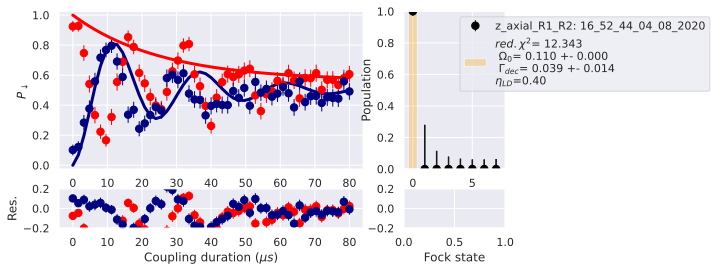

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 16_53_40_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:51 2020
migrad finished at Thu Aug  6 12:05:56 2020


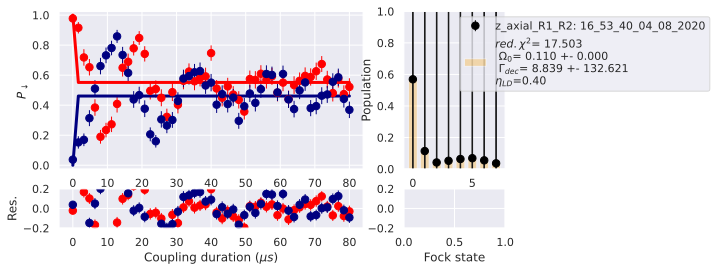

result for mode freq.: 1.2992  and mode angle: 0
z_axial_R1_R2: 16_54_37_04_08_2020
lamb dicke parameter: 0.39585617541742185
ddd
Free parameter count 11
R migrad started at Thu Aug  6 12:05:57 2020
migrad finished at Thu Aug  6 12:05:59 2020


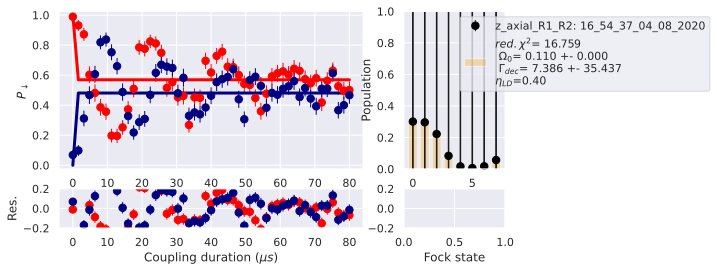

result for mode freq.: 1.2992  and mode angle: 0
processing time: 30.093 s


In [20]:
t1 = time.time()

res = [wigner_from_file(file, [8], mode_freq=1.2992, mode_angle=0, verbose=True, parallel=False,
                        fix=[1,0,0,0,0,0,0], Rabi_init=0.110, dec_init = 0.009, nth=0.06, ncoh=0.5, fit_fock=1) for file in files]

print('processing time:', np.round(time.time()-t1, 3), 's')

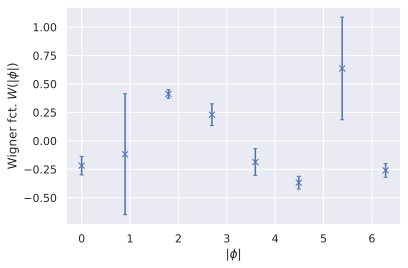

In [10]:
# plot it
x = np.linspace(0, 2*np.pi, len(np.transpose(res)[0]))

plt.errorbar(x, np.transpose(res)[0], np.transpose(res)[1], fmt='x')
# plt.ylim(-.5,.8)/mnt/paula/Results/tiamo4.sync/2020/08_August/04/OC_Axial/z_axial_R1_R2

plt.xlabel(r'$|\phi|$')
plt.ylabel(r'Wigner fct. $ W(|\phi|)$')
# plt.xlabel(r'$|\alpha|$')
# plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.show()

# carrier-bsb-flop

In [4]:
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/11/OC_Axial/1_1R_LF_Car_Blue/'
fnames = os.listdir(direct)
files = sorted([direct+f for f in fnames])
files = select_files(files, [17,42,00], [17,45,00])

2 files


1_1R_LF_Car_Blue: 17_42_21_11_08_2020
first point of carrierflop (should be 1): 0.999999379614685
first point of blueflop (should be 0): 0.04118508828286549
lamb dicke parameter: 0.396
Free parameter count 16
migrad started at Thu Aug 13 10:56:42 2020
migrad finished at Thu Aug 13 10:57:00 2020


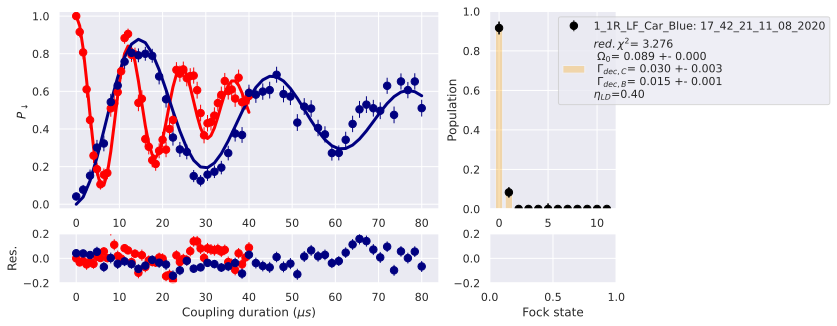

([3.276143817088443],
 [True],
 [0.089,
  0.03037150861139737,
  0.01492887864394632,
  0.5304360828193941,
  0.4391326728735669,
  [0.915991741627792,
   0.08400825470587935,
   1.5898222781408489e-12,
   2.0016230067392023e-13,
   2.4566485394993856e-12,
   3.5951701911168646e-09,
   9.562468467876601e-13,
   5.133848438239593e-12,
   1.1196505875881102e-13,
   2.7688341533851655e-13,
   8.944388721034258e-12,
   5.148831483563613e-11]],
 [0.0,
  0.0026903193819467486,
  0.0013561657411909067,
  0.015211541217253821,
  0.01485028191689014,
  [0.032067109889412575,
   0.02586727869323417,
   0.0018729994408017464,
   0.0016342525085810188,
   0.004781618425586899,
   0.027774176210669015,
   0.0060076505969247984,
   0.0034001483315957734,
   0.0030524437940990974,
   0.0033024720813820047,
   0.00480749657084677,
   0.01191990158044077]])

In [4]:
paula.single_fit_sb_carr([files[0]],2, mode_freq=1.2981, mode_angle=0, Rabi_init=0.089, decc_init=0.001, decb_init=0.014, limc_init=0.5, limb_init=0.5, fock=True, nmax=12, fix=[1,0,0,0,0]);


1_1R_LF_Car_Blue: 17_42_21_11_08_2020
first point of carrierflop (should be 1): 0.999999379614685
first point of blueflop (should be 0): 0.04118508828286549
Free parameter count 6
migrad started at Mon Aug 17 11:34:00 2020
migrad finished at Mon Aug 17 11:34:02 2020


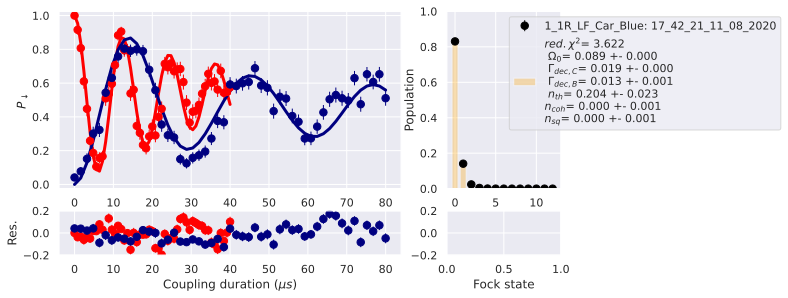

blue_scale = 2.0
fr_lf = 1.2981


[2.0, 1.2981]

In [6]:
paula.single_fit_sb_carr([files[0]],2, mode_freq=1.2981, mode_angle=0, Rabi_init=0.093, decc_init=0.014, decb_init=0.014, limb_init=0.5, limc_init=0.5, nth=0.4, ncoh=0, nsq=0, fock=False, nmax=12, fix=[0,0,0,0,0,0,1,1]);
get_ionprop(files[0], ['blue_scale', 'fr_lf'])

## LHS sampling

In [48]:
# first fit to get a nice fock state distribution, but rabi rate fixed (from temperature measurement earlier)
# res = paula.single_fit_sb_carr([files[0]],2, mode_freq=1.2981, mode_angle=0, Rabi_init=0.093, decc_init=0.014, decb_init=0.014, limc_init=0.5, limb_init=0.5, fock=True, nmax=20, fix=[1,0,0,0,0]);

In [49]:
# second fit, with fock states from above as initial states, but thist time with the rabi rate not fixed
# paula.single_fit_sb_carr([files[0]],2, mode_freq=1.2981, mode_angle=0, Rabi_init=0.089, decc_init=0.014, decb_init=0.014, limb_init=0.5, limc_init=0.5, nth=0.4, ncoh=0, nsq=0, init_pops = res[-1][-1], fock=True, nmax=20, fix=[0,0,0,0,0]);

In [8]:
n_lhs = 32
nmax = 18
lhs_list = np.transpose(np.array(lhs.sample(nmax, n_lhs)))
# initpops = lhs_list/np.sum(lhs_list)

res_lhs = Parallel(n_jobs=-1, verbose=51)(delayed(paula.single_fit_sb_carr)([files[0]],2, mode_freq=1.2981, mode_angle=0, Rabi_init=0.093, decc_init=0.014, decb_init=0.014, limc_init=0.5, limb_init=0.5, init_pops = init_lhs, fock=True, nmax=nmax, fix=[0,0,0,0,0], n_lhs=0) for init_lhs in lhs_list)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   25.1s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   34.0s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   34.6s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   40.6s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   42.8s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   58.2s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  2

reduced chi square of best fit:  3.5539
reduced chi square of worst fit: 20.5342


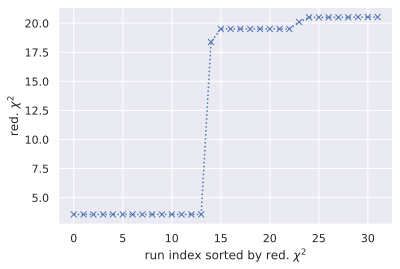

In [30]:
# make waterfall plot
chi_list = [r[0][0] for r in res_lhs]
plt.plot(range(n_lhs), sorted(chi_list), 'x:')
plt.ylabel(r'red. $\chi^2$')
plt.xlabel(r'run index sorted by red. $\chi^2$')
plt.plot()

# get best fit
idx = np.argmin(chi_list)
idy = np.argmax(chi_list)
print('reduced chi square of best fit: ', np.round(chi_list[idx],4))
print('reduced chi square of worst fit:', np.round(chi_list[idy],4))

In [20]:
res_lhs[idx][2][-1]

[0.9035485910572522,
 0.09317144145348215,
 2.31706444843969e-14,
 5.821769970953996e-17,
 5.740265191360639e-14,
 6.281227550123667e-10,
 4.3208012370426364e-12,
 2.6314400268712057e-14,
 3.656071541759109e-14,
 2.5045254415044085e-13,
 9.205382678072458e-13,
 2.6651480750030295e-12,
 1.0851197048861152e-12,
 9.081961154688233e-15,
 3.010437251980311e-13,
 0.0032799668512135272,
 1.548590812273763e-14,
 2.1808350311193666e-13]

1_1R_LF_Car_Blue: 17_42_21_11_08_2020
first point of carrierflop (should be 1): 0.999999379614685
first point of blueflop (should be 0): 0.04118508828286549
lamb dicke parameter: 0.396
yo
[8.93133294e-02 2.98099817e-02 1.44569989e-02 5.31619475e-01
 4.36766346e-01 9.03548591e-01 9.31714415e-02 2.31706445e-14
 5.82176997e-17 5.74026519e-14 6.28122755e-10 4.32080124e-12
 2.63144003e-14 3.65607154e-14 2.50452544e-13 9.20538268e-13
 2.66514808e-12 1.08511970e-12 9.08196115e-15 3.01043725e-13
 3.27996685e-03 1.54859081e-14 2.18083503e-13]
my init pops
Free parameter count 23
migrad started at Thu Aug 13 11:07:58 2020
migrad finished at Thu Aug 13 11:08:19 2020


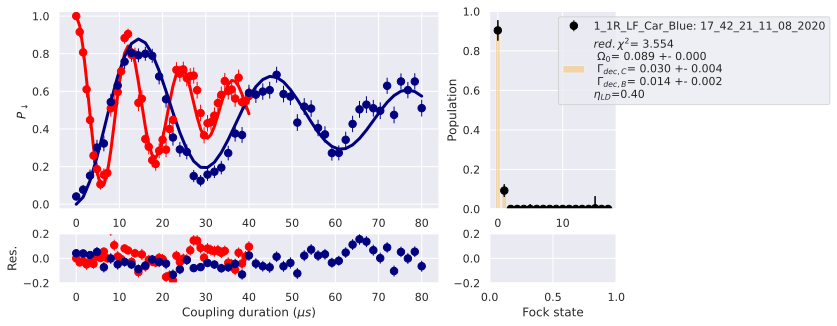

1_1R_LF_Car_Blue: 17_42_21_11_08_2020
first point of carrierflop (should be 1): 0.999999379614685
first point of blueflop (should be 0): 0.04118508828286549
lamb dicke parameter: 0.396
yo
[1.23183639e-01 5.78206089e-01 6.69786004e-10 5.03751308e-01
 5.48415028e-01 7.23210496e-02 1.18129250e-02 1.52766128e-02
 2.02425421e-02 1.21930818e-06 2.46286524e-07 1.01470094e-07
 1.61976384e-07 7.00899834e-08 1.71731892e-07 1.47408951e-06
 1.14216897e-05 6.37036782e-07 1.20233859e-06 1.10786371e-01
 5.00222612e-01 1.87258375e-01 8.20628072e-02]
my init pops
Free parameter count 23
migrad started at Thu Aug 13 11:08:19 2020
migrad finished at Thu Aug 13 11:08:28 2020


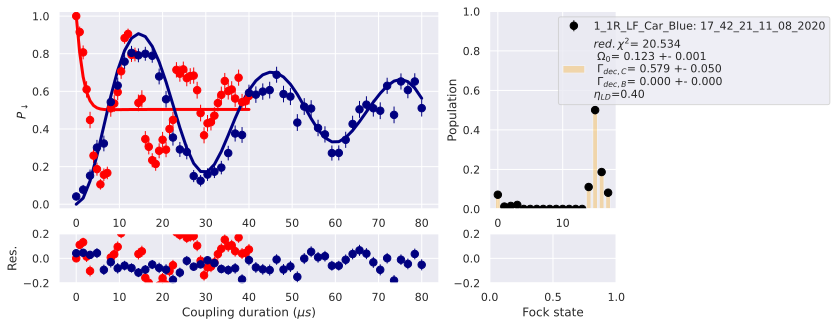

([20.53423239917419],
 [True],
 [0.123168146470235,
  0.5785138802219869,
  7.421232517401677e-10,
  0.5037085774138635,
  0.550668750376414,
  [0.07197147138162792,
   0.011940841648582013,
   0.015222822869915739,
   0.02040589131820131,
   1.512010133128561e-10,
   3.9603755148788643e-10,
   2.290190329920412e-09,
   1.2215853009852465e-08,
   7.859433251080788e-10,
   1.6955811425036434e-09,
   4.18629892255583e-07,
   3.604259469443595e-06,
   5.783348549896216e-10,
   2.597206560374869e-07,
   0.11108179233977743,
   0.5003117894336535,
   0.18684584168595936,
   0.08221524859912376]],
 [0.0005438213323641916,
  0.049970689223115206,
  6.6978649263527146e-06,
  0.005779543187521191,
  0.5174370709940974,
  [0.01151339193328547,
   0.010611293883832086,
   0.00906002105639503,
   0.010902214582125817,
   0.0007199045026267321,
   0.0007063718736573135,
   0.0007368094953178171,
   0.0007768406300704294,
   0.0007347926680714061,
   0.0006754778515849057,
   0.0007466413417311378,


In [21]:
# best fit
paula.single_fit_sb_carr([files[0]],2, mode_freq=1.2981, mode_angle=0, Rabi_init=res_lhs[idx][2][0], decc_init=res_lhs[idx][2][1], decb_init=res_lhs[idx][2][2], limc_init=res_lhs[idx][2][3], limb_init=res_lhs[idx][2][4], init_pops = res_lhs[idx][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0]);

# worst fit
paula.single_fit_sb_carr([files[0]],2, mode_freq=1.2981, mode_angle=0, Rabi_init=res_lhs[idy][2][0], decc_init=res_lhs[idy][2][1], decb_init=res_lhs[idy][2][2], limc_init=res_lhs[idy][2][3], limb_init=res_lhs[idy][2][4], init_pops = res_lhs[idy][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0]);


## different measurements

### 13.08.2020

In [22]:
file_coh = '/mnt/paula/Results/tiamo4.sync/2020/08_August/13/OC_Axial/z_coherent_displ_car_blue/10_36_09_13_08_2020.dat'
file_sq = '/mnt/paula/Results/tiamo4.sync/2020/08_August/13/OC_Axial/z_coherent_displ_car_blue/10_40_25_13_08_2020.dat'

z_coherent_displ_car_blue: 10_36_09_13_08_2020
first point of carrierflop (should be 1): 0.9814432357636214
first point of blueflop (should be 0): 0.0667728278681588
Free parameter count 6
migrad started at Thu Aug 13 14:58:42 2020
migrad finished at Thu Aug 13 14:58:45 2020


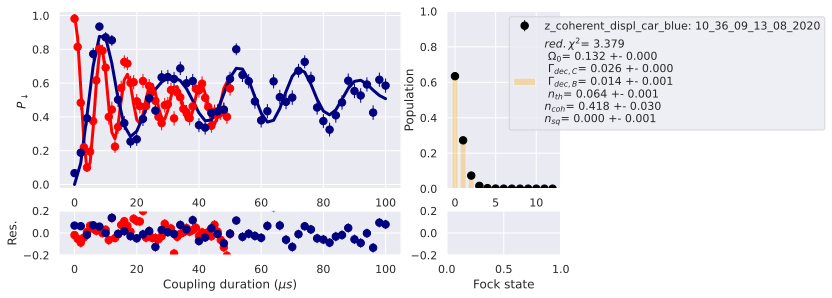

In [50]:
# paula.single_fit_sb_carr([file_coh],2, mode_freq=1.2974, mode_angle=0, Rabi_init=0.13, decc_init=0.019, decb_init=0.019, limc_init=0.5, limb_init=0.5, fock=True, nmax=18, fix=[1,0,0,0,0])
paula.single_fit_sb_carr([file_coh],2, mode_freq=1.2974, mode_angle=0, Rabi_init=0.13, decc_init=0.019, decb_init=0.019, limc_init=0.5, limb_init=0.5, fock=False, nmax=12,  nth=0.064, ncoh=0.5, nsq=0, fix=[0,0,0,0,0,1,0,1]);

In [31]:
n_lhs = 32
nmax = 18
lhs_list = np.transpose(np.array(lhs.sample(nmax, n_lhs)))

res_lhs_coh = Parallel(n_jobs=-1, verbose=51)(delayed(paula.single_fit_sb_carr)([file_coh],2, mode_freq=1.2974, mode_angle=0, Rabi_init=0.13, decc_init=0.038, decb_init=0.019, limc_init=0.5, limb_init=0.5, init_pops=init_lhs, fock=True, nmax=nmax, fix=[0,0,0,0,0]) for init_lhs in lhs_list)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   34.8s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   37.2s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   37.6s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   39.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   39.6s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   40.9s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   42.7s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  1

z_coherent_displ_car_blue: 10_36_09_13_08_2020
first point of carrierflop (should be 1): 0.9814432357636214
first point of blueflop (should be 0): 0.0667728278681588
lamb dicke parameter: 0.3961
yo
[1.31443474e-01 4.26726259e-02 1.67253280e-02 4.88516307e-01
 5.21657015e-01 6.59835447e-01 2.41630053e-01 3.36997186e-10
 3.41960657e-12 1.28324437e-08 4.70573859e-14 4.78313561e-14
 1.10929222e-10 9.85344860e-02 4.25352846e-11 1.02136715e-11
 1.03196022e-16 4.26829065e-12 5.13580801e-12 3.65675103e-13
 5.68197295e-13 1.25692754e-13 1.30026987e-14]
my init pops
Free parameter count 23
migrad started at Thu Aug 13 11:53:09 2020
migrad finished at Thu Aug 13 11:53:36 2020


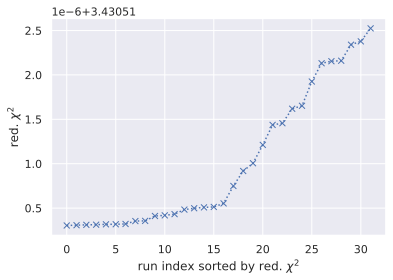

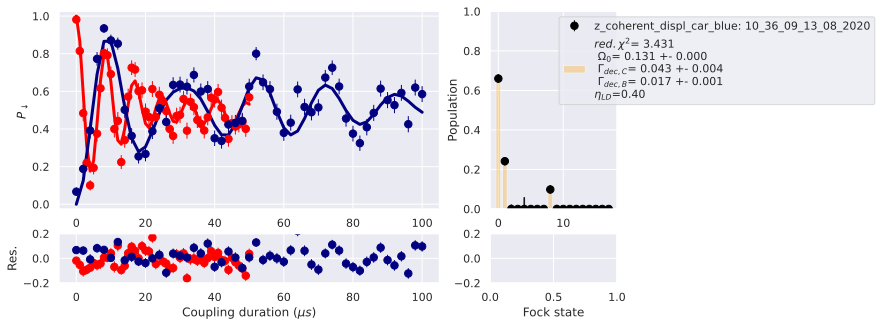

reduced chi square of best fit:  3.4305


In [47]:
# make waterfall plot
chi_list = [r[0][0] for r in res_lhs_coh]
plt.plot(range(n_lhs), sorted(chi_list), 'x:')
plt.ylabel(r'red. $\chi^2$')
plt.xlabel(r'run index sorted by red. $\chi^2$')
plt.plot()

# get best fit
idx = np.argmin(chi_list)
idy = np.argmax(chi_list)

paula.single_fit_sb_carr([file_coh],2, mode_freq=1.2974, mode_angle=0, Rabi_init=res_lhs_coh[idx][2][0], decc_init=res_lhs_coh[idx][2][1], decb_init=res_lhs_coh[idx][2][2], limc_init=res_lhs_coh[idx][2][3], limb_init=res_lhs_coh[idx][2][4], init_pops = res_lhs_coh[idx][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0])

print('reduced chi square of best fit: ', np.round(chi_list[idx],4))

z_coherent_displ_car_blue: 10_40_25_13_08_2020
first point of carrierflop (should be 1): 0.9519879573020843
first point of blueflop (should be 0): 0.06376181365661199
Free parameter count 7
migrad started at Thu Aug 13 11:31:05 2020
migrad finished at Thu Aug 13 11:31:24 2020


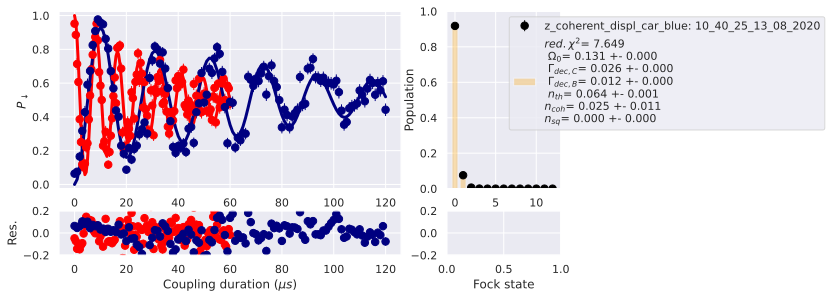

In [40]:
# paula.single_fit_sb_carr([file_sq],2, mode_freq=1.2974, mode_angle=0, Rabi_init=0.13, decc_init=0.038, decb_init=0.019, limc_init=0.5, limb_init=0.5, fock=True, nmax=18, fix=[0,0,0,0,0])
paula.single_fit_sb_carr([file_sq],2, mode_freq=1.2974, mode_angle=0, Rabi_init=0.13, decc_init=0.019, decb_init=0.019, limc_init=0.5, limb_init=0.5, fock=False, nmax=12,  nth=0.064, ncoh=0.0, nsq=0.5, fix=[0,0,0,0,0,1,0,0]);

In [42]:
n_lhs = 32
nmax = 18
lhs_list = np.transpose(np.array(lhs.sample(nmax, n_lhs)))

res_lhs_sq = Parallel(n_jobs=-1, verbose=51)(delayed(paula.single_fit_sb_carr)([file_sq],2, mode_freq=1.2974, mode_angle=0, Rabi_init=0.13, decc_init=0.038, decb_init=0.019, limc_init=0.5, limb_init=0.5, init_pops=init_lhs, fock=True, nmax=nmax, fix=[0,0,0,0,0]) for init_lhs in lhs_list)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  4.0min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  4.0min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  4.2min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  4.3min
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  5

z_coherent_displ_car_blue: 10_40_25_13_08_2020
first point of carrierflop (should be 1): 0.9519879573020843
first point of blueflop (should be 0): 0.06376181365661199
lamb dicke parameter: 0.3961
yo
[1.30665303e-01 3.78417725e-02 1.37889528e-02 5.07324792e-01
 5.00199268e-01 9.36925186e-01 3.90365587e-03 1.06429830e-16
 1.11751321e-15 2.66074575e-16 1.03380615e-12 3.15810253e-02
 9.25247726e-13 3.20353788e-14 1.27985786e-02 5.92814152e-14
 2.12859660e-16 3.04921463e-14 1.92561948e-10 1.47915542e-02
 6.97647535e-14 1.55919701e-14 3.45896947e-15]
my init pops
Free parameter count 23
migrad started at Thu Aug 13 11:44:58 2020
migrad finished at Thu Aug 13 11:45:53 2020


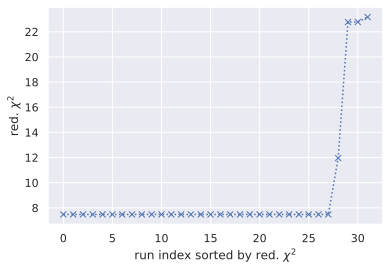

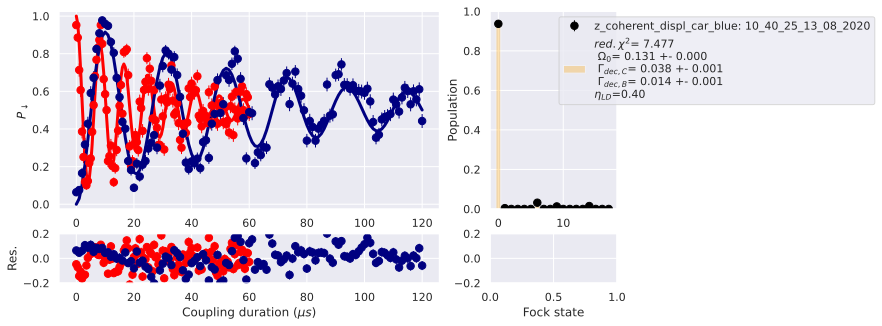

reduced chi square of best fit:  7.477


In [43]:
# make waterfall plot
chi_list = [r[0][0] for r in res_lhs_sq]
plt.plot(range(n_lhs), sorted(chi_list), 'x:')
plt.ylabel(r'red. $\chi^2$')
plt.xlabel(r'run index sorted by red. $\chi^2$')
plt.plot()

# get best fit
idx = np.argmin(chi_list)
idy = np.argmax(chi_list)

paula.single_fit_sb_carr([file_sq],2, mode_freq=1.2974, mode_angle=0, Rabi_init=res_lhs_sq[idx][2][0], decc_init=res_lhs_sq[idx][2][1], decb_init=res_lhs_sq[idx][2][2], limc_init=res_lhs_sq[idx][2][3], limb_init=res_lhs_sq[idx][2][4], init_pops = res_lhs_sq[idx][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0])

print('reduced chi square of best fit: ', np.round(chi_list[idx],4))

#### squeezing measurement

In [53]:
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/13/OC_Axial/z_coherent_displ_car_blue/'
fnames = os.listdir(direct)
files = sorted([direct+f for f in fnames])
files = select_files(files, [17,34,00], [17,41,00])

6 files


z_coherent_displ_car_blue: 17_34_27_13_08_2020
first point of carrierflop (should be 1): 0.7489658977130422
first point of blueflop (should be 0): 0.15836238760977872
Free parameter count 6
migrad started at Thu Aug 13 18:34:02 2020
migrad finished at Thu Aug 13 18:34:07 2020


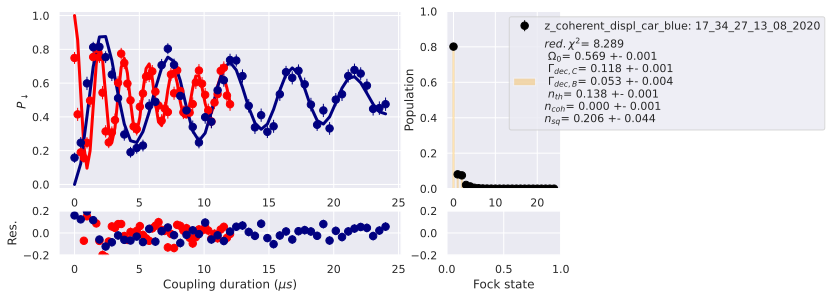

z_coherent_displ_car_blue: 17_35_39_13_08_2020
first point of carrierflop (should be 1): 0.7810489388908459
first point of blueflop (should be 0): 0.21890008950383838
Free parameter count 6
migrad started at Thu Aug 13 18:34:08 2020
migrad finished at Thu Aug 13 18:34:13 2020


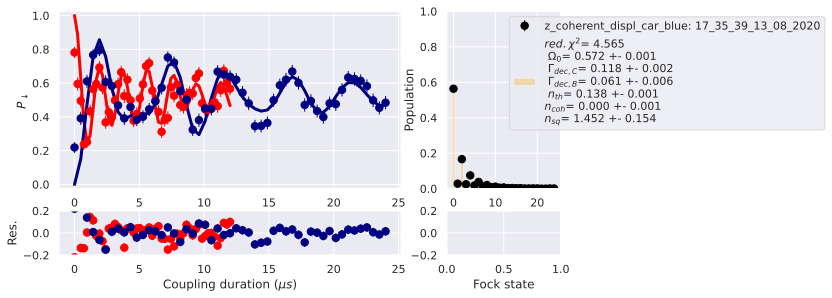

z_coherent_displ_car_blue: 17_36_51_13_08_2020
first point of carrierflop (should be 1): 0.7870878603627238
first point of blueflop (should be 0): 0.15245612690728266
Free parameter count 6
migrad started at Thu Aug 13 18:34:14 2020
migrad finished at Thu Aug 13 18:34:28 2020


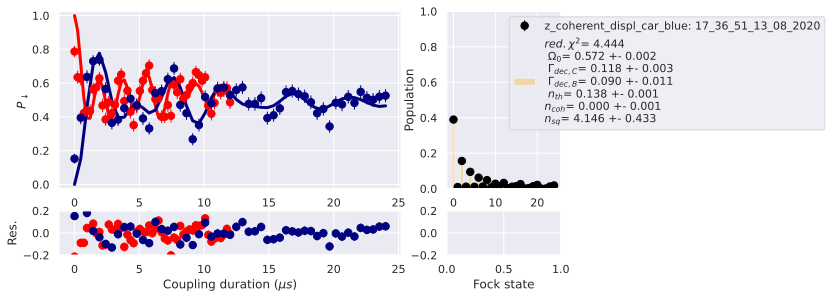

z_coherent_displ_car_blue: 17_38_04_13_08_2020
first point of carrierflop (should be 1): 0.8718859577157431
first point of blueflop (should be 0): 0.11260042296360873
Free parameter count 6
migrad started at Thu Aug 13 18:34:29 2020
migrad finished at Thu Aug 13 18:34:37 2020


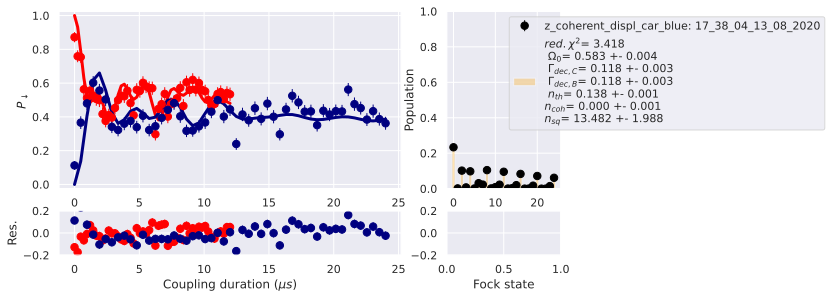

z_coherent_displ_car_blue: 17_39_16_13_08_2020
first point of carrierflop (should be 1): 0.918303759180678
first point of blueflop (should be 0): 0.0810411924277486
Free parameter count 6
migrad started at Thu Aug 13 18:34:38 2020
migrad finished at Thu Aug 13 18:34:50 2020


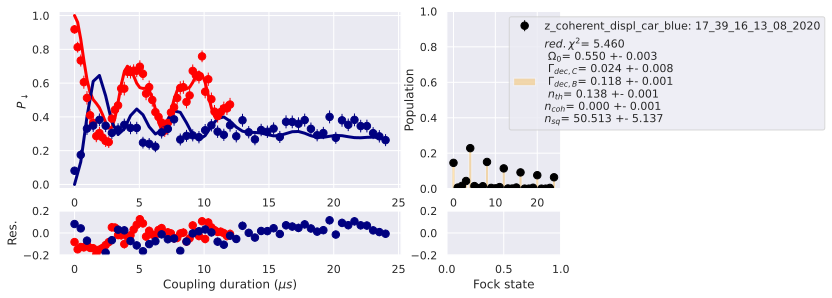

z_coherent_displ_car_blue: 17_40_29_13_08_2020
first point of carrierflop (should be 1): 0.9043060075606694
first point of blueflop (should be 0): 0.10456776540612517
Free parameter count 6
migrad started at Thu Aug 13 18:34:51 2020
migrad finished at Thu Aug 13 18:35:02 2020


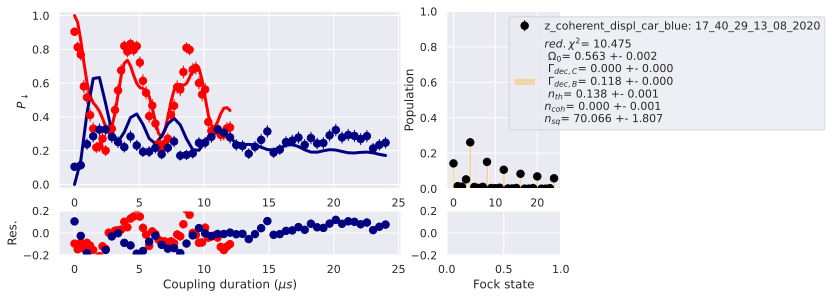

In [68]:
t_sq_list = np.linspace(0,10,6)

sq, sq_err = [], []
for file in files:
    rrr = paula.single_fit_sb_carr([file],2, mode_freq=1.2967, mode_angle=0, Rabi_init=0.588, decc_init=0.05, decb_init=0.05, limc_init=0.5, limb_init=0.5, fock=False, nmax=24,  nth=0.138, ncoh=0, nsq=0.2, fix=[0,0,0,0,0,1,1,0]);
    sq.append(rrr[2][-1])
    sq_err.append(rrr[3][-1])

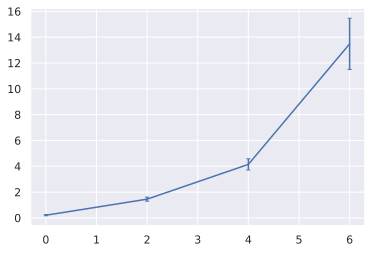

In [71]:
plt.errorbar(t_sq_list[:-2], sq[:-2], sq_err[:-2])
plt.show()

#### wigner function of coherent displaced state

In [83]:
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/13/OC_Axial/z_coherent_displ_car_blue/'
fnames = os.listdir(direct)
files = sorted([direct+f for f in fnames])
files = select_files(files, [17,53,00], [18,11,00])

8 files


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  3

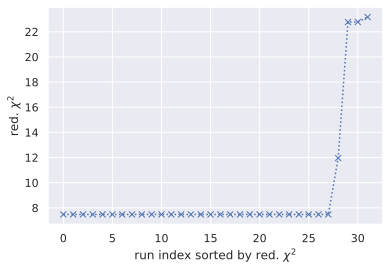

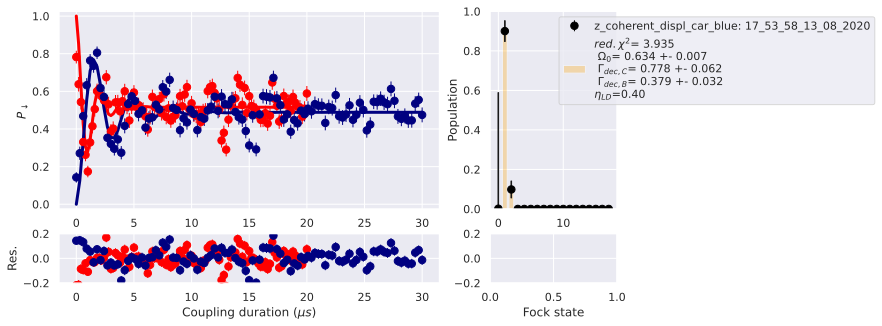

reduced chi square of best fit:  7.477
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.6min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.7min
[Parallel(n_jobs=

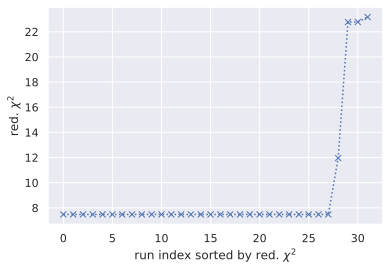

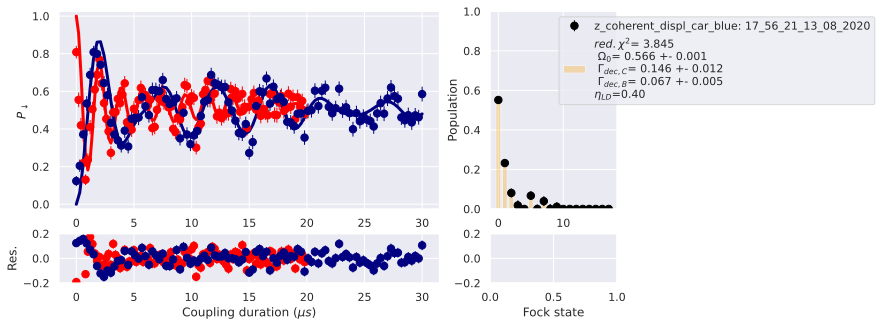

reduced chi square of best fit:  7.477
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  3.7min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.7min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.7min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  4.5min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  4.8min
[Parallel(n_jobs=

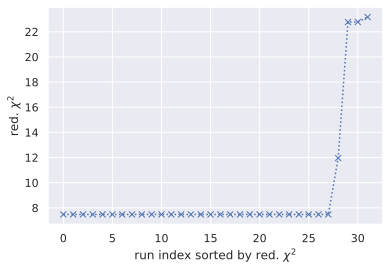

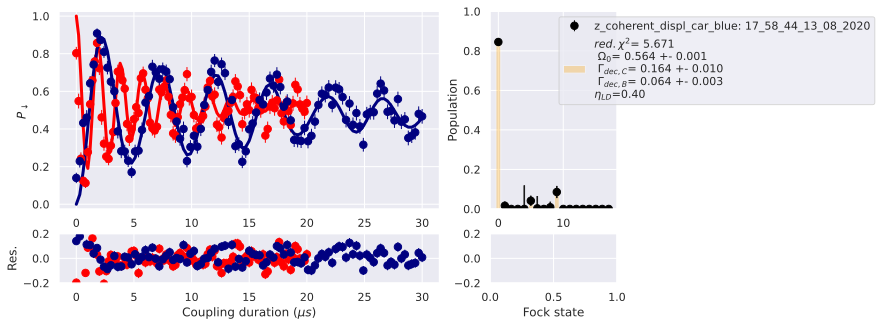

reduced chi square of best fit:  7.477
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.0min
[Parallel(n_jobs=

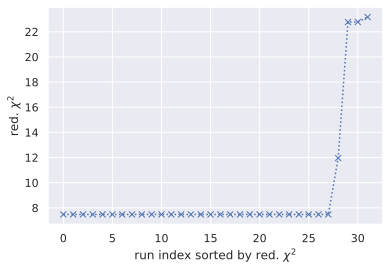

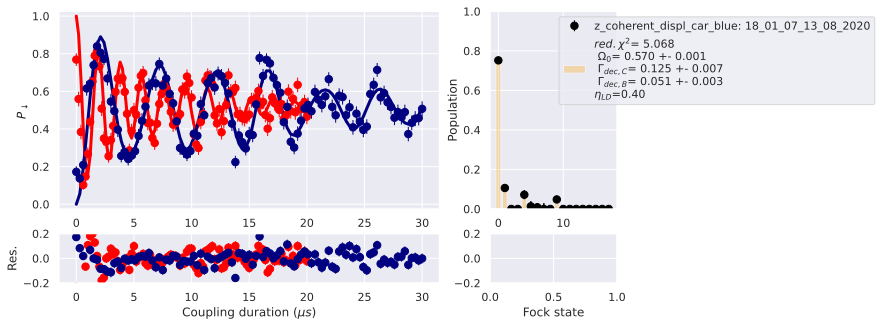

reduced chi square of best fit:  7.477
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  4.3min
[Parallel(n_jobs=

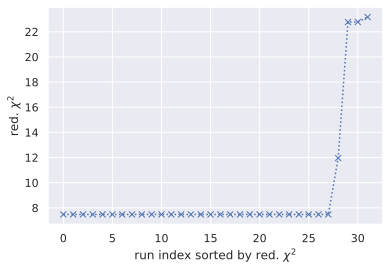

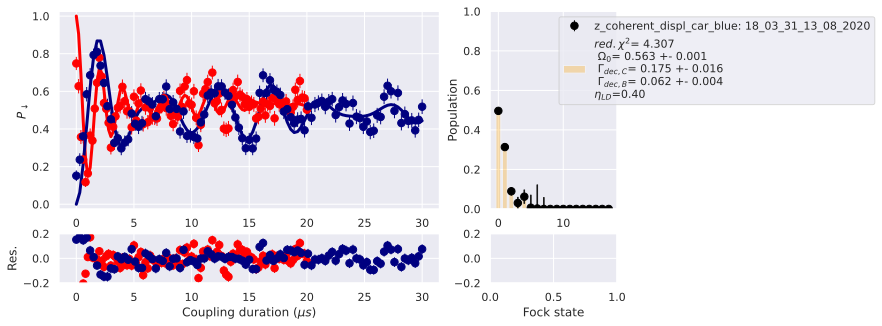

reduced chi square of best fit:  7.477
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.2min
[Parallel(n_jobs=

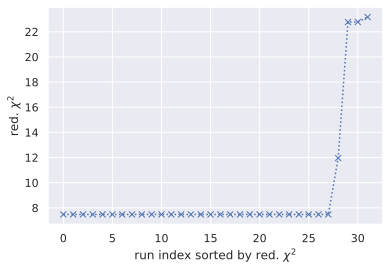

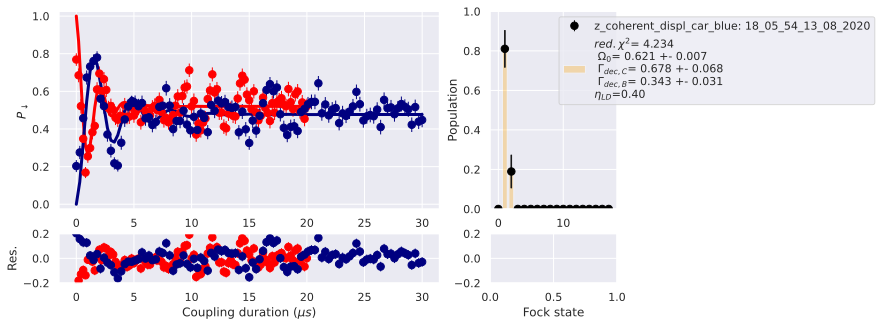

reduced chi square of best fit:  7.477
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.5min
[Parallel(n_jobs=

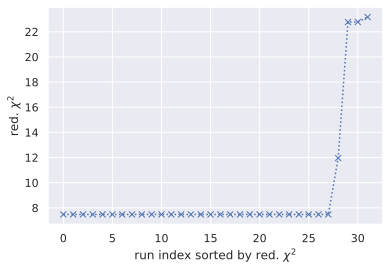

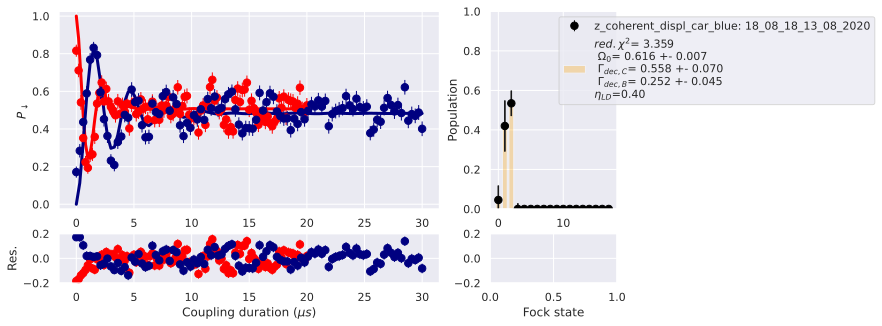

reduced chi square of best fit:  7.477
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.6min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.3min
[Parallel(n_jobs=

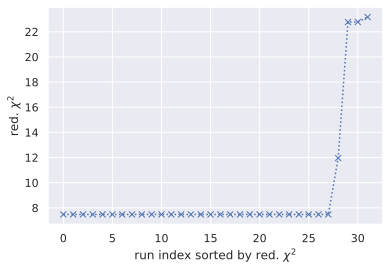

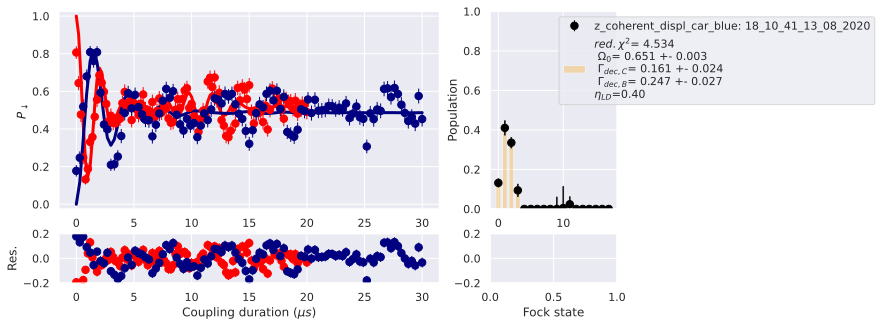

reduced chi square of best fit:  7.477


In [75]:
n_lhs = 32
nmax = 18

all_res = []
for file in files:
    # make initial values for fock states
    lhs_list = np.transpose(np.array(lhs.sample(nmax, n_lhs)))
    # fit it
    res = Parallel(n_jobs=-1, verbose=51)(delayed(paula.single_fit_sb_carr)([file],1.5, mode_freq=1.2967, mode_angle=0, Rabi_init=0.588, decc_init=0.05, decb_init=0.05, limc_init=0.5, limb_init=0.5, init_pops=init_lhs, fock=True, nmax=nmax, fix=[0,0,0,0,0]) for init_lhs in lhs_list)

    # make waterfall plot
    chi_list = [r[0][0] for r in res_lhs_sq]
    plt.plot(range(n_lhs), sorted(chi_list), 'x:')
    plt.ylabel(r'red. $\chi^2$')
    plt.xlabel(r'run index sorted by red. $\chi^2$')
    plt.plot()

    # get best fit
    idx = np.argmin(chi_list)
    all_res.append(res[idx])

    # get plot of best fit
    paula.single_fit_sb_carr([file],1.5, mode_freq=1.2967, mode_angle=0, Rabi_init=res[idx][2][0], decc_init=res[idx][2][1], decb_init=res[idx][2][2], limc_init=res[idx][2][3], limb_init=res[idx][2][4], init_pops = res[idx][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0])

    print('reduced chi square of best fit: ', np.round(chi_list[idx],4))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   20.1s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   26.9s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   27.6s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   28.7s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   29.2s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   30.2s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   42.2s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   42.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   46.4s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   56.6s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   59.3s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  1

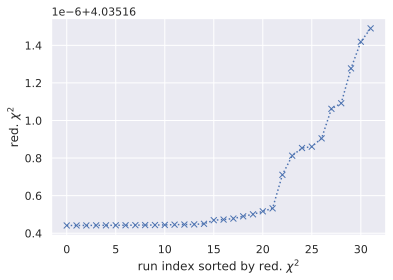

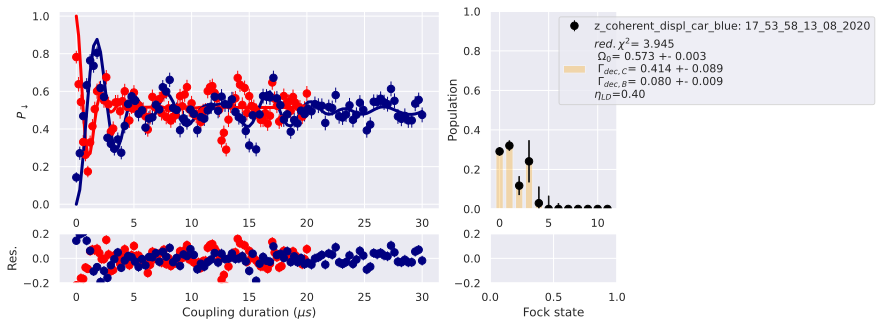

reduced chi square of best fit:  4.0352
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   26.1s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   26.7s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   33.0s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   36.5s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   53.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   55.8s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   58.0s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  1.4min
[Parallel(n_jobs

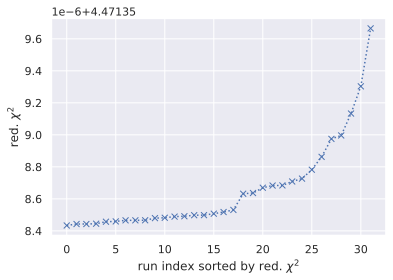

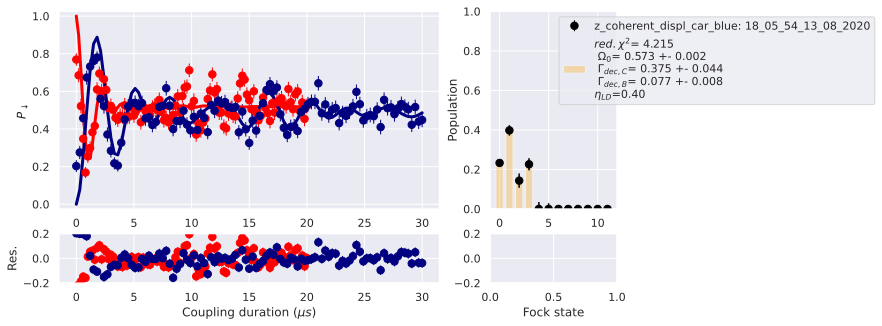

reduced chi square of best fit:  4.4714
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   23.2s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   24.8s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   25.9s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   27.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   29.9s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   31.0s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   31.2s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   32.4s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   50.5s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   54.8s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   57.5s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  1.2min
[Parallel(n_jobs

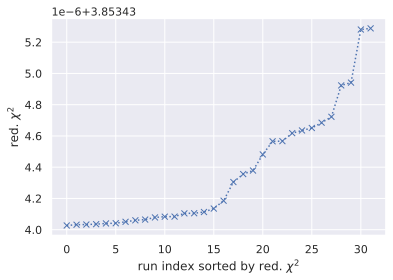

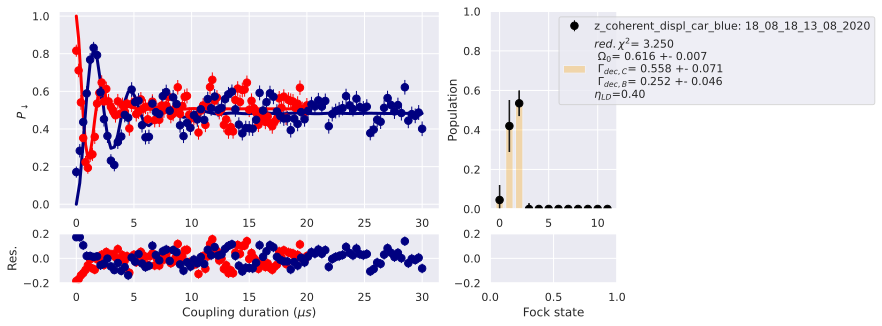

reduced chi square of best fit:  3.8534
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   20.1s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   27.4s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   28.7s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   29.0s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   31.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   33.1s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   34.1s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   45.9s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   53.5s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   55.1s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   56.8s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:   59.5s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:   60.0s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  1.1min
[Parallel(n_jobs

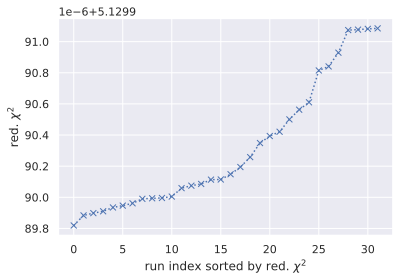

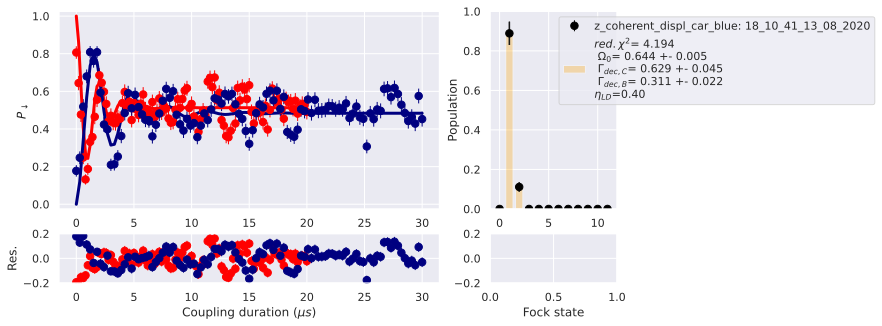

reduced chi square of best fit:  5.13


In [95]:
files_bad = np.append(files[0],files[-3:])

n_lhs = 32
nmax = 12

psi_P_0 = displace(nmax, 1)*thermal_dm(nmax, 0.1)*displace(nmax, 1).dag()
list_Pn = np.abs(np.diag(psi_P_0.full()))

all_res_bad = []
all_res_bad2 = []
for file in files_bad:
    # make initial values for fock states
    lhs_list = np.transpose(np.array(lhs.sample(nmax, n_lhs)))
    # fit it
    res = Parallel(n_jobs=-1, verbose=51)(delayed(paula.single_fit_sb_carr)([file],1.5, mode_freq=1.2967, mode_angle=0, Rabi_init=0.565, decc_init=0.153, decb_init=0.058, limc_init=0.5, limb_init=0.5, init_pops=list_Pn+init_lhs, fock=True, nmax=nmax, fix=[0,1,1,0,0]) for init_lhs in lhs_list)

    # make waterfall plot
    chi_list = [r[0][0] for r in res]
    plt.plot(range(n_lhs), sorted(chi_list), 'x:')
    plt.ylabel(r'red. $\chi^2$')
    plt.xlabel(r'run index sorted by red. $\chi^2$')
    plt.plot()

    # get best fit
    idx = np.argmin(chi_list)
    all_res_bad.append(res[idx])

    # get plot of best fit
    res2 = paula.single_fit_sb_carr([file],1.5, mode_freq=1.2967, mode_angle=0, Rabi_init=res[idx][2][0], decc_init=res[idx][2][1], decb_init=res[idx][2][2], limc_init=res[idx][2][3], limb_init=res[idx][2][4], init_pops = res[idx][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0])
    all_res_bad2.append(res2)
    print('reduced chi square of best fit: ', np.round(chi_list[idx],4))

z_coherent_displ_car_blue: 17_53_58_13_08_2020
first point of carrierflop (should be 1): 0.7820702146998051
first point of blueflop (should be 0): 0.1427035870200838
lamb dicke parameter: 0.3962
yo
[5.65000000e-01 1.53000000e-01 5.80000000e-02 5.00000000e-01
 5.00000000e-01 1.17564904e-01 2.29300143e-01 2.43974677e-01
 1.86926480e-01 1.15123631e-01 6.04175881e-02 2.79988883e-02
 1.17452687e-02 4.50604494e-03 1.67144607e-03 4.79114111e-04
 2.91815507e-04]
my init pops
Free parameter count 17
migrad started at Fri Aug 14 13:34:00 2020
migrad finished at Fri Aug 14 13:34:40 2020


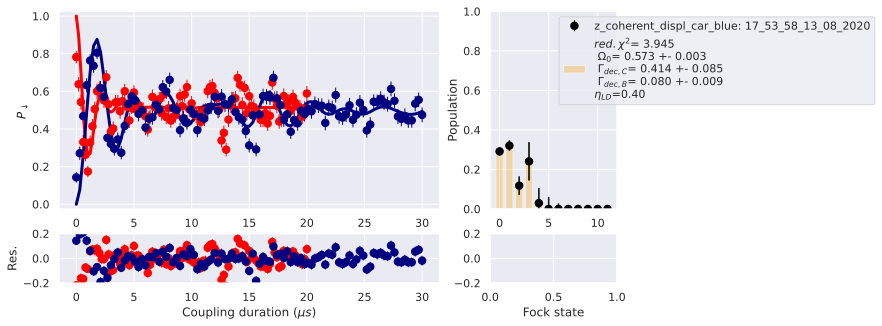

reduced chi square of best fit:  5.13
z_coherent_displ_car_blue: 18_05_54_13_08_2020
first point of carrierflop (should be 1): 0.769013866781465
first point of blueflop (should be 0): 0.20275972462917274
lamb dicke parameter: 0.3962
yo
[5.65000000e-01 1.53000000e-01 5.80000000e-02 5.00000000e-01
 5.00000000e-01 1.17564904e-01 2.29300143e-01 2.43974677e-01
 1.86926480e-01 1.15123631e-01 6.04175881e-02 2.79988883e-02
 1.17452687e-02 4.50604494e-03 1.67144607e-03 4.79114111e-04
 2.91815507e-04]
my init pops
Free parameter count 17
migrad started at Fri Aug 14 13:34:40 2020
migrad finished at Fri Aug 14 13:35:19 2020


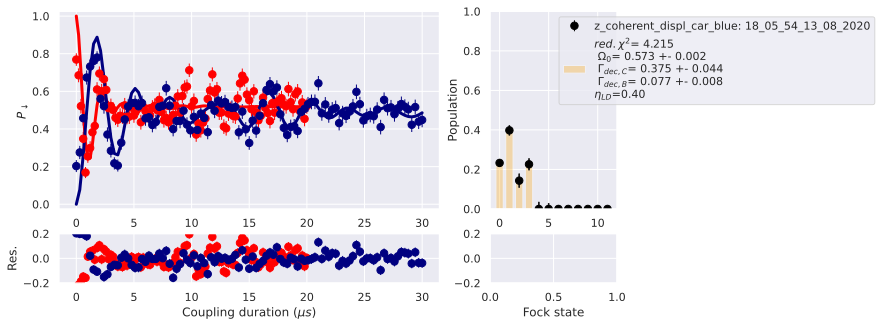

reduced chi square of best fit:  5.13
z_coherent_displ_car_blue: 18_08_18_13_08_2020
first point of carrierflop (should be 1): 0.8160302157006055
first point of blueflop (should be 0): 0.17091712282063942
lamb dicke parameter: 0.3962
yo
[5.65000000e-01 1.53000000e-01 5.80000000e-02 5.00000000e-01
 5.00000000e-01 1.17564904e-01 2.29300143e-01 2.43974677e-01
 1.86926480e-01 1.15123631e-01 6.04175881e-02 2.79988883e-02
 1.17452687e-02 4.50604494e-03 1.67144607e-03 4.79114111e-04
 2.91815507e-04]
my init pops
Free parameter count 17
migrad started at Fri Aug 14 13:35:20 2020
migrad finished at Fri Aug 14 13:36:07 2020


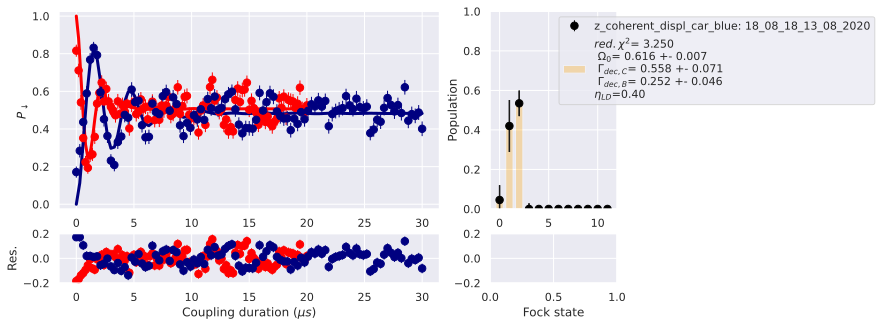

reduced chi square of best fit:  5.13
z_coherent_displ_car_blue: 18_10_41_13_08_2020
first point of carrierflop (should be 1): 0.8063788389995468
first point of blueflop (should be 0): 0.17742713787648273
lamb dicke parameter: 0.3962
yo
[5.65000000e-01 1.53000000e-01 5.80000000e-02 5.00000000e-01
 5.00000000e-01 1.17564904e-01 2.29300143e-01 2.43974677e-01
 1.86926480e-01 1.15123631e-01 6.04175881e-02 2.79988883e-02
 1.17452687e-02 4.50604494e-03 1.67144607e-03 4.79114111e-04
 2.91815507e-04]
my init pops
Free parameter count 17
migrad started at Fri Aug 14 13:36:08 2020
migrad finished at Fri Aug 14 13:36:42 2020


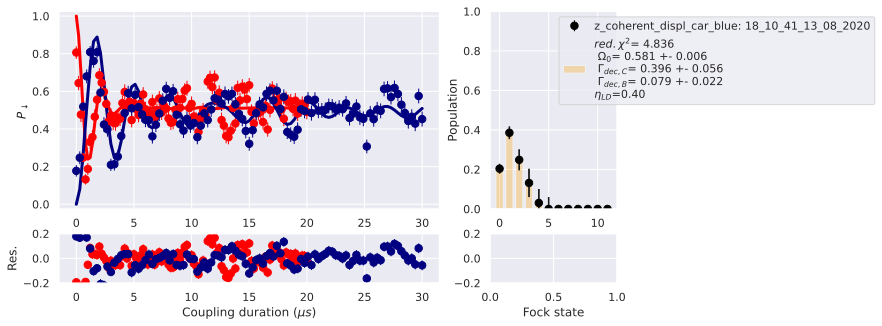

reduced chi square of best fit:  5.13


In [97]:
files_bad = np.append(files[0],files[-3:])

n_lhs = 32
nmax = 12

psi_P_0 = displace(nmax, 1.5)*thermal_dm(nmax, 0.1)*displace(nmax, 1.5).dag()
list_Pn = np.abs(np.diag(psi_P_0.full()))

all_res_bad = []
all_res_bad2 = []
all_res_bad3 = []
for file in files_bad:
    # get plot of best fit
    res2 = paula.single_fit_sb_carr([file],1.5, mode_freq=1.2967, mode_angle=0, Rabi_init=0.565, decc_init=0.153, decb_init=0.058, limc_init=0.5, limb_init=0.5, init_pops=list_Pn, fock=True, nmax=nmax, fix=[0,0,0,0,0])
    all_res_bad3.append(res2)

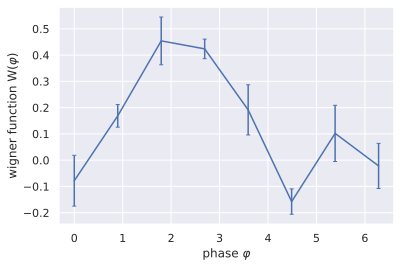

In [99]:
res_for_w = [all_res_bad3[0],all_res[1],all_res[2],all_res[3],all_res[4],all_res_bad3[1],all_res_bad3[2],all_res_bad3[3]]

w_list = np.transpose(get_W_from_focks(res_for_w, fit_fock=1, n_dim=[18,18,18,18,18,18,18,18]))

plt.errorbar(np.linspace(0,2*np.pi,8), w_list[0], w_list[1], fmt='o')
plt.xlabel(r'phase $\varphi$')
plt.ylabel(r'wigner function W($\varphi$)')

plt.show()

In [ ]:
# plot it
def gauß_2pi(x, A, C, mu, sig):
#     d2 = np.min([(x-mu)**2, (x-2*np.pi-mu)**2])
    return(A/(sig*np.sqrt(2*np.pi))*np.exp(-0.5*(x-mu)**2/sig**2) + C)

x = np.linspace(0,2*np.pi,8)
xx = np.linspace(0, 2*np.pi, 100)

from scipy.optimize import curve_fit
params, _ = curve_fit(gauß_2pi,x,w_list[0], [0.5, 0, 2, 1])
print(params)

plt.errorbar(x, w_list[0], w_list[1], fmt='x')
# plt.ylim(-.7,.7)

yy = [gauß_2pi(xxx, *params) for xxx in xx]
plt.plot(xx, yy)

plt.xlabel(r'$|\phi|$')
plt.ylabel(r'Wigner fct. $ W(|\phi|)$')
# plt.xlabel(r'$|\alpha|$')
# plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.show()

# gauß_2pi(xx, *params)

### wigner function of coherent state over phase

In [144]:
# calibration measurement
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue_single/'
fnames = os.listdir(direct)
files = sorted([direct+f for f in fnames])
files = select_files(files, [15,45,00], [16,00,00])

6 files


z_coherent_displ_car_blue_single: 15_45_57_14_08_2020
first point of carrierflop (should be 1): 0.9307376819163495
first point of blueflop (should be 0): 0.057207939130314134
Free parameter count 6
migrad started at Fri Aug 14 16:17:13 2020
migrad finished at Fri Aug 14 16:17:20 2020


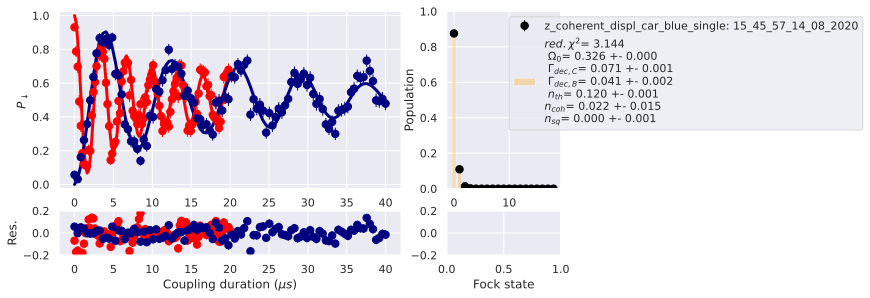

z_coherent_displ_car_blue_single: 15_48_35_14_08_2020
first point of carrierflop (should be 1): 0.8693147898106697
first point of blueflop (should be 0): 0.07011726892688391
Free parameter count 6
migrad started at Fri Aug 14 16:17:21 2020
migrad finished at Fri Aug 14 16:17:27 2020


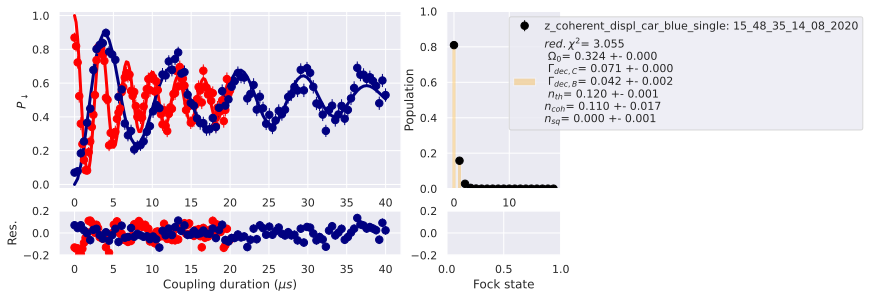

z_coherent_displ_car_blue_single: 15_51_14_14_08_2020
first point of carrierflop (should be 1): 0.894783001764602
first point of blueflop (should be 0): 0.08804302485829801
Free parameter count 6
migrad started at Fri Aug 14 16:17:28 2020
migrad finished at Fri Aug 14 16:17:35 2020


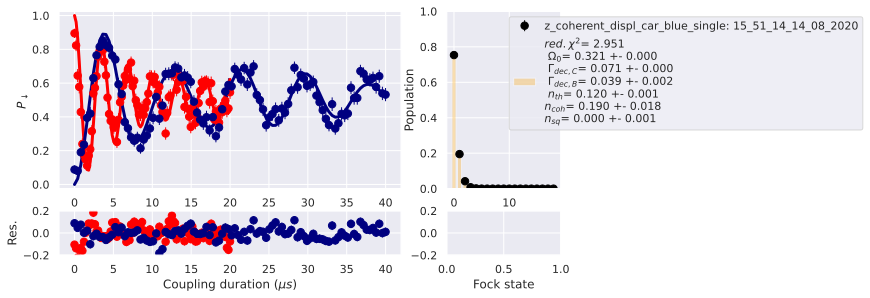

z_coherent_displ_car_blue_single: 15_53_52_14_08_2020
first point of carrierflop (should be 1): 0.9283420894036355
first point of blueflop (should be 0): 0.07050500134533777
Free parameter count 6
migrad started at Fri Aug 14 16:17:35 2020
migrad finished at Fri Aug 14 16:17:44 2020


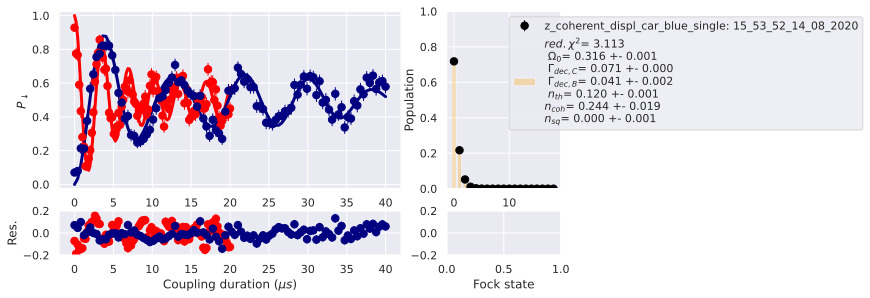

z_coherent_displ_car_blue_single: 15_56_31_14_08_2020
first point of carrierflop (should be 1): 0.9673592756768811
first point of blueflop (should be 0): 0.05657386702622008
Free parameter count 6
migrad started at Fri Aug 14 16:17:45 2020
migrad finished at Fri Aug 14 16:17:53 2020


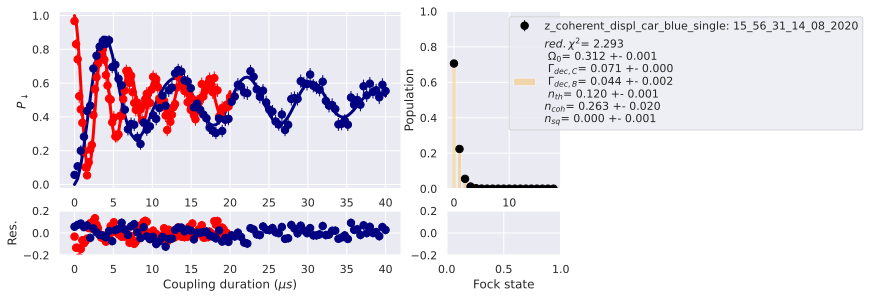

z_coherent_displ_car_blue_single: 15_59_09_14_08_2020
first point of carrierflop (should be 1): 0.9351970646487154
first point of blueflop (should be 0): 0.045640909460064105
Free parameter count 6
migrad started at Fri Aug 14 16:17:54 2020
migrad finished at Fri Aug 14 16:18:02 2020


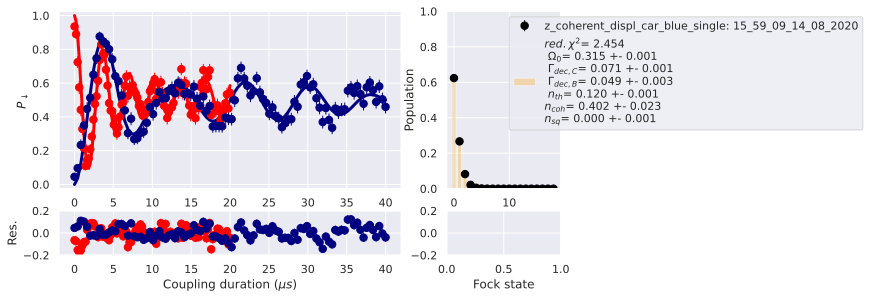

In [146]:
t_coh_list = np.linspace(0,1.25,6)

coh, coh_err = [], []
for file in files:
    rrr = paula.single_fit_sb_carr([file],2, mode_freq=1.2968, mode_angle=0, Rabi_init=0.355, decc_init=0.07, decb_init=0.048, limc_init=0.5, limb_init=0.5, fock=False, nmax=18,  nth=0.12, ncoh=0., nsq=0.0, fix=[0,0,0,0,0,1,0,1]);
    coh.append(rrr[2][-2])
    coh_err.append(rrr[3][-2])

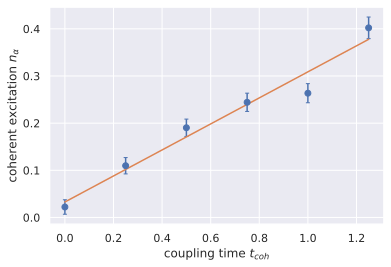

fit function: a x + b: a =  0.276 b =  0.0328
t_dec = 0.5 equivalent to n_coh = 0.1708 (and alpha = 0.4133 )
t_dec = 1 equivalent to n_coh = 0.3088 (and alpha = 0.5557 )


In [196]:
def func_lin(x, a, b):
    return a*x + b

params, _ = curve_fit(func_lin, t_coh_list, coh)

plt.errorbar(t_coh_list, coh, coh_err, fmt='o')
plt.plot(t_coh_list, func_lin(t_coh_list, *params))
plt.xlabel('coupling time $t_{coh}$')
plt.ylabel(r'coherent excitation $n_{\alpha}$')
plt.show()

n_alpha = func_lin(0.5, *params)
n_alpha2 = func_lin(1, *params)

print('fit function: a x + b: a = ', np.round(params[0],4), 'b = ', np.round(params[1],4))
print('t_dec = 0.5 equivalent to n_coh =', np.round(n_alpha, 4), '(and alpha =', np.round(np.sqrt(n_alpha), 4), ')')
print('t_dec = 1 equivalent to n_coh =', np.round(n_alpha2, 4), '(and alpha =', np.round(np.sqrt(n_alpha2), 4), ')')

In [152]:
# np.savez('data/2020-08-14_coh_calibration',[t_coh_list, coh, coh_err])

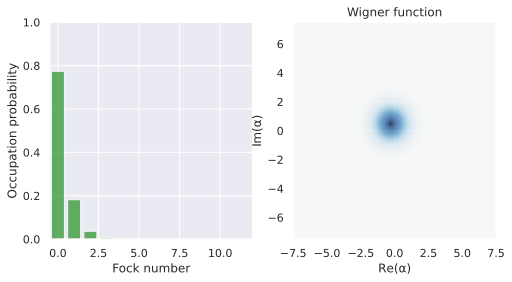

In [184]:
psi = displace(12, 0.4*np.exp(2.0825j)) * thermal_dm(12,0.12) * displace(12, 0.4*np.exp(2.0825j)).dag()
plot_wigner_fock_distribution(psi)
plt.show()

In [29]:
# measurement W(phi)
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/'
fnames = os.listdir(direct)
files = sorted([direct+f for f in fnames])
files = select_files(files, [12,44,00], [13,27,00])
files

17 files


['/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/12_44_58_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/12_47_36_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/12_50_13_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/12_52_51_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/12_55_28_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/12_58_06_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/13_00_43_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/13_03_20_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/13_05_58_14_08_202

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.7min remaining:  5.0min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.8min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.9min remaining:  1.9min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.1min remaining:  1.2min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.1min remaining:   41.1s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.1min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.1min finished
z_coherent_displ_car_blue: 12_44_58_14_08_2020
first point of carrierflop (should be 1): 0.9461768808822213
first point of blueflop (should be 0): 0.09395759510994989
lamb dicke parameter: 0.3963
yo
[3.38202269e-01 1.12187630e-01 5.22440652e-02 5.15580596e-01
 5.17916830e-01 5.78399605e-01 3.23063374e-01

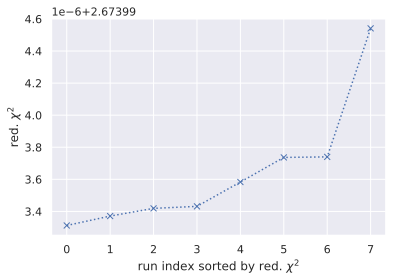

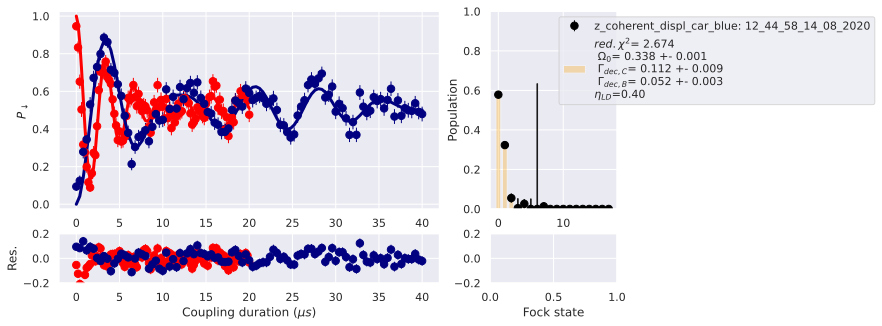

reduced chi square of best fit:  2.674
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.6min remaining:  4.9min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.8min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.9min remaining:  1.9min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.2min remaining:  1.3min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.3min remaining:   46.1s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.0min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.0min finished
z_coherent_displ_car_blue: 12_47_36_14_08_2020
first point of carrierflop (should be 1): 0.8775739472539694
first point of blueflop (should be 0): 0.10913824673639311
lamb dicke parameter: 0.3963
yo
[3.41489624e-01 1.08118319e-01 5.04046548e-02 5.25330583e-01
 4.902

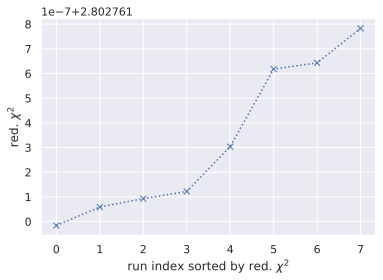

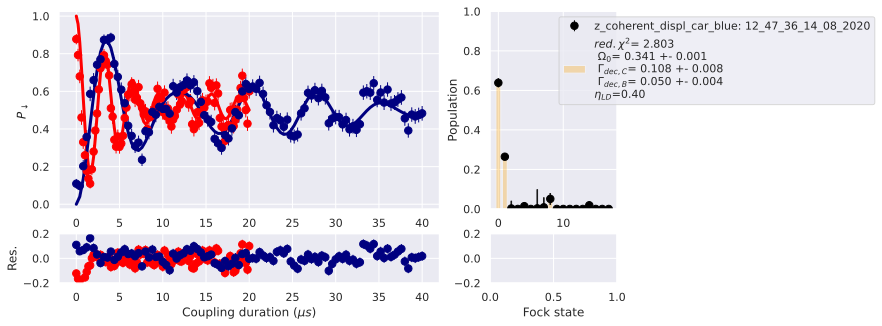

reduced chi square of best fit:  2.8028
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.6min remaining:  4.7min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.8min remaining:  3.0min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.8min remaining:  1.8min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  1.9min remaining:  1.1min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.0min remaining:   39.9s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.3min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.3min finished
z_coherent_displ_car_blue: 12_50_13_14_08_2020
first point of carrierflop (should be 1): 0.9176045001231456
first point of blueflop (should be 0): 0.06139286713894132
lamb dicke parameter: 0.3963
yo
[3.47226297e-01 9.50369241e-02 5.45799859e-02 5.32776803e-01
 4.92

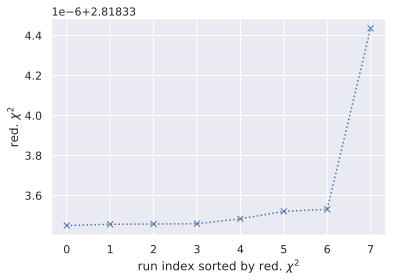

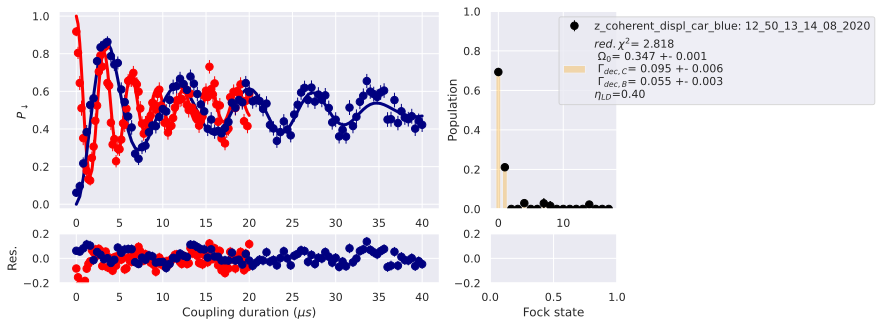

reduced chi square of best fit:  2.8183
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.5min remaining:  4.6min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.6min remaining:  2.6min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.6min remaining:  1.6min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  1.6min remaining:   57.8s
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  1.9min remaining:   37.6s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.2min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.2min finished
z_coherent_displ_car_blue: 12_52_51_14_08_2020
first point of carrierflop (should be 1): 0.8355518388809211
first point of blueflop (should be 0): 0.11068301831143895
lamb dicke parameter: 0.3963
yo
[3.43708275e-01 9.33051117e-02 4.84298899e-02 5.34444759e-01
 5.11

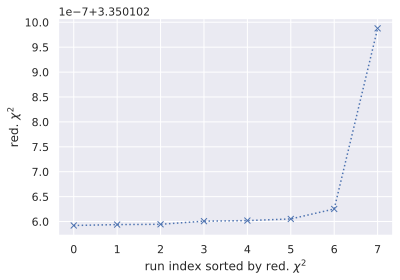

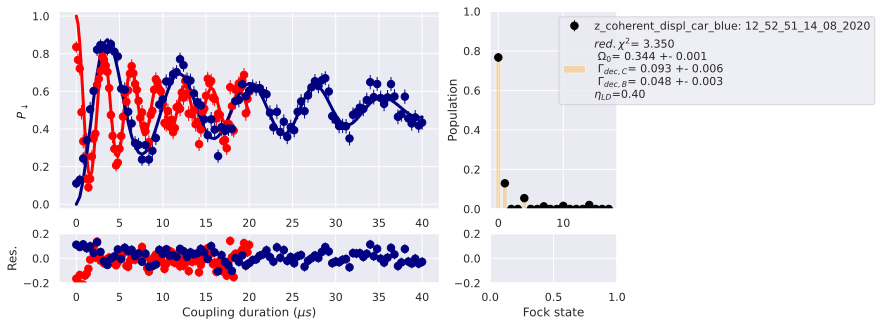

reduced chi square of best fit:  3.3501
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.6min remaining:  4.8min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.7min remaining:  2.8min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.7min remaining:  1.7min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  1.7min remaining:  1.0min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  1.8min remaining:   35.7s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.3min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.3min finished
z_coherent_displ_car_blue: 12_55_28_14_08_2020
first point of carrierflop (should be 1): 0.9158328005932606
first point of blueflop (should be 0): 0.17345412810653887
lamb dicke parameter: 0.3963
yo
[3.41418230e-01 9.28656940e-02 4.51939339e-02 5.00589504e-01
 5.22

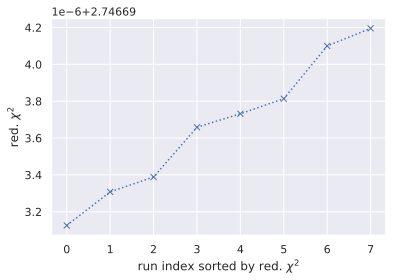

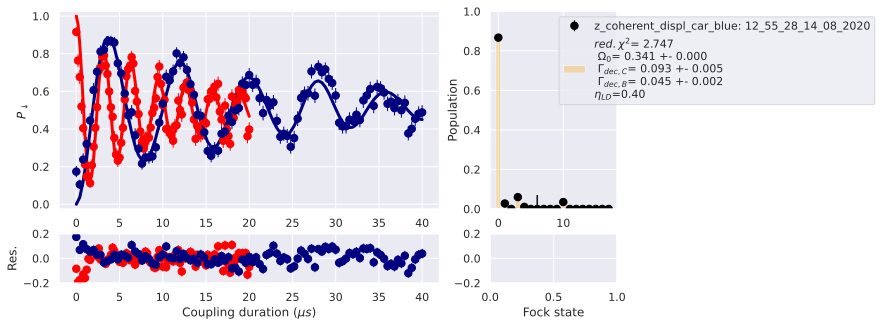

reduced chi square of best fit:  2.7467
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   50.6s
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.5min remaining:  4.4min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.5min remaining:  2.5min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.6min remaining:  1.6min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  1.7min remaining:  1.0min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  1.7min remaining:   34.1s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.9min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.9min finished
z_coherent_displ_car_blue: 12_58_06_14_08_2020
first point of carrierflop (should be 1): 0.856713435647239
first point of blueflop (should be 0): 0.10002876549957113
lamb dicke parameter: 0.3963
yo
[3.44125259e-01 8.44866967e-02 4.56987314e-02 5.57685239e-01
 4.874

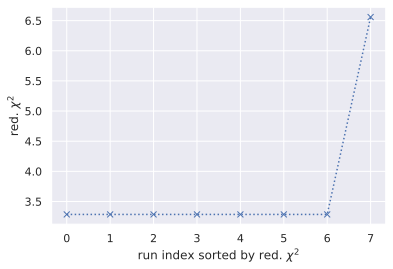

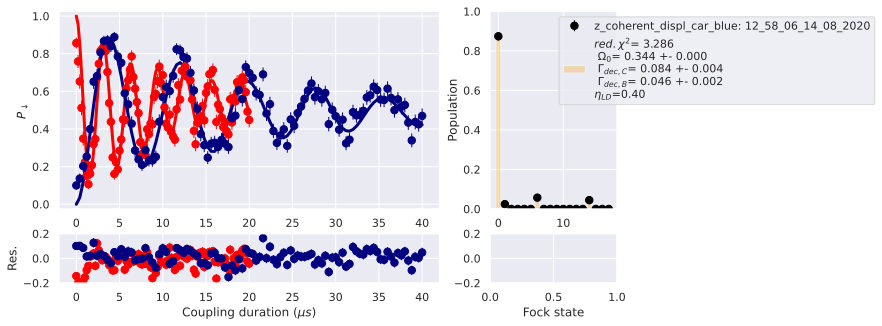

reduced chi square of best fit:  3.2859
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.6min remaining:  4.9min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.7min remaining:  2.8min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.8min remaining:  1.8min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.1min remaining:  1.2min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.1min remaining:   42.9s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.7min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.7min finished
z_coherent_displ_car_blue: 13_00_43_14_08_2020
first point of carrierflop (should be 1): 0.878489980402169
first point of blueflop (should be 0): 0.07401171952377378
lamb dicke parameter: 0.3963
yo
[3.44511249e-01 1.01158427e-01 5.19421978e-02 5.34390884e-01
 5.111

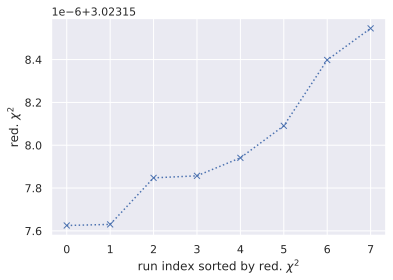

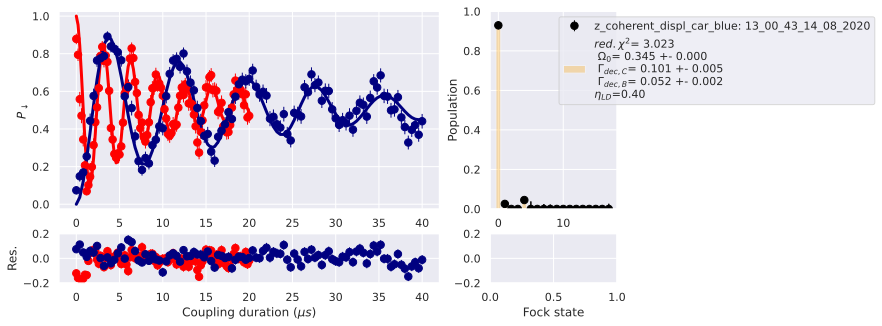

reduced chi square of best fit:  3.0232
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.5min remaining:  4.5min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.5min remaining:  2.5min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  2.0min remaining:  2.0min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.1min remaining:  1.3min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.2min remaining:   44.4s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  5.1min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  5.1min finished
z_coherent_displ_car_blue: 13_03_20_14_08_2020
first point of carrierflop (should be 1): 0.8884646386901383
first point of blueflop (should be 0): 0.09665025172652358
lamb dicke parameter: 0.3963
yo
[3.45023592e-01 8.92549554e-02 4.47238509e-02 5.18678354e-01
 5.16

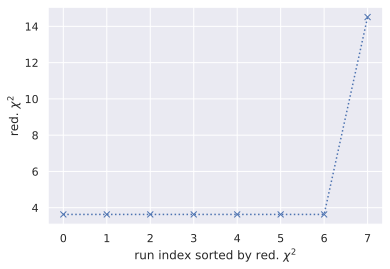

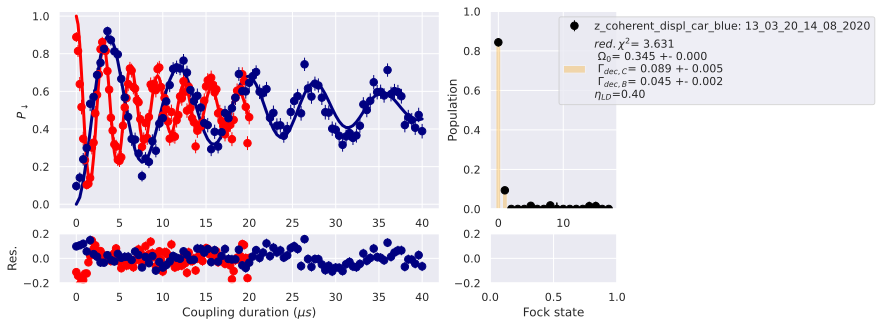

reduced chi square of best fit:  3.6312
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.7min remaining:  5.0min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.9min remaining:  3.1min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.9min remaining:  1.9min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.0min remaining:  1.2min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.1min remaining:   41.9s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.5min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.5min finished
z_coherent_displ_car_blue: 13_05_58_14_08_2020
first point of carrierflop (should be 1): 0.9006504128699462
first point of blueflop (should be 0): 0.07825950776835361
lamb dicke parameter: 0.3963
yo
[3.46831059e-01 8.50855138e-02 5.03049336e-02 5.35181846e-01
 5.15

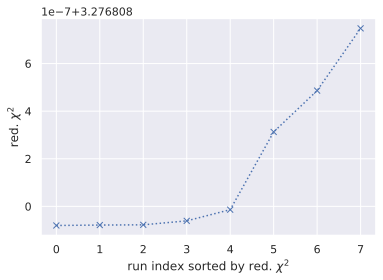

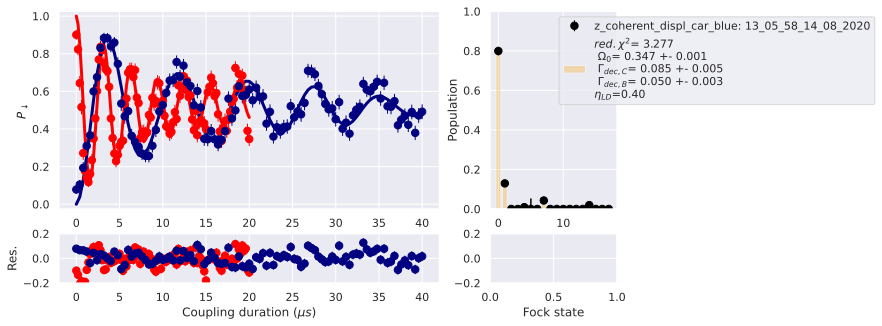

reduced chi square of best fit:  3.2768
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   47.3s
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.7min remaining:  5.1min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.8min remaining:  3.0min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  2.0min remaining:  2.0min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.3min remaining:  1.4min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.6min remaining:   51.6s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.5min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.5min finished
z_coherent_displ_car_blue: 13_08_35_14_08_2020
first point of carrierflop (should be 1): 0.8935239234245264
first point of blueflop (should be 0): 0.07053463433894569
lamb dicke parameter: 0.3963
yo
[3.46826510e-01 9.51993247e-02 4.96134075e-02 5.38265901e-01
 5.09

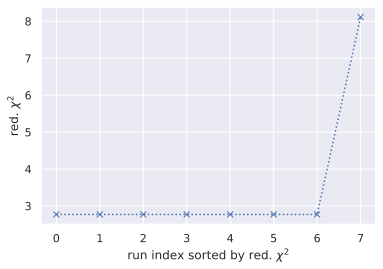

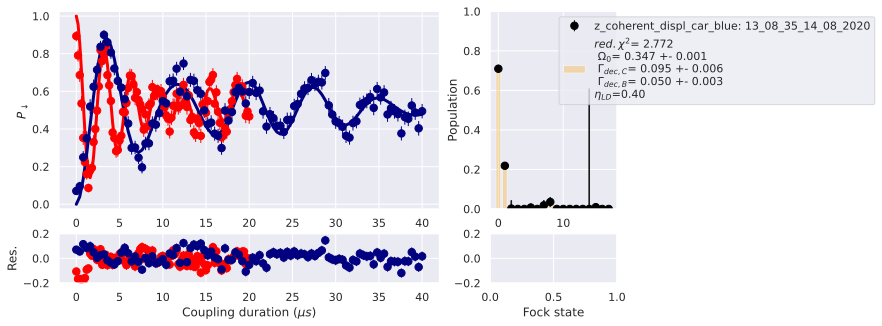

reduced chi square of best fit:  2.772
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.7min remaining:  5.1min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.8min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  2.0min remaining:  2.0min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.1min remaining:  1.3min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.5min remaining:   50.1s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.8min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.8min finished
z_coherent_displ_car_blue: 13_11_13_14_08_2020
first point of carrierflop (should be 1): 0.8918333846867349
first point of blueflop (should be 0): 0.0778783703504154
lamb dicke parameter: 0.3963
yo
[3.45009857e-01 9.27238607e-02 5.00986625e-02 5.27289526e-01
 5.2042

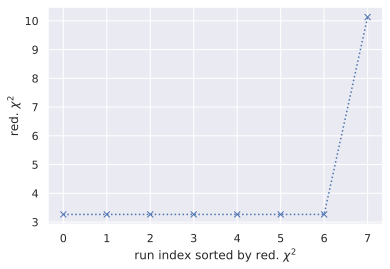

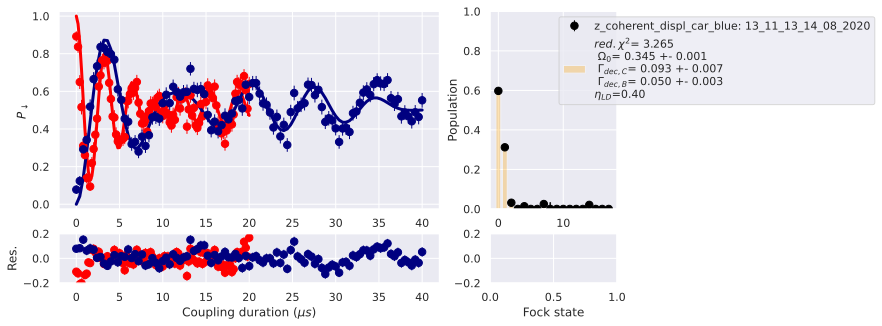

reduced chi square of best fit:  3.2646
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.6min remaining:  4.8min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.6min remaining:  2.7min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.7min remaining:  1.7min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  1.9min remaining:  1.1min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.2min remaining:   44.5s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.6min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.6min finished
z_coherent_displ_car_blue: 13_13_50_14_08_2020
first point of carrierflop (should be 1): 0.8743302985789405
first point of blueflop (should be 0): 0.10971681331864874
lamb dicke parameter: 0.3963
yo
[3.48988048e-01 1.18805902e-01 5.44615384e-02 5.25759258e-01
 5.26

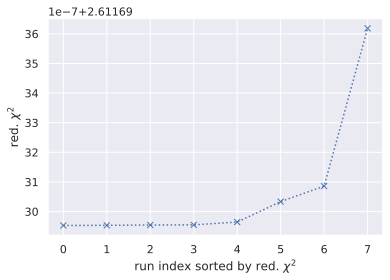

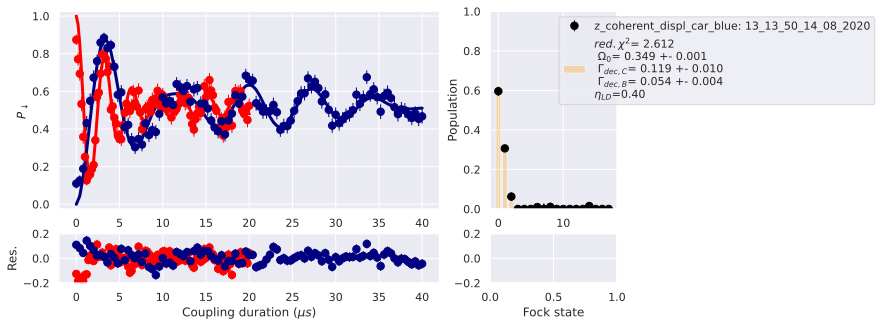

reduced chi square of best fit:  2.6117
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.7min remaining:  5.0min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.7min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.9min remaining:  1.9min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.1min remaining:  1.2min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.1min remaining:   42.3s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.0min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.0min finished
z_coherent_displ_car_blue: 13_16_28_14_08_2020
first point of carrierflop (should be 1): 0.8759688860925906
first point of blueflop (should be 0): 0.07126329785418273
lamb dicke parameter: 0.3963
yo
[3.45189289e-01 8.74073681e-02 5.28145774e-02 5.29616615e-01
 5.06

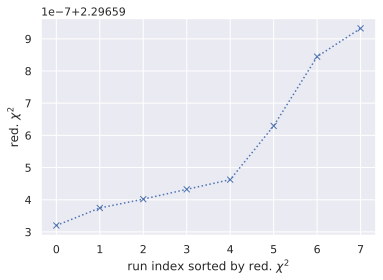

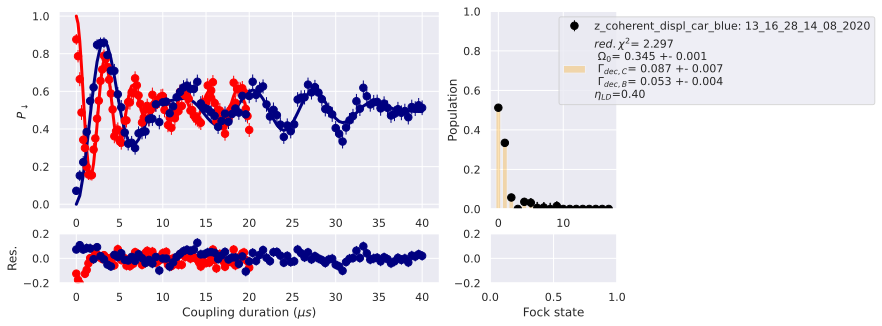

reduced chi square of best fit:  2.2966
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.6min remaining:  4.7min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.7min remaining:  2.8min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.7min remaining:  1.7min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  1.9min remaining:  1.1min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.4min remaining:   48.8s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.1min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  3.1min finished
z_coherent_displ_car_blue: 13_19_06_14_08_2020
first point of carrierflop (should be 1): 0.8684795610188399
first point of blueflop (should be 0): 0.1008426558607271
lamb dicke parameter: 0.3963
yo
[3.47448274e-01 9.50664349e-02 5.14330589e-02 5.37885698e-01
 5.120

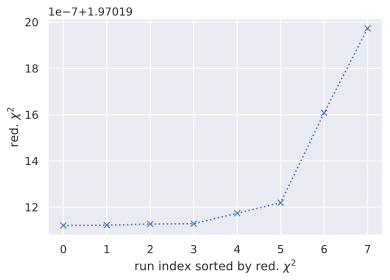

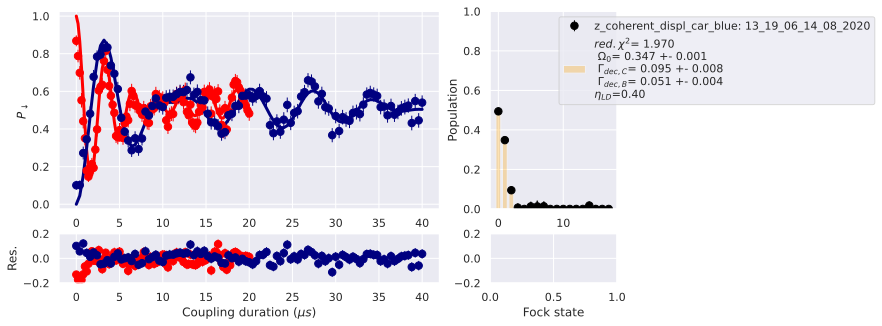

reduced chi square of best fit:  1.9702
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.5min remaining:  4.4min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.7min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.8min remaining:  1.8min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  1.8min remaining:  1.1min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  1.9min remaining:   37.4s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.3min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.3min finished
z_coherent_displ_car_blue: 13_21_43_14_08_2020
first point of carrierflop (should be 1): 0.892694538630036
first point of blueflop (should be 0): 0.06386450304347785
lamb dicke parameter: 0.3963
yo
[3.44728726e-01 9.94111857e-02 5.22673187e-02 5.42773643e-01
 5.010

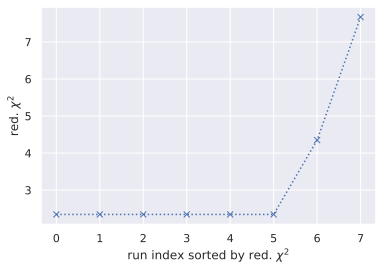

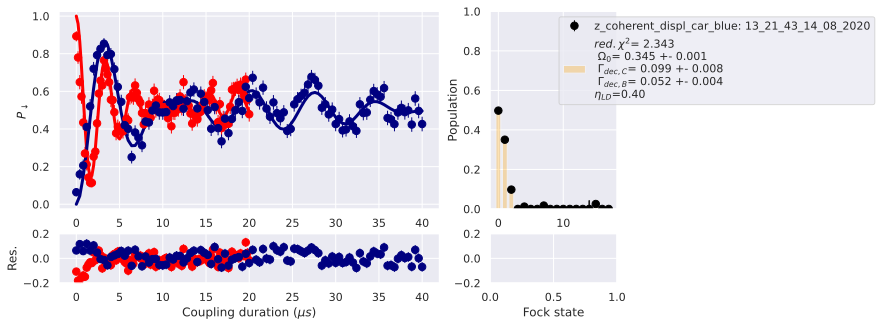

reduced chi square of best fit:  2.3433
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.7min remaining:  5.2min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.9min remaining:  3.1min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  2.1min remaining:  2.1min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.2min remaining:  1.3min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.3min remaining:   45.3s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.6min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.6min finished
z_coherent_displ_car_blue: 13_24_21_14_08_2020
first point of carrierflop (should be 1): 0.8918416566488625
first point of blueflop (should be 0): 0.06295389925175926
lamb dicke parameter: 0.3963
yo
[3.44048651e-01 1.01367366e-01 6.26186203e-02 5.23893269e-01
 5.20

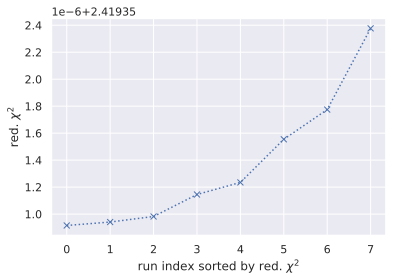

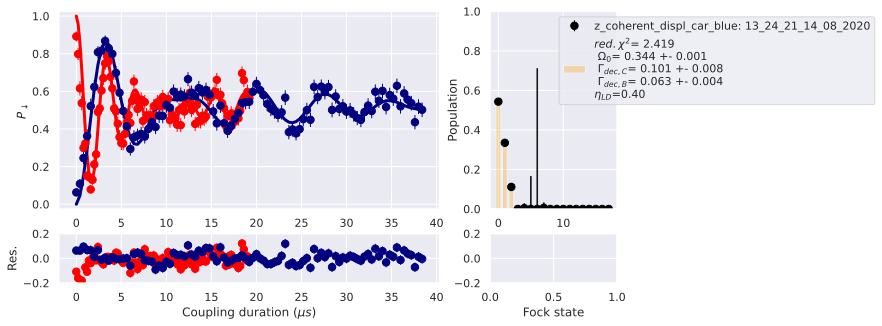

reduced chi square of best fit:  2.4194
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   2 out of   8 | elapsed:  1.6min remaining:  4.8min
[Parallel(n_jobs=-1)]: Done   3 out of   8 | elapsed:  1.6min remaining:  2.7min
[Parallel(n_jobs=-1)]: Done   4 out of   8 | elapsed:  1.6min remaining:  1.6min
[Parallel(n_jobs=-1)]: Done   5 out of   8 | elapsed:  2.0min remaining:  1.2min
[Parallel(n_jobs=-1)]: Done   6 out of   8 | elapsed:  2.0min remaining:   40.2s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.5min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   8 out of   8 | elapsed:  2.5min finished
z_coherent_displ_car_blue: 13_26_53_14_08_2020
first point of carrierflop (should be 1): 0.8728634265860715
first point of blueflop (should be 0): 0.06648580127967646
lamb dicke parameter: 0.3963
yo
[3.41848704e-01 8.36026293e-02 4.63498104e-02 5.31651437e-01
 5.24

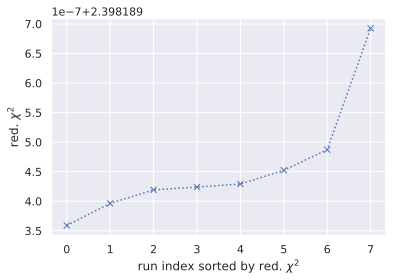

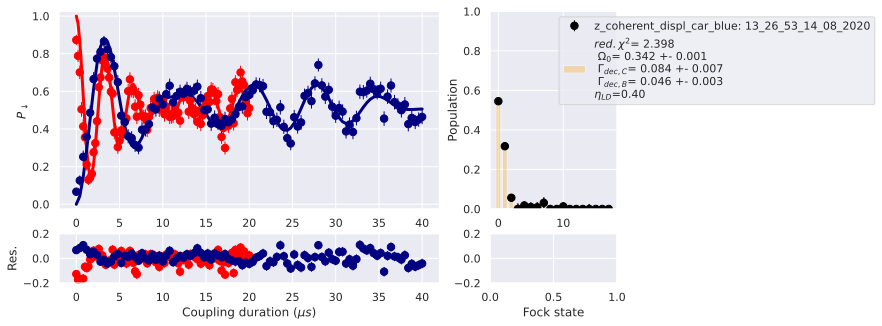

reduced chi square of best fit:  2.3982


In [102]:
n_lhs = 32
nmax = 18

all_res = []
for file in files:
    # make initial values for fock states
    lhs_list = np.transpose(np.array(lhs.sample(nmax, n_lhs)))
    # fit it
    res = Parallel(n_jobs=-1, verbose=51)(delayed(paula.single_fit_sb_carr)([file],2, mode_freq=1.2961, mode_angle=0, Rabi_init=0.342, decc_init=0.07, decb_init=0.042, limc_init=0.5, limb_init=0.5, init_pops=init_lhs, fock=True, nmax=nmax, fix=[0,0,0,0,0]) for init_lhs in lhs_list)

    # make waterfall plot
    chi_list = [r[0][0] for r in res]
    plt.plot(range(n_lhs), sorted(chi_list), 'x:')
    plt.ylabel(r'red. $\chi^2$')
    plt.xlabel(r'run index sorted by red. $\chi^2$')
    plt.plot()

    # get best fit
    idx = np.argmin(chi_list)
    all_res.append(res[idx])

    # get plot of best fit
    paula.single_fit_sb_carr([file],2, mode_freq=1.2961, mode_angle=0, Rabi_init=res[idx][2][0], decc_init=res[idx][2][1], decb_init=res[idx][2][2], limc_init=res[idx][2][3], limb_init=res[idx][2][4], init_pops = res[idx][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0])

    print('reduced chi square of best fit: ', np.round(chi_list[idx],4))

In [106]:
# np.savez('data/2020-08-14_wigner_phi_nice',all_res)

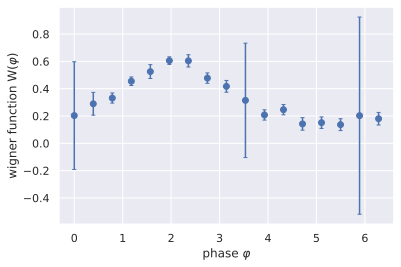

In [105]:
w_list = np.transpose(get_W_from_focks(all_res, fit_fock=1, n_dim=[18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18]))

plt.errorbar(np.linspace(0,2*np.pi,17), w_list[0], w_list[1], fmt='o')
plt.xlabel(r'phase $\varphi$')
plt.ylabel(r'wigner function W($\varphi$)')

plt.show()

[1.13232179 0.15056197 2.08246993 1.01248274]


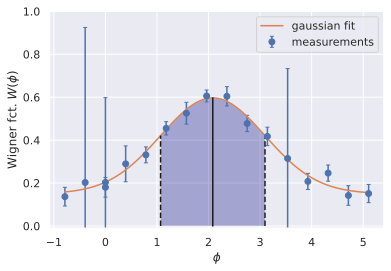

mu = 2.082 , sigma =  1.012


In [188]:
# plot it
def gauß_2pi(x, A, C, mu, sig):
    return(A/(sig*np.sqrt(2*np.pi))*np.exp(-0.5*(x-mu)**2/sig**2) + C)

x = np.linspace(0,2*np.pi,17)

x_new = np.append(x[-3:]-2*np.pi,x[:-3])
w_list_new = np.append(w_list[0][-3:],w_list[0][:-3])
w_err_list_new = np.append(w_list[1][-3:],w_list[1][:-3])

xx = np.linspace(x_new[0], x_new[-1], 100)

from scipy.optimize import curve_fit
params, _ = curve_fit(gauß_2pi,x_new,w_list_new, [0.5, 0, 2, 1])
print(params)

mu, sig = params[2], params[3]

plt.errorbar(x_new,w_list_new, w_err_list_new, fmt='o', label='measurements')
# plt.ylim(-.7,.7)



yy = [gauß_2pi(xxx, *params) for xxx in xx]
plt.plot(xx, yy, label = 'gaussian fit')
plt.plot([mu,mu],[0,gauß_2pi(mu, *params)],'k')
plt.plot([mu+sig,mu+sig],[0,gauß_2pi(mu+sig, *params)],'k--')
plt.plot([mu-sig,mu-sig],[0,gauß_2pi(mu-sig, *params)],'k--')

x_fill = np.linspace(mu-sig, mu+sig, 100)
y_fill = [gauß_2pi(xxx, *params) for xxx in x_fill]
plt.fill_between(x_fill, y_fill, facecolor='Navy', interpolate=True, alpha=.3)

plt.xlabel(r'$\phi$')
plt.ylabel(r'Wigner fct. $ W(\phi)$')
plt.ylim(-0.01,1)
plt.legend(loc='upper right')
# plt.xlabel(r'$|\alpha|$')
# plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.show()

print('mu =', np.round(params[2],3),', sigma = ',  np.round(params[3],3))

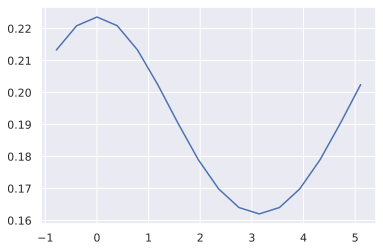

In [183]:
psi = displace(12, np.sqrt(n_alpha)) * thermal_dm(12,0.12) * displace(12, np.sqrt(n_alpha)).dag()
z_sim = n_alpha*np.exp(x_new*1j)
x_sim = np.real(z_sim)
y_sim = np.imag(z_sim)

sim_dat_y = []
for i, phi in enumerate(z_sim):
    sim_dat_y.append(wigner(psi, x_sim[i],y_sim[i])[0,0])
#     sim_dat_pure.append(2*wigner(rho_pure, 2**0.5*a,0)[0,0])

plt.plot(x_new, sim_dat_y)

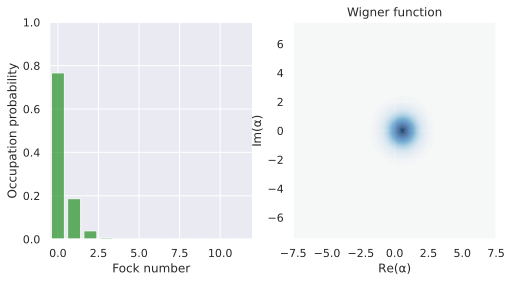

In [213]:
# psi = displace(12, np.sqrt(n_alpha)) * thermal_dm(12,0.12) * displace(12, np.sqrt(n_alpha)).dag()
# psi = squeeze(12, 0.8) * thermal_dm(12,0.12) * squeeze(12, 0.8).dag()
plot_wigner_fock_distribution(psi)
plt.show()

In [30]:
# second try, with t_coh = 1
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/'
fnames = os.listdir(direct)
files = sorted([direct+f for f in fnames])
files = select_files(files, [14,19,00], [15,2,00])
files

17 files


['/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_19_36_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_22_12_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_24_49_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_27_25_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_30_03_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_32_39_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_35_15_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_37_52_14_08_2020.dat',
 '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/14_40_28_14_08_202

z_coherent_displ_car_blue: 14_19_36_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_19_36_14_08_2020.pkl
first point of carrierflop (should be 1): 0.9271145683300187
first point of blueflop (should be 0): 0.0962370188662881
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:00:37 2020
migrad finished at Fri Aug 14 17:02:02 2020


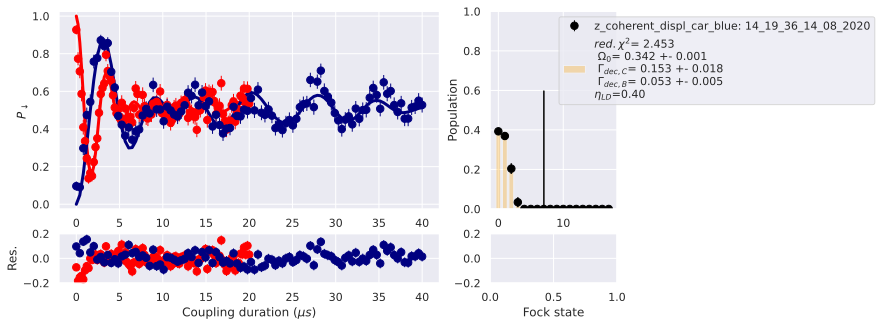

z_coherent_displ_car_blue: 14_22_12_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_22_12_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8827851583644839
first point of blueflop (should be 0): 0.10324478898296918
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:02:03 2020
migrad finished at Fri Aug 14 17:03:40 2020


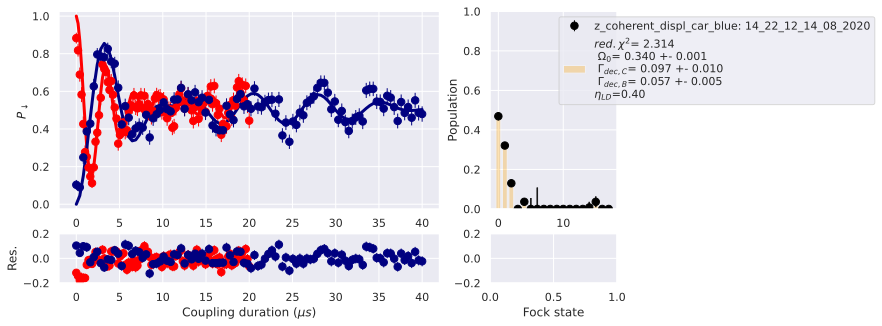

z_coherent_displ_car_blue: 14_24_49_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_24_49_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8563079372475053
first point of blueflop (should be 0): 0.05076657041405547
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:03:41 2020
migrad finished at Fri Aug 14 17:04:51 2020


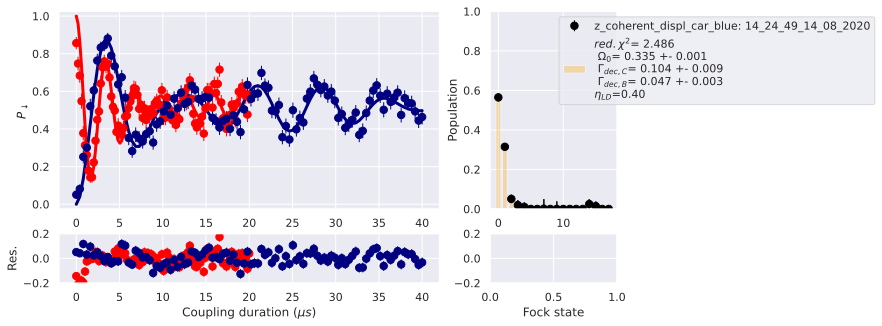

z_coherent_displ_car_blue: 14_27_25_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_27_25_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8789083312405528
first point of blueflop (should be 0): 0.07930851370096809
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:04:52 2020
migrad finished at Fri Aug 14 17:06:21 2020


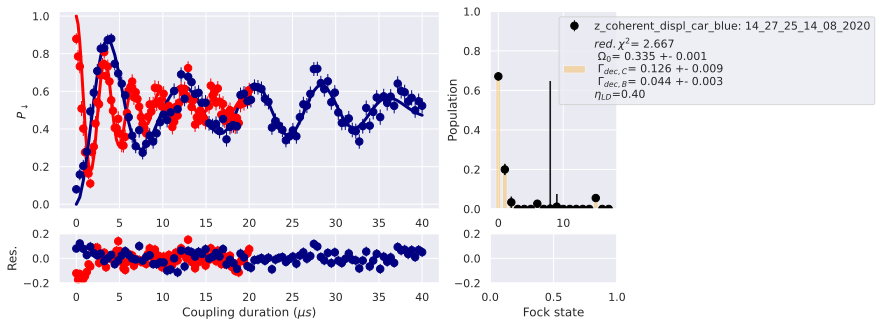

z_coherent_displ_car_blue: 14_30_03_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_30_03_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8650157479368101
first point of blueflop (should be 0): 0.04904518310505063
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:06:22 2020
migrad finished at Fri Aug 14 17:07:56 2020


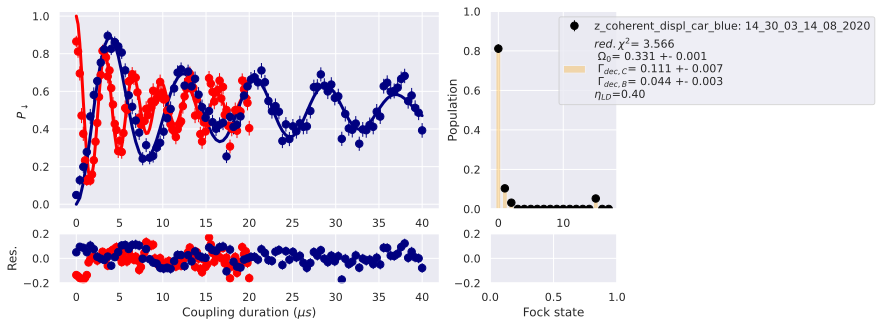

z_coherent_displ_car_blue: 14_32_39_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_32_39_14_08_2020.pkl
first point of carrierflop (should be 1): 0.882984840231098
first point of blueflop (should be 0): 0.07785542708209481
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:07:58 2020
migrad finished at Fri Aug 14 17:10:46 2020


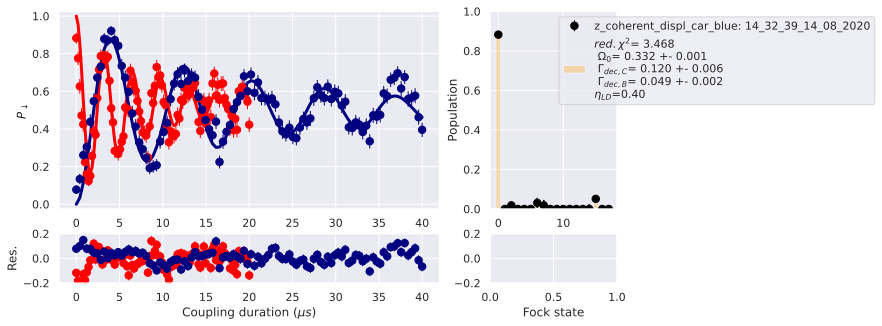

z_coherent_displ_car_blue: 14_35_15_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_35_15_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8726593599980144
first point of blueflop (should be 0): 0.046887755170317735
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:10:47 2020
migrad finished at Fri Aug 14 17:12:08 2020


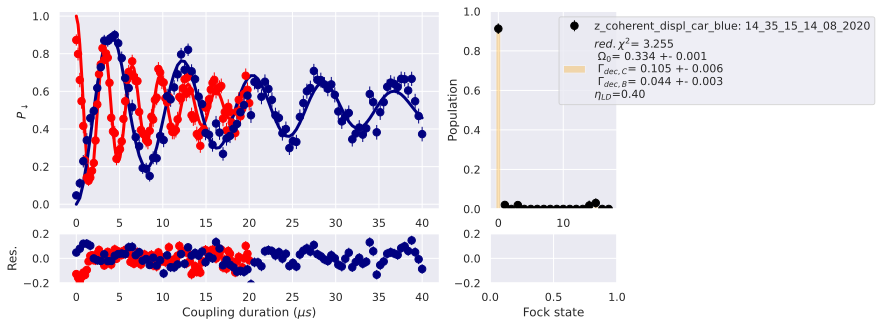

z_coherent_displ_car_blue: 14_37_52_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_37_52_14_08_2020.pkl
first point of carrierflop (should be 1): 0.9250291647187425
first point of blueflop (should be 0): 0.06953218024726349
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:12:09 2020
migrad finished at Fri Aug 14 17:14:19 2020


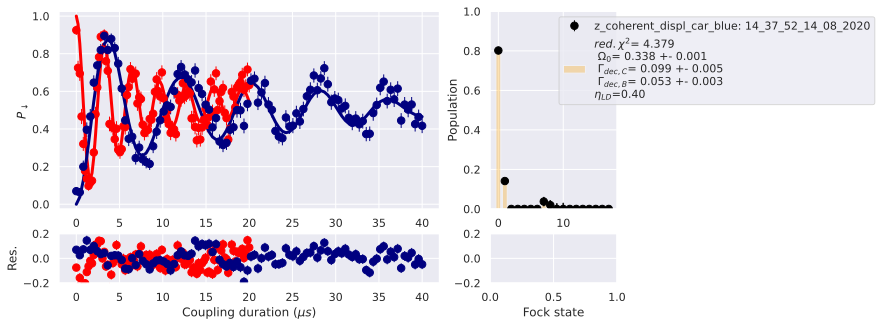

z_coherent_displ_car_blue: 14_40_28_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_40_28_14_08_2020.pkl
first point of carrierflop (should be 1): 0.9071006179091834
first point of blueflop (should be 0): 0.07918791293011168
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:14:21 2020
migrad finished at Fri Aug 14 17:15:51 2020


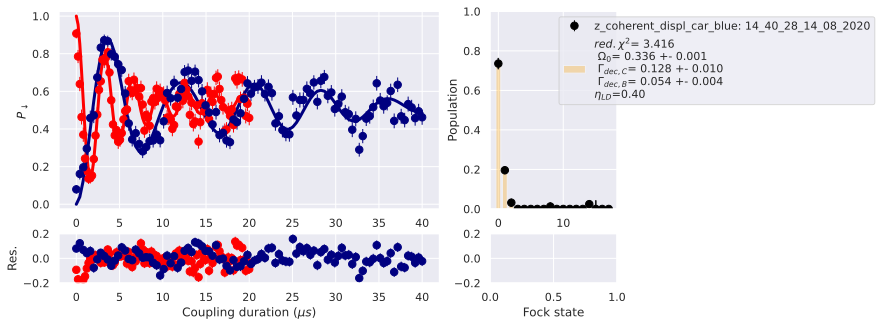

z_coherent_displ_car_blue: 14_43_04_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_43_04_14_08_2020.pkl
first point of carrierflop (should be 1): 0.87980595807051
first point of blueflop (should be 0): 0.03675711089865019
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:15:52 2020
migrad finished at Fri Aug 14 17:17:24 2020


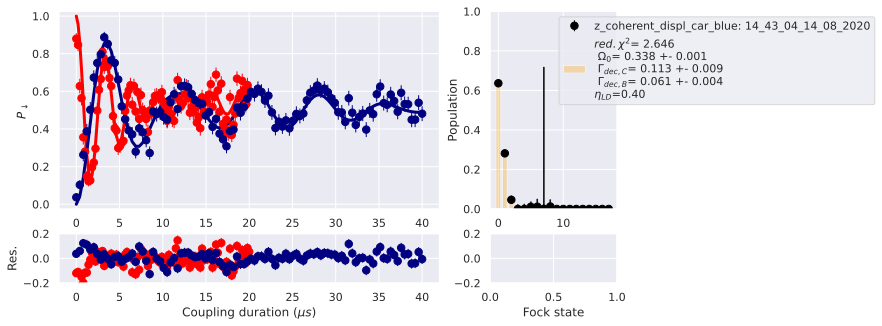

z_coherent_displ_car_blue: 14_45_40_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_45_40_14_08_2020.pkl
first point of carrierflop (should be 1): 0.9041101882040061
first point of blueflop (should be 0): 0.07266049657598728
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:17:25 2020
migrad finished at Fri Aug 14 17:18:42 2020


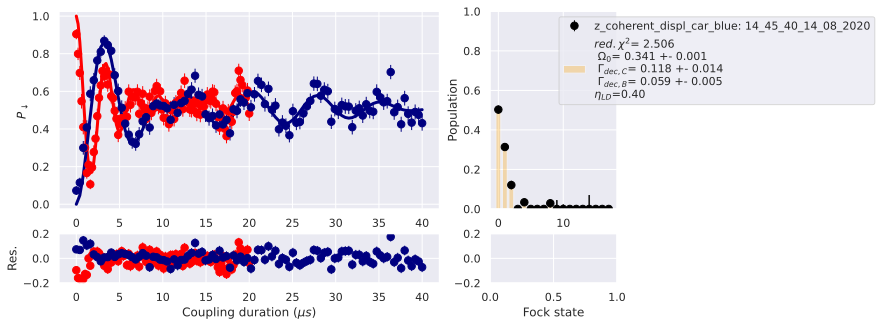

z_coherent_displ_car_blue: 14_48_17_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_48_17_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8963780459645764
first point of blueflop (should be 0): 0.06015732343201302
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:18:43 2020
migrad finished at Fri Aug 14 17:20:07 2020


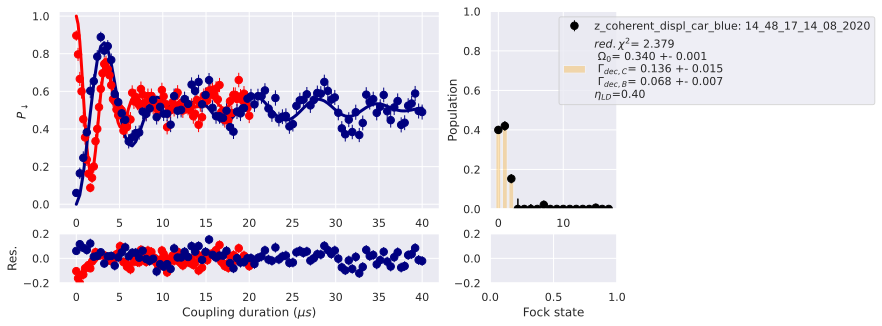

z_coherent_displ_car_blue: 14_50_53_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_50_53_14_08_2020.pkl
first point of carrierflop (should be 1): 0.9091931816771015
first point of blueflop (should be 0): 0.059174396837822274
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:20:08 2020
migrad finished at Fri Aug 14 17:21:14 2020


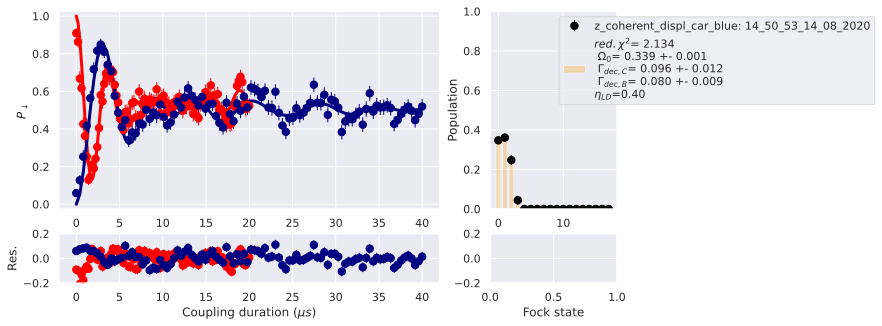

z_coherent_displ_car_blue: 14_53_30_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_53_30_14_08_2020.pkl
first point of carrierflop (should be 1): 0.9504156926483811
first point of blueflop (should be 0): 0.0461971722975934
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:21:15 2020
migrad finished at Fri Aug 14 17:22:50 2020


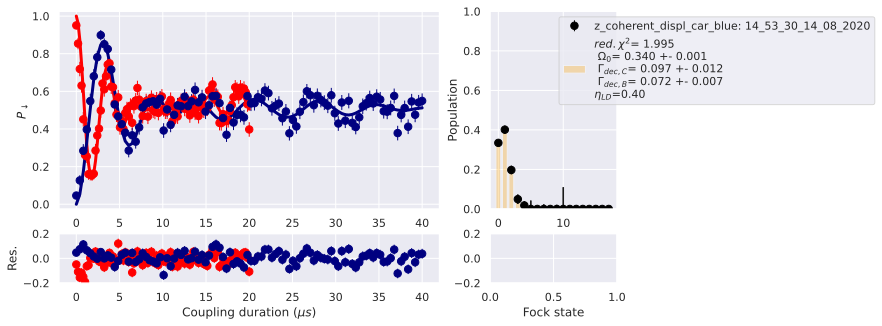

z_coherent_displ_car_blue: 14_56_06_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_56_06_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8804180261334165
first point of blueflop (should be 0): 0.11850478987781626
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:22:51 2020
migrad finished at Fri Aug 14 17:25:21 2020


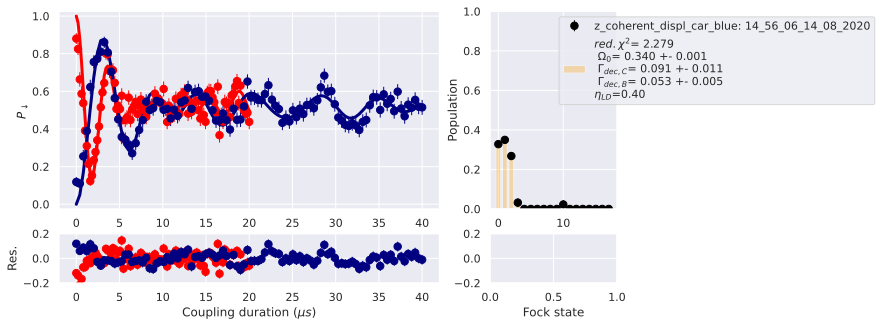

z_coherent_displ_car_blue: 14_58_43_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/14_58_43_14_08_2020.pkl
first point of carrierflop (should be 1): 0.8732647689945854
first point of blueflop (should be 0): 0.08029780824944094
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:25:22 2020
migrad finished at Fri Aug 14 17:26:37 2020


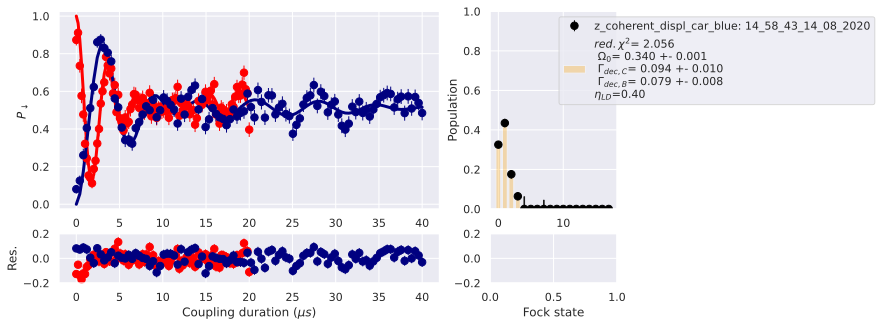

z_coherent_displ_car_blue: 15_01_19_14_08_2020
Save data locally /home/robboss/Documents/FilesForPython/data/15_01_19_14_08_2020.pkl
first point of carrierflop (should be 1): 0.924112263593361
first point of blueflop (should be 0): 0.05955237860590895
lamb dicke parameter: 0.3962
Free parameter count 23
migrad started at Fri Aug 14 17:26:38 2020
migrad finished at Fri Aug 14 17:28:09 2020


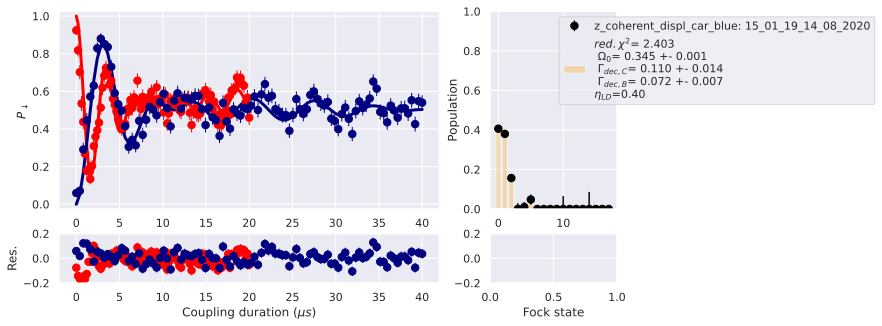

In [190]:
# second try, with t_coh = 1
nmax = 18

all_res_2 = []
for file in files:
    # get plot of best fit
    res = paula.single_fit_sb_carr([file],2, mode_freq=1.2968, mode_angle=0, Rabi_init=0.355, decc_init=0.07, decb_init=0.048, limc_init=0.5, limb_init=0.5, fock=True, nmax=nmax, fix=[0,0,0,0,0])
    all_res_2.append(res)

In [195]:
# np.savez('data/2020-08-14_wigner_phi_double_ex',all_res_2)

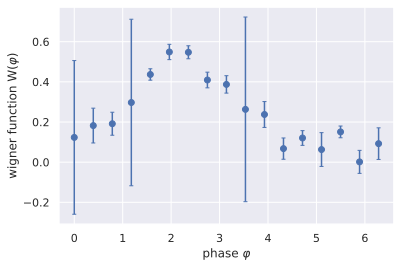

In [191]:
w_list = np.transpose(get_W_from_focks(all_res_2, fit_fock=1, n_dim=[18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18]))

plt.errorbar(np.linspace(0,2*np.pi,17), w_list[0], w_list[1], fmt='o')
plt.xlabel(r'phase $\varphi$')
plt.ylabel(r'wigner function W($\varphi$)')

plt.show()

[1.08809489 0.07778173 2.25128836 0.95171894]


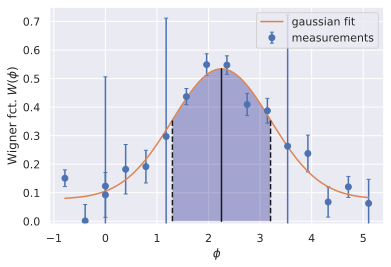

mu = 2.251 , sigma =  0.952


In [194]:
x = np.linspace(0,2*np.pi,17)

x_new = np.append(x[-3:]-2*np.pi,x[:-3])
w_list_new = np.append(w_list[0][-3:],w_list[0][:-3])
w_err_list_new = np.append(w_list[1][-3:],w_list[1][:-3])

xx = np.linspace(x_new[0], x_new[-1], 100)

from scipy.optimize import curve_fit
params, _ = curve_fit(gauß_2pi,x_new,w_list_new, [0.5, 0, 2, 1])
print(params)

mu, sig = params[2], params[3]

plt.errorbar(x_new,w_list_new, w_err_list_new, fmt='o', label='measurements')
# plt.ylim(-.7,.7)



yy = [gauß_2pi(xxx, *params) for xxx in xx]
plt.plot(xx, yy, label = 'gaussian fit')
plt.plot([mu,mu],[0,gauß_2pi(mu, *params)],'k')
plt.plot([mu+sig,mu+sig],[0,gauß_2pi(mu+sig, *params)],'k--')
plt.plot([mu-sig,mu-sig],[0,gauß_2pi(mu-sig, *params)],'k--')

x_fill = np.linspace(mu-sig, mu+sig, 100)
y_fill = [gauß_2pi(xxx, *params) for xxx in x_fill]
plt.fill_between(x_fill, y_fill, facecolor='Navy', interpolate=True, alpha=.3)

plt.xlabel(r'$\phi$')
plt.ylabel(r'Wigner fct. $ W(\phi)$')
plt.ylim(-0.01,0.75)
plt.legend(loc='upper right')
# plt.xlabel(r'$|\alpha|$')
# plt.ylabel(r'Wigner fct. $ W(|\alpha|, \phi=0)$')
plt.show()

print('mu =', np.round(params[2],3),', sigma = ',  np.round(params[3],3))

In [197]:
# t_prep = 0.5, now varie
direct = '/mnt/paula/Results/tiamo4.sync/2020/08_August/14/OC_Axial/z_coherent_displ_car_blue/'
fnames = os.listdir(direct)
files = sorted([direct+f for f in fnames])
files = select_files(files, [16,8,00], [16,36,00])

11 files


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.6min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  3

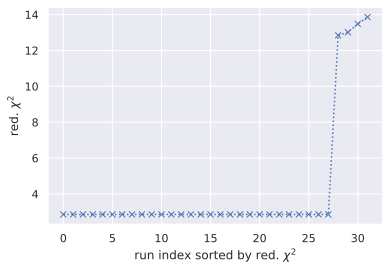

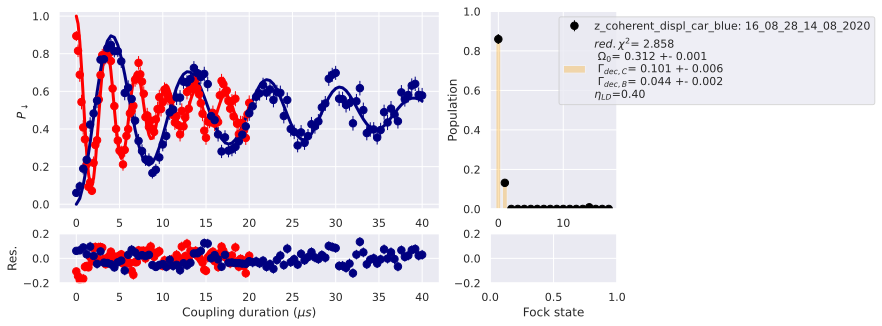

reduced chi square of best fit:  2.8583
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   47.2s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.3min
[Parallel(n_jobs

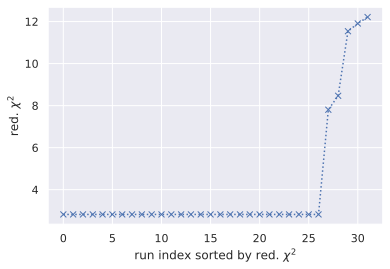

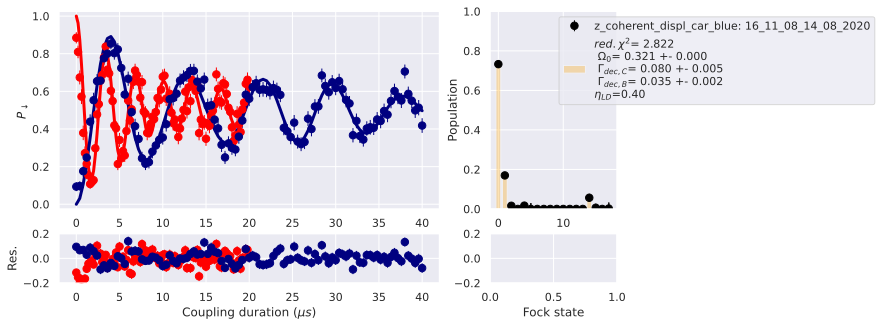

reduced chi square of best fit:  2.8218
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.5min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.4min
[Parallel(n_jobs

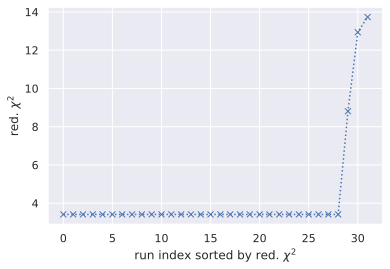

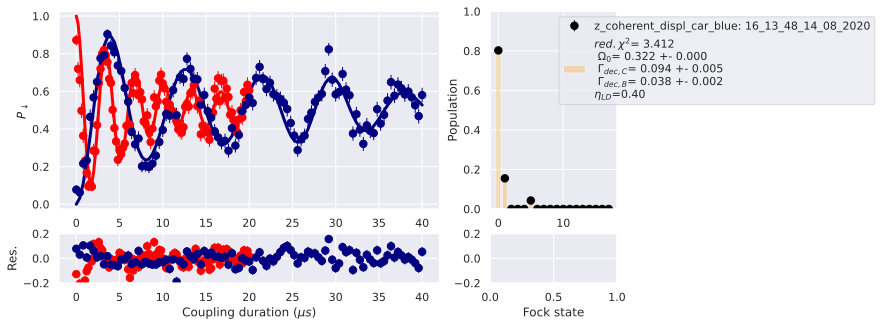

reduced chi square of best fit:  3.4122
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   45.6s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.5min
[Parallel(n_jobs

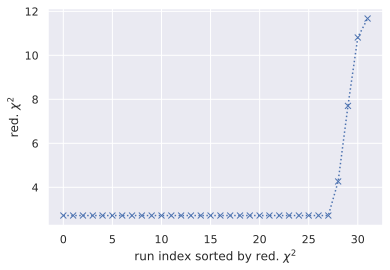

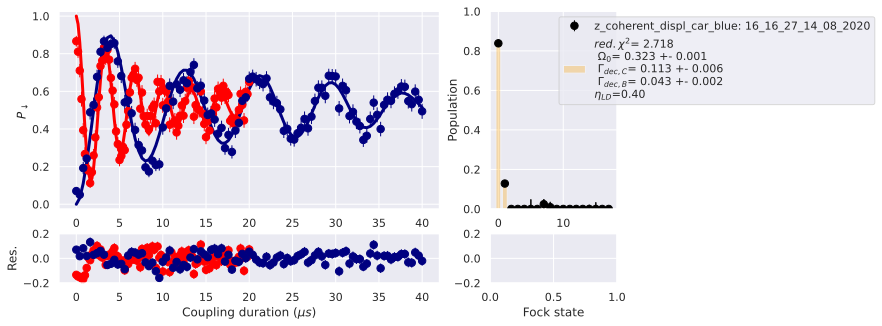

reduced chi square of best fit:  2.7178
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  4.4min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  4.5min
[Parallel(n_jobs

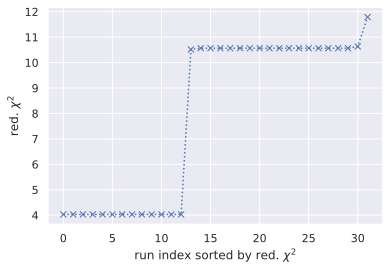

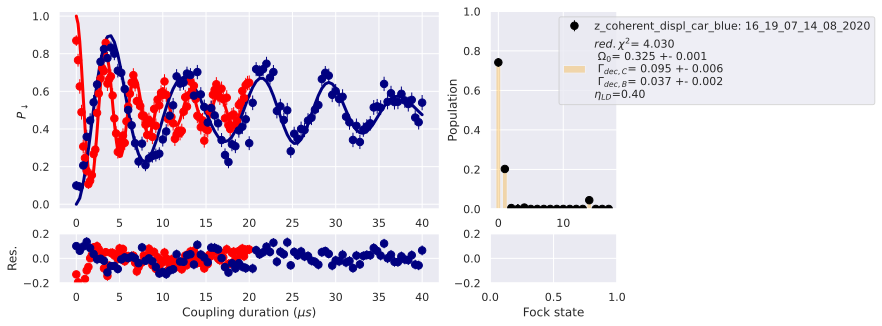

reduced chi square of best fit:  4.0295
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.6min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.2min
[Parallel(n_jobs

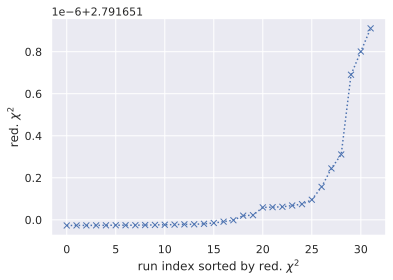

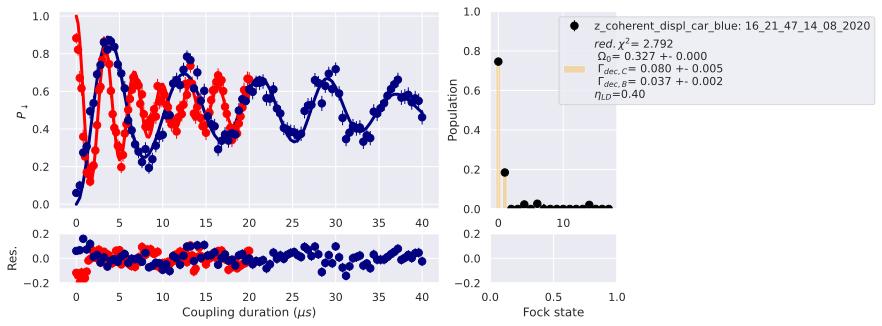

reduced chi square of best fit:  2.7917
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.8min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.9min
[Parallel(n_jobs

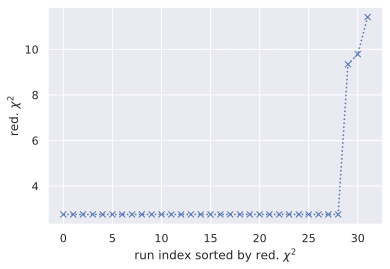

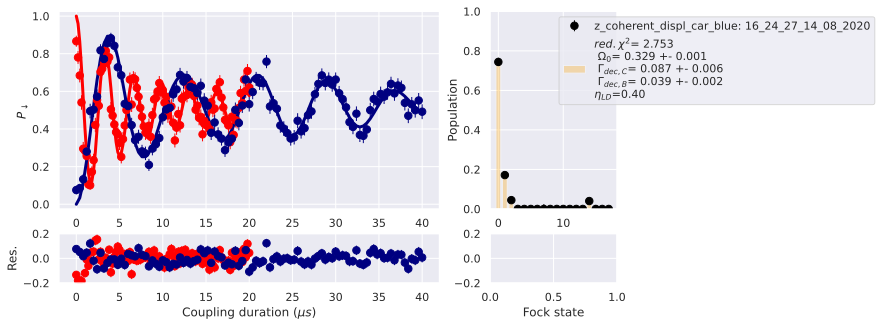

reduced chi square of best fit:  2.7532
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  4.1min
[Parallel(n_jobs

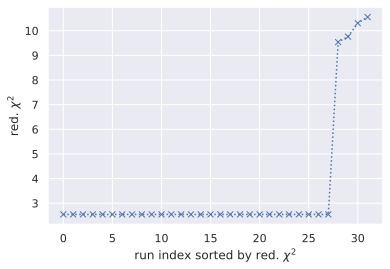

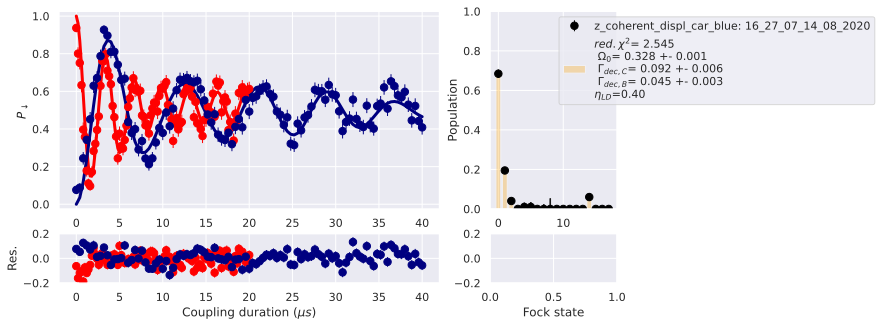

reduced chi square of best fit:  2.5454
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   57.8s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.8min
[Parallel(n_jobs

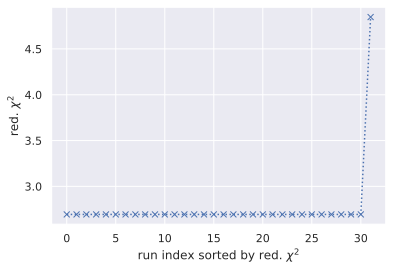

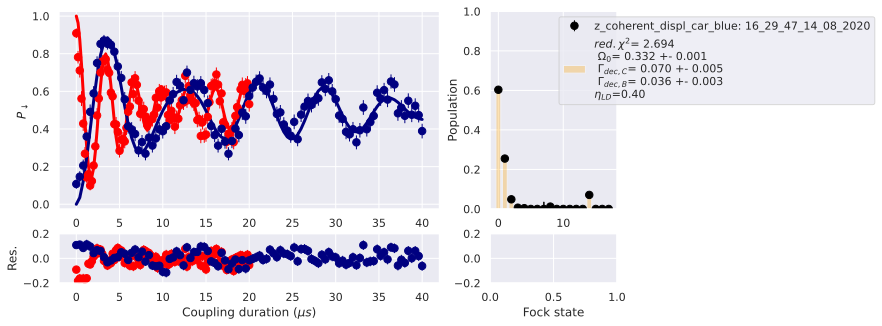

reduced chi square of best fit:  2.6936
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  4.0min
[Parallel(n_jobs

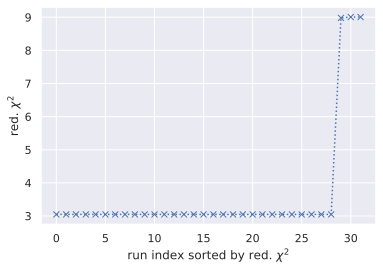

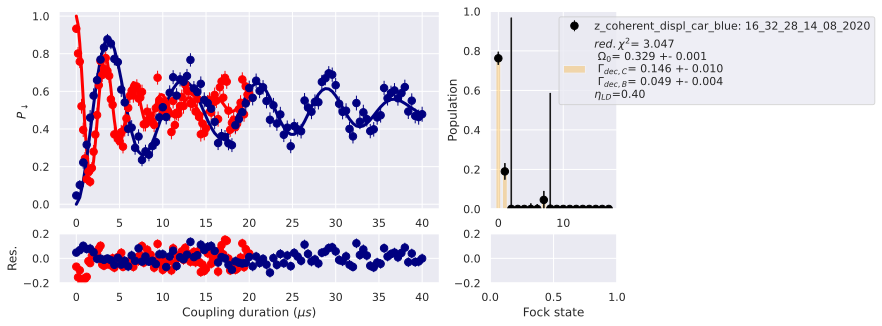

reduced chi square of best fit:  3.047
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  2.1min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.6min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  4.1min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  4.2min
[Parallel(n_jobs=

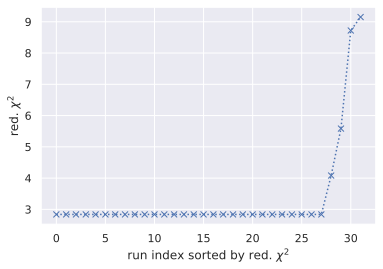

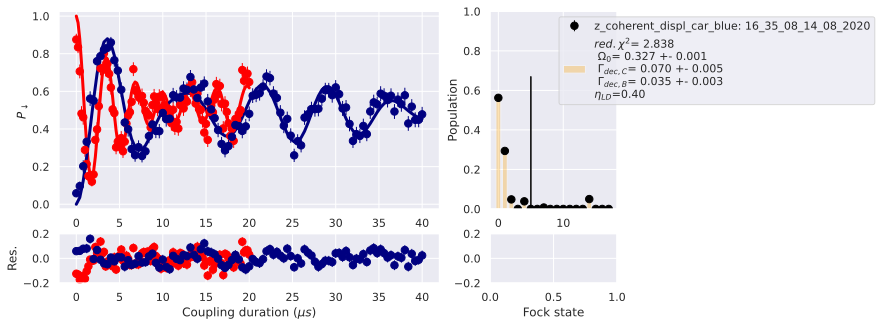

reduced chi square of best fit:  2.8378


In [199]:
n_lhs = 32
nmax = 18

all_res3 = []
for file in files:
    # make initial values for fock states
    lhs_list = np.transpose(np.array(lhs.sample(nmax, n_lhs)))
    # fit it
    res = Parallel(n_jobs=-1, verbose=51)(delayed(paula.single_fit_sb_carr)([file],2, mode_freq=1.2965, mode_angle=0, Rabi_init=0.326, decc_init=0.07, decb_init=0.034, limc_init=0.5, limb_init=0.5, init_pops=init_lhs, fock=True, nmax=nmax, fix=[0,0,0,0,0]) for init_lhs in lhs_list)

    # make waterfall plot
    chi_list = [r[0][0] for r in res]
    plt.plot(range(n_lhs), sorted(chi_list), 'x:')
    plt.ylabel(r'red. $\chi^2$')
    plt.xlabel(r'run index sorted by red. $\chi^2$')
    plt.plot()

    # get best fit
    idx = np.argmin(chi_list)
    all_res3.append(res[idx])

    # get plot of best fit
    paula.single_fit_sb_carr([file],2, mode_freq=1.2965, mode_angle=0, Rabi_init=res[idx][2][0], decc_init=res[idx][2][1], decb_init=res[idx][2][2], limc_init=res[idx][2][3], limb_init=res[idx][2][4], init_pops = res[idx][2][-1], fock=True, nmax=nmax, fix=[0,0,0,0,0])

    print('reduced chi square of best fit: ', np.round(chi_list[idx],4))

In [24]:
# np.savez('data/2020-08-14_wigner_r',all_res3)
file_all_res3 = np.load('data/2020-08-14_wigner_r.npz',allow_pickle=True)
# all_res3 = file_all_res3['arr0']

all_res3 = file_all_res3['arr_0']

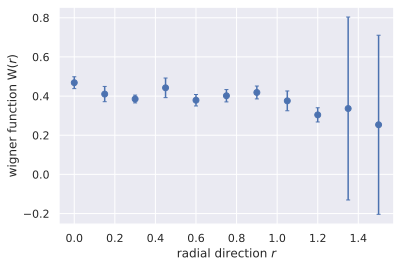

In [25]:
w_list = np.transpose(get_W_from_focks(all_res3, fit_fock=1, n_dim=[18,18,18,18,18,18,18,18,18,18,18]))

plt.errorbar(np.linspace(0,1.5,11), w_list[0], w_list[1], fmt='o')
plt.xlabel(r'radial direction $r$')
plt.ylabel(r'wigner function W($r$)')

plt.show()

In [28]:
x = np.linspace(0,2*np.pi,17)

x_new = np.append(x[-3:]-2*np.pi,x[:-3])
x_new

array([-0.78539816, -0.39269908,  0.        ,  0.        ,  0.39269908,
        0.78539816,  1.17809725,  1.57079633,  1.96349541,  2.35619449,
        2.74889357,  3.14159265,  3.53429174,  3.92699082,  4.3196899 ,
        4.71238898,  5.10508806])